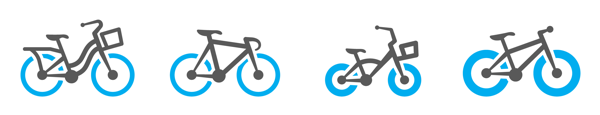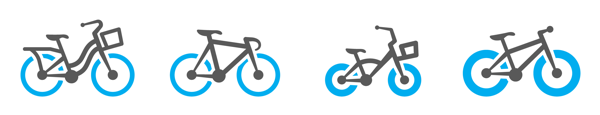

# Final Project : Predicting Bike sharing demand (Per Houre)
* `Project Name :` Predicting Bike sharing demand
* `Employee Name :` Osama SAAD
* `Title :` Infor ERP (EAM ) Key Business User | DMST & Assets Control Supervisor @Ibnsina Pharma
* `Group :` CDSP - DSOFF171222m SAT FD 10AM:4PM - Mohandessin
* `Instructor :` Eng. Ahmed Mostafa

# 🚩 Predicting Bike sharing demand
* Source : https://www.kaggle.com/datasets/lakshmi25npathi/bike-sharing-dataset
* Main Source : https://archive.ics.uci.edu/dataset/275/bike+sharing+dataset

* Bike sharing systems are new generation of traditional bike rentals where whole process from membership, rental and return back has become automatic. Through these systems, user is able to easily rent a bike from a particular position and return back at another position. Currently, there are about over 500 bike-sharing programs around the world which is composed of over 500 thousands bicycles. Today, there exists great interest in these systems due to their important role in traffic, environmental and health issues.
* Apart from interesting real world applications of bike sharing systems, the characteristics of data being generated by these systems make them attractive for the research. Opposed to other transport services such as bus or subway, the duration of travel, departure and arrival position is explicitly recorded in these systems. This feature turns bike sharing system into a virtual sensor network that can be used for sensing mobility in the city. Hence, it is expected that most of important events in the city could be detected via monitoring these data.

## ✅ Import Libraries & explore data

	- instant: record index
	- dteday : date
	- season : season (1:springer, 2:summer, 3:fall, 4:winter)
	- yr : year (0: 2011, 1:2012)
	- mnth : month ( 1 to 12)
	- hr : hour (0 to 23)
	- holiday : weather day is holiday or not (extracted from http://dchr.dc.gov/page/holiday-schedule)
	- weekday : day of the week
	- workingday : if day is neither weekend nor holiday is 1, otherwise is 0.
	+ weathersit :
		- 1: Clear, Few clouds, Partly cloudy, Partly cloudy
		- 2: Mist + Cloudy, Mist + Broken clouds, Mist + Few clouds, Mist
		- 3: Light Snow, Light Rain + Thunderstorm + Scattered clouds, Light Rain + Scattered clouds
		- 4: Heavy Rain + Ice Pallets + Thunderstorm + Mist, Snow + Fog
	- temp : Normalized temperature in Celsius. The values are divided to 41 (max)
	- atemp: Normalized feeling temperature in Celsius. The values are divided to 50 (max)
	- hum: Normalized humidity. The values are divided to 100 (max)
	- windspeed: Normalized wind speed. The values are divided to 67 (max)
	- casual: count of casual users
	- registered: count of registered users
	- cnt: count of total rental bikes including both casual and registered

In [201]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
pd.options.display.float_format = '{:,.2f}'.format

In [202]:
if 'google.colab' in str(get_ipython()):
    # Running in Google Colab
    from google.colab import drive
    drive.mount('/content/drive')
    import pandas as pd
    !pip install pandas --upgrade
    print(pd.__version__)
    file = '/content/drive/Othercomputers/My Laptop/00-Projects/Sessions/Final Project/ML Bike Sharing Dataset Per Houres/hour.csv'
else:
    # Running locally
    file = 'D:/Data Science/00-Projects/Sessions/Final Project/ML Bike Sharing Dataset Per Houres/hour.csv'

In [203]:
old_df = pd.read_csv(file).drop('instant', axis=1)
df = pd.read_csv(file).drop('instant', axis=1)

In [204]:
df.sample(10)

,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
4392,2011-07-06,3,0,7,22,0,3,1,1,0.70,0.67,0.79,0.19,30,156,186
11929,2012-05-17,2,1,5,6,0,4,1,1,0.54,0.52,0.73,0.36,10,149,159
16614,2012-11-30,4,1,11,1,0,5,1,1,0.24,0.26,0.70,0.09,2,17,19
13118,2012-07-05,3,1,7,19,0,4,1,2,0.88,0.80,0.39,0.25,128,375,503
15959,2012-11-02,4,1,11,16,0,5,1,1,0.38,0.39,0.40,0.33,48,373,421
7362,2011-11-08,4,0,11,9,0,2,1,1,0.36,0.38,0.87,0.00,14,177,191
16852,2012-12-09,4,1,12,23,0,0,0,3,0.36,0.36,1.00,0.09,3,48,51
13140,2012-07-06,3,1,7,17,0,5,1,1,0.92,0.82,0.29,0.00,90,486,576
7403,2011-11-10,4,0,11,2,0,4,1,2,0.38,0.39,0.94,0.00,0,5,5
12093,2012-05-24,2,1,5,2,0,4,1,1,0.60,0.55,0.88,0.00,1,15,16


In [205]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
season,"17,379.00",2.50,1.11,1.00,2.00,3.00,3.00,4.00
yr,"17,379.00",0.50,0.50,0.00,0.00,1.00,1.00,1.00
mnth,"17,379.00",6.54,3.44,1.00,4.00,7.00,10.00,12.00
hr,"17,379.00",11.55,6.91,0.00,6.00,12.00,18.00,23.00
holiday,"17,379.00",0.03,0.17,0.00,0.00,0.00,0.00,1.00
weekday,"17,379.00",3.00,2.01,0.00,1.00,3.00,5.00,6.00
workingday,"17,379.00",0.68,0.47,0.00,0.00,1.00,1.00,1.00
weathersit,"17,379.00",1.43,0.64,1.00,1.00,1.00,2.00,4.00
temp,"17,379.00",0.50,0.19,0.02,0.34,0.50,0.66,1.00
atemp,"17,379.00",0.48,0.17,0.00,0.33,0.48,0.62,1.00


In [206]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17379 entries, 0 to 17378
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   dteday      17379 non-null  object 
 1   season      17379 non-null  int64  
 2   yr          17379 non-null  int64  
 3   mnth        17379 non-null  int64  
 4   hr          17379 non-null  int64  
 5   holiday     17379 non-null  int64  
 6   weekday     17379 non-null  int64  
 7   workingday  17379 non-null  int64  
 8   weathersit  17379 non-null  int64  
 9   temp        17379 non-null  float64
 10  atemp       17379 non-null  float64
 11  hum         17379 non-null  float64
 12  windspeed   17379 non-null  float64
 13  casual      17379 non-null  int64  
 14  registered  17379 non-null  int64  
 15  cnt         17379 non-null  int64  
dtypes: float64(4), int64(11), object(1)
memory usage: 2.1+ MB


In [207]:
df.registered.sum()

2672662

In [208]:
df.casual.sum()

620017

In [209]:
df.cnt.sum()

3292679

## ✅ Data Cleaning and Feature Enginerring

* 1. Date Conversion
* 2. SeasonMapp
* 3. Time Convesion
* 4. Waether Mapp
* 5. Temp reverse :
( temp * 41 )
( atemp * 50 )
( hum * 100 )
( windspeed * 67 )

In [210]:
df.head(2)

,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.29,0.81,0.00,3,13,16
1,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.27,0.80,0.00,8,32,40


In [211]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17379 entries, 0 to 17378
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   dteday      17379 non-null  object 
 1   season      17379 non-null  int64  
 2   yr          17379 non-null  int64  
 3   mnth        17379 non-null  int64  
 4   hr          17379 non-null  int64  
 5   holiday     17379 non-null  int64  
 6   weekday     17379 non-null  int64  
 7   workingday  17379 non-null  int64  
 8   weathersit  17379 non-null  int64  
 9   temp        17379 non-null  float64
 10  atemp       17379 non-null  float64
 11  hum         17379 non-null  float64
 12  windspeed   17379 non-null  float64
 13  casual      17379 non-null  int64  
 14  registered  17379 non-null  int64  
 15  cnt         17379 non-null  int64  
dtypes: float64(4), int64(11), object(1)
memory usage: 2.1+ MB


In [212]:
df.duplicated().sum()

0

In [213]:
df.isnull().sum()

dteday        0
season        0
yr            0
mnth          0
hr            0
holiday       0
weekday       0
workingday    0
weathersit    0
temp          0
atemp         0
hum           0
windspeed     0
casual        0
registered    0
cnt           0
dtype: int64

In [214]:
# Date Conversion
df.dteday = pd.to_datetime(df.dteday , errors = 'coerce')
df['yr'] = pd.to_datetime(df.dteday , errors = 'coerce').dt.year
df.yr = df.yr.astype(int)

# SeasonMapp
SeasonMapp = {1:'01_springer', 2:'02_summer', 3:'03_fall', 4:'04_winter'}
df.season = df.season.map(SeasonMapp)

# Time Convesion
def time(x):
    if x in range(0,6):
        return '01_early morning'
    elif x in range(6,12):
        return '02_morning'
    elif x in range(12,16):
        return '03_afternoon'
    elif x in range(16,23):
        return '04_evening'
    else:
        return '05_night'

# Apply Time Period Function
df['time_preiod'] = df.hr.apply(time)

# Define Year-Month for EDA
df['yr_mnth'] = pd.to_datetime(df.dteday).dt.to_period('M')
df['yr_mnth'] = df['yr_mnth'].astype(str)

# Waether Mapp
weather_map = {1:'Clear' , 2:'Mist' , 3:'Light Snow' , 4:'Heavy Rain'}
df.weathersit = df.weathersit.map(weather_map)

# Temp reverse
df.temp = df.temp.apply(lambda x:round(x*41,2))
df.atemp = df.atemp.apply(lambda x:round(x*50,2))
df.hum = df.hum.apply(lambda x:round(x*100,2))
df.windspeed = df.windspeed.apply(lambda x:round(x*67,2))

In [215]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17379 entries, 0 to 17378
Data columns (total 18 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   dteday       17379 non-null  datetime64[ns]
 1   season       17379 non-null  object        
 2   yr           17379 non-null  int32         
 3   mnth         17379 non-null  int64         
 4   hr           17379 non-null  int64         
 5   holiday      17379 non-null  int64         
 6   weekday      17379 non-null  int64         
 7   workingday   17379 non-null  int64         
 8   weathersit   17379 non-null  object        
 9   temp         17379 non-null  float64       
 10  atemp        17379 non-null  float64       
 11  hum          17379 non-null  float64       
 12  windspeed    17379 non-null  float64       
 13  casual       17379 non-null  int64         
 14  registered   17379 non-null  int64         
 15  cnt          17379 non-null  int64         
 16  time

In [216]:
# Define Finction for Crosstab visualization 
def HeatMapp(data , title , xlabel , ylabel):
    plt.figure(figsize=(12, 8))
    sns.heatmap( data , annot=True, fmt='g', cmap="YlGnBu")
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    return plt.show()

In [217]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17379 entries, 0 to 17378
Data columns (total 18 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   dteday       17379 non-null  datetime64[ns]
 1   season       17379 non-null  object        
 2   yr           17379 non-null  int32         
 3   mnth         17379 non-null  int64         
 4   hr           17379 non-null  int64         
 5   holiday      17379 non-null  int64         
 6   weekday      17379 non-null  int64         
 7   workingday   17379 non-null  int64         
 8   weathersit   17379 non-null  object        
 9   temp         17379 non-null  float64       
 10  atemp        17379 non-null  float64       
 11  hum          17379 non-null  float64       
 12  windspeed    17379 non-null  float64       
 13  casual       17379 non-null  int64         
 14  registered   17379 non-null  int64         
 15  cnt          17379 non-null  int64         
 16  time

In [218]:
# Review season Data as QA
pd.crosstab([df.yr_mnth],df.season,values=df.cnt,aggfunc='sum').replace(np.nan , '')

season,01_springer,02_summer,03_fall,04_winter
yr_mnth,,,,
2011-01,"38,189.00",,,
2011-02,"48,215.00",,,
2011-03,"41,206.00","22,839.00",,
2011-04,,"94,870.00",,
2011-05,,"135,821.00",,
2011-06,,"93,786.00","49,726.00",
2011-07,,,"141,341.00",
2011-08,,,"136,691.00",
2011-09,,,"91,892.00","35,526.00"


In [219]:
# Check output of time_preiod
df.time_preiod.value_counts(normalize=True).sort_index()

time_preiod
01_early morning   0.25
02_morning         0.25
03_afternoon       0.17
04_evening         0.29
05_night           0.04
Name: proportion, dtype: float64

In [220]:
# Check output of weathersit
df.weathersit.value_counts(normalize=True).sort_index()

weathersit
Clear        0.66
Heavy Rain   0.00
Light Snow   0.08
Mist         0.26
Name: proportion, dtype: float64

In [221]:
# Explore count of transaction and the sum of casual,registred,cnt rents per time period
for i in df.yr.unique().tolist():
    msk = df[df.yr == i].groupby(['time_preiod']).agg({'time_preiod':'count','casual':'sum','registered':'sum','cnt':'sum'})
    print(i)
    display(msk)
    print("")

2011


,time_preiod,casual,registered,cnt
time_preiod,,,,
01_early morning,2105,8877,33297,42174
02_morning,2176,50625,286168,336793
03_afternoon,1456,81118,192491,273609
04_evening,2545,101639,463772,565411
05_night,363,4993,20123,25116



2012


,time_preiod,casual,registered,cnt
time_preiod,,,,
01_early morning,2171,10398,53937,64335
02_morning,2184,75723,494803,570526
03_afternoon,1459,131008,323517,454525
04_evening,2555,149564,771801,921365
05_night,365,6072,32753,38825


In [222]:
# Explore count of transaction and the sum of casual,registred,cnt rents per month
for i in df.yr.unique().tolist():
    msk = df[df.yr == 2011].groupby(['mnth']).agg({'mnth':'count','casual':'sum','registered':'sum','cnt':'sum'})
    print(i)
    display(msk)
    print("")

2011


,mnth,casual,registered,cnt
mnth,,,,
1,688,3073,35116,38189
2,649,6242,41973,48215
3,730,12826,51219,64045
4,719,22346,72524,94870
5,744,31050,104771,135821
6,720,30612,112900,143512
7,744,36452,104889,141341
8,731,28842,107849,136691
9,717,26545,100873,127418



2012


,mnth,casual,registered,cnt
mnth,,,,
1,688,3073,35116,38189
2,649,6242,41973,48215
3,730,12826,51219,64045
4,719,22346,72524,94870
5,744,31050,104771,135821
6,720,30612,112900,143512
7,744,36452,104889,141341
8,731,28842,107849,136691
9,717,26545,100873,127418


In [223]:
df.head(1)

,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,time_preiod,yr_mnth
0,2011-01-01,01_springer,2011,1,0,0,6,0,Clear,9.84,14.39,81.00,0.00,3,13,16,01_early morning,2011-01


In [224]:
df.weathersit.value_counts().sort_index()

weathersit
Clear         11413
Heavy Rain        3
Light Snow     1419
Mist           4544
Name: count, dtype: int64

In [225]:
df.select_dtypes(include='number').quantile([0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1])

,yr,mnth,hr,holiday,weekday,workingday,temp,atemp,hum,windspeed,casual,registered,cnt
0.00,"2,011.00",1.00,0.00,0.00,0.00,0.00,0.82,0.00,0.00,0.00,0.00,0.00,1.00
0.10,"2,011.00",2.00,2.00,0.00,0.00,0.00,9.84,12.12,37.00,0.00,1.00,7.00,9.00
0.20,"2,011.00",3.00,4.00,0.00,1.00,0.00,12.30,15.15,44.00,6.00,3.00,22.00,27.00
0.30,"2,011.00",4.00,7.00,0.00,2.00,0.00,14.76,18.18,51.00,7.00,5.00,49.00,58.00
0.40,"2,011.00",5.00,9.00,0.00,2.00,1.00,17.22,21.21,56.20,9.00,10.00,83.00,98.00
0.50,"2,012.00",7.00,12.00,0.00,3.00,1.00,20.50,24.24,63.00,13.00,17.00,115.00,142.00
0.60,"2,012.00",8.00,14.00,0.00,4.00,1.00,22.96,26.52,69.00,15.00,26.00,152.00,189.00
0.70,"2,012.00",9.00,16.00,0.00,4.00,1.00,25.42,30.30,75.00,17.00,39.00,193.00,244.00
0.80,"2,012.00",10.00,19.00,0.00,5.00,1.00,27.88,31.82,82.00,19.00,59.00,249.00,321.00
0.90,"2,012.00",11.00,21.00,0.00,6.00,1.00,30.34,34.85,88.00,24.00,92.00,354.00,451.20


In [226]:
df[df.registered > 800]

,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,time_preiod,yr_mnth
14220,2012-08-20,03_fall,2012,8,17,0,1,1,Clear,28.70,32.57,58.00,19.00,83,810,893,04_evening,2012-08
14293,2012-08-23,03_fall,2012,8,18,0,4,1,Clear,30.34,33.34,48.00,15.00,130,811,941,04_evening,2012-08
14725,2012-09-10,03_fall,2012,9,18,0,1,1,Clear,25.42,31.06,35.00,20.00,111,857,968,04_evening,2012-09
14748,2012-09-11,03_fall,2012,9,17,0,2,1,Clear,28.70,31.82,28.00,0.00,168,802,970,04_evening,2012-09
14772,2012-09-12,03_fall,2012,9,17,0,3,1,Clear,28.70,31.82,41.00,20.00,114,811,925,04_evening,2012-09
14773,2012-09-12,03_fall,2012,9,18,0,3,1,Clear,27.06,31.06,44.00,17.00,91,886,977,04_evening,2012-09
14940,2012-09-19,03_fall,2012,9,17,0,3,1,Clear,24.60,31.06,38.00,15.00,74,812,886,04_evening,2012-09
14941,2012-09-19,03_fall,2012,9,18,0,3,1,Clear,23.78,27.27,40.00,19.00,85,807,892,04_evening,2012-09
14964,2012-09-20,03_fall,2012,9,17,0,4,1,Clear,26.24,31.06,50.00,15.00,91,885,976,04_evening,2012-09
15060,2012-09-24,04_winter,2012,9,17,0,1,1,Clear,23.78,27.27,30.00,0.00,89,809,898,04_evening,2012-09


## ✅ EDA

In [227]:
msk = df.groupby(['season','yr','weathersit'])[['temp','atemp','windspeed','casual','registered','cnt']].mean().reset_index()
msk

,season,yr,weathersit,temp,atemp,windspeed,casual,registered,cnt
0,01_springer,2011,Clear,11.02,13.47,15.35,12.03,64.72,76.75
1,01_springer,2011,Heavy Rain,9.02,9.85,22.00,1.00,35.00,36.00
2,01_springer,2011,Light Snow,12.03,14.78,14.70,2.69,35.51,38.20
3,01_springer,2011,Mist,11.65,14.42,12.36,9.00,64.61,73.61
4,01_springer,2012,Clear,13.46,16.15,15.32,21.12,144.09,165.21
5,01_springer,2012,Heavy Rain,6.97,9.09,9.50,3.50,90.00,93.50
6,01_springer,2012,Light Snow,12.38,15.07,12.84,4.77,72.73,77.51
7,01_springer,2012,Mist,12.87,15.65,12.80,15.37,115.97,131.34
8,02_summer,2011,Clear,23.02,26.75,13.41,39.92,135.36,175.29
9,02_summer,2011,Light Snow,18.12,21.18,16.01,18.26,85.60,103.86


### 🟢 Univariate Analysis

* Rental Count in `2011` is equal `2012` (50.3% vs 49.7%)
* Percentage of Rental count is Fairly similar in `months` , `weekdays` and `seasons` too
* 65% of rentals in `Clear Weathers` then 26% in `Mist`
* 97% of rentals out of `Holidays` days
* 68% of rentals in `working` days
* 29% of rentals in `“Evening”` Periods, and only 4% in `night`

In [228]:
df.head(1)

,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,time_preiod,yr_mnth
0,2011-01-01,01_springer,2011,1,0,0,6,0,Clear,9.84,14.39,81.00,0.00,3,13,16,01_early morning,2011-01


In [229]:
Totals = {'name':['casual' , 'registered' , 'cnt'],
    '2011':[df[(df.yr == 2011) & (df.casual != 0)].casual.count(), 
            df[(df.yr == 2011) & (df.registered != 0)].registered.count(),
            df[(df.yr == 2011) & (df.cnt != 0)].cnt.count() ] ,
    '2012':[df[(df.yr == 2012) & (df.casual != 0)].casual.count(), 
            df[(df.yr == 2012) & (df.registered != 0)].registered.count(),
            df[(df.yr == 2012) & (df.cnt != 0)].cnt.count()] }
Totals

{'name': ['casual', 'registered', 'cnt'],
 '2011': [7798, 8623, 8645],
 '2012': [8000, 8732, 8734]}

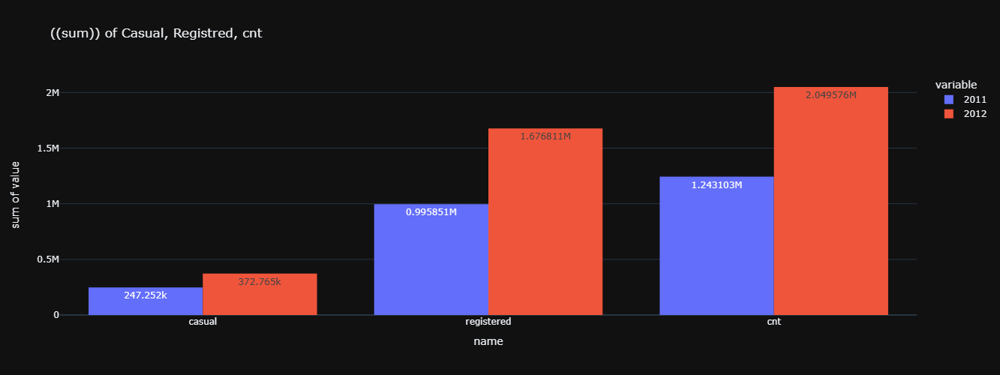

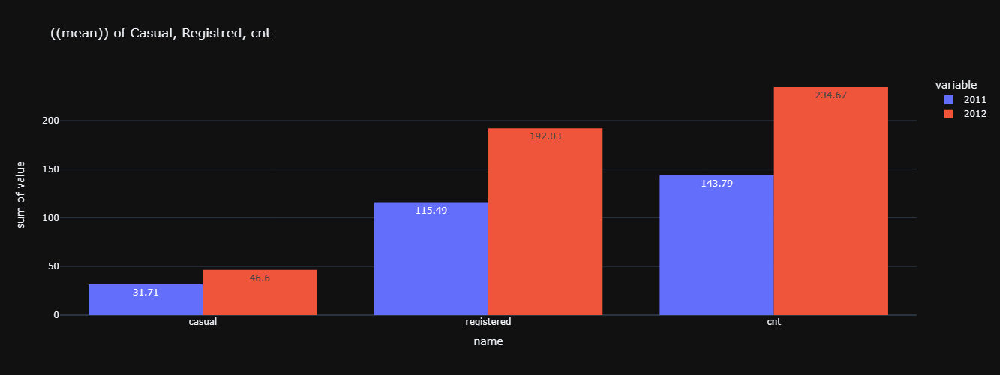

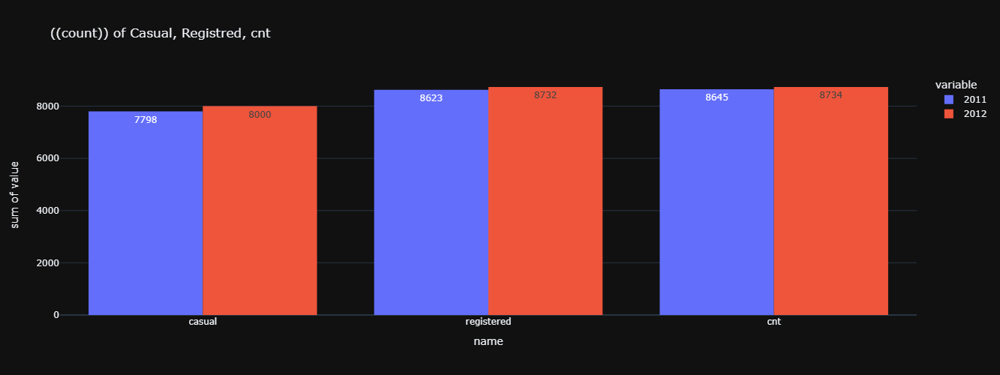

In [230]:
# Explore the count of ['casual' , 'registered' , 'cnt'] vs each other in every year per (sum,mean,count)
for i in ['sum','mean','count']:
    Totals = {'name':['casual' , 'registered' , 'cnt'],
        '2011':[df[(df.yr == 2011) & (df.casual != 0)].casual.agg(i).round(2), 
                df[(df.yr == 2011) & (df.registered != 0)].registered.agg(i).round(2),
                df[(df.yr == 2011) & (df.cnt != 0)].cnt.agg(i).round(2) ] ,
        '2012':[df[(df.yr == 2012) & (df.casual != 0)].casual.agg(i).round(2), 
                df[(df.yr == 2012) & (df.registered != 0)].registered.agg(i).round(2),
                df[(df.yr == 2012) & (df.cnt != 0)].cnt.agg(i).round(2)] }
    Totals_Rents = pd.DataFrame(Totals)
    fig = px.histogram(Totals_Rents,x='name',y=['2011','2012'],barmode='group',text_auto=True,width=900,height=500,
                 title = f'(({i})) of Casual, Registred, cnt',template='plotly_dark')
    fig.show()
    print('')

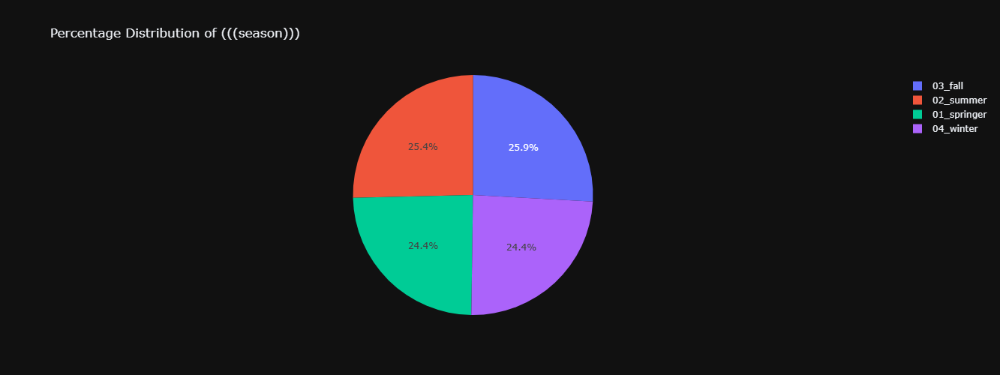

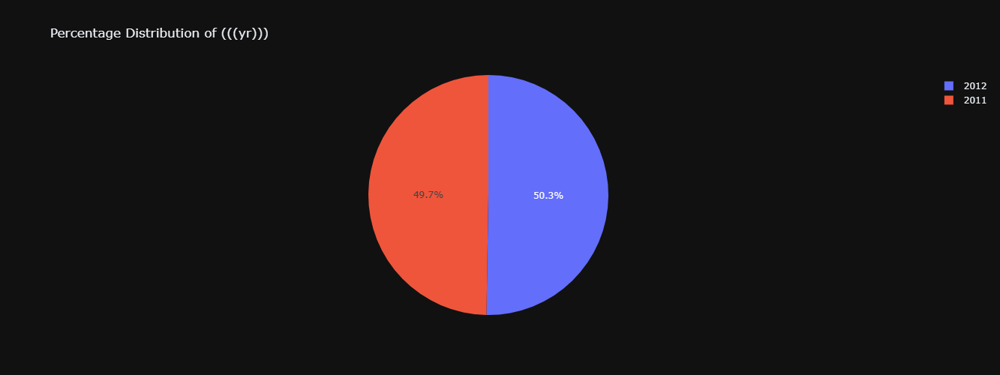

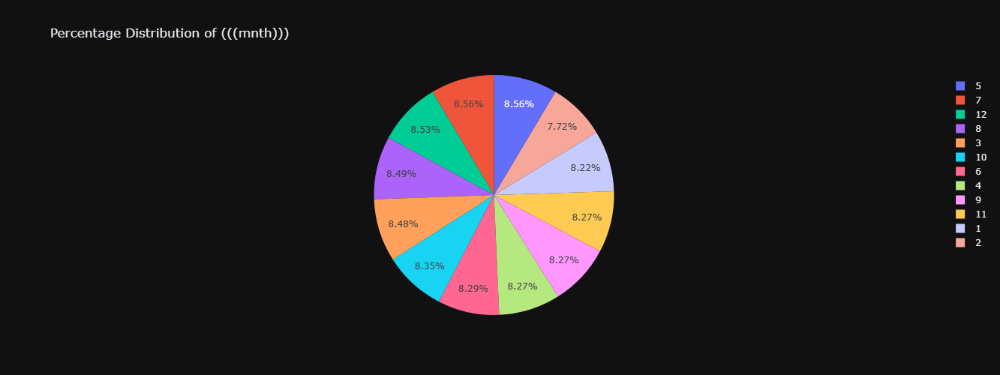

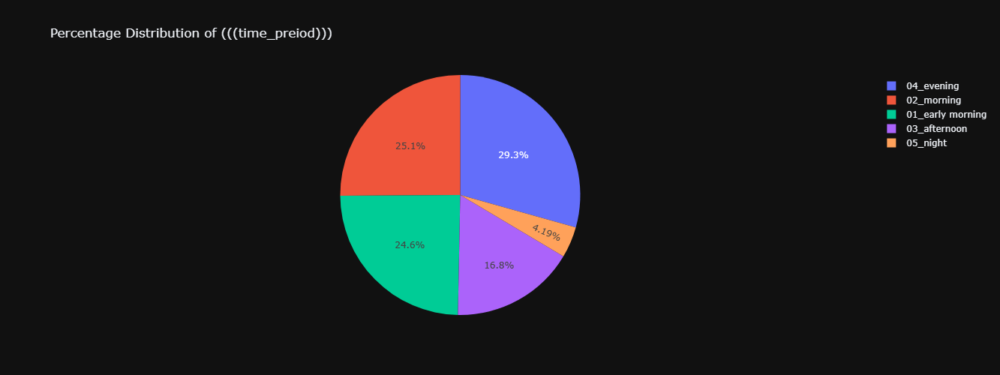

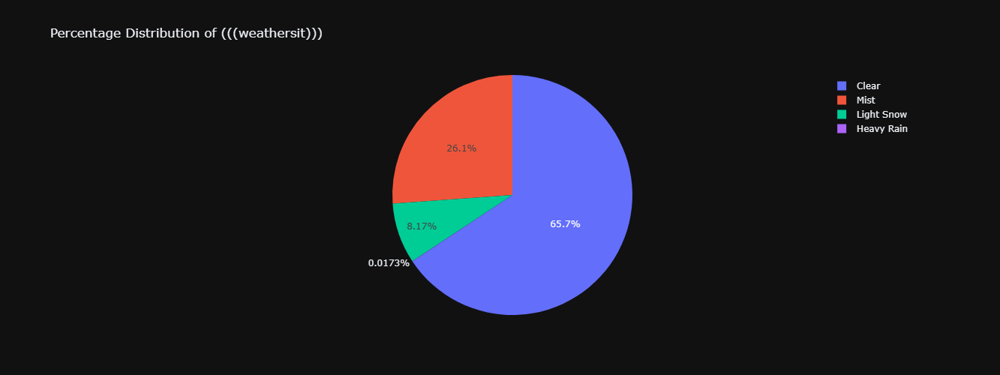

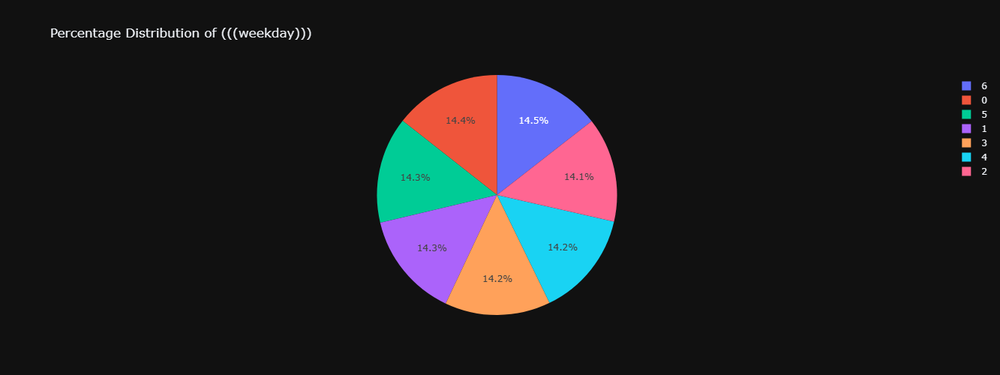

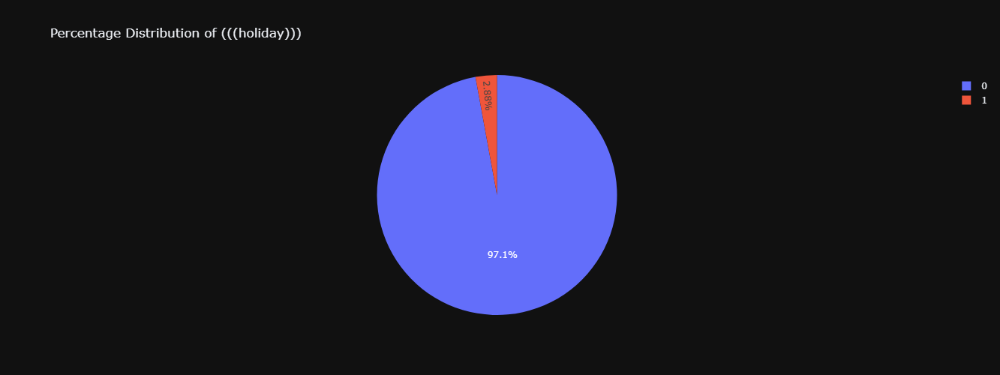

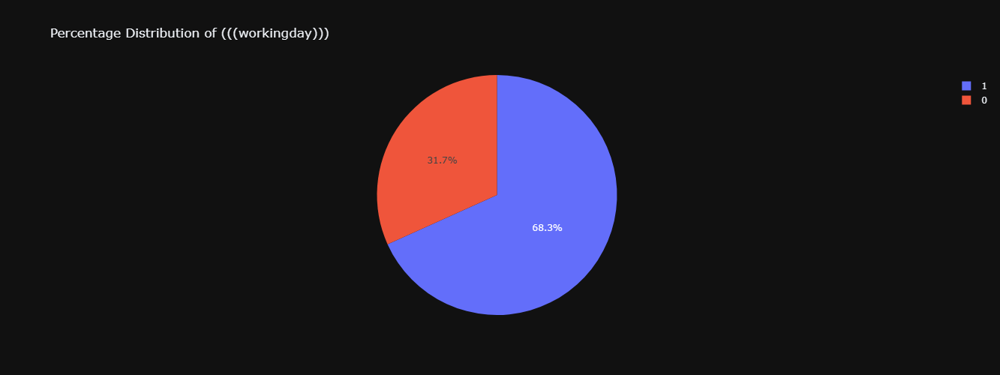

In [231]:
for i in ['season','yr','mnth','time_preiod','weathersit','weekday','holiday','workingday']:
    msk = df[i].value_counts().reset_index().sort_values(i)
    px.pie(msk , names=i , values='count',width=500,height=500,title=f'Percentage Distribution of ((({i})))',template = 'plotly_dark').show()
    print(" ")

* `Distribution`

In [232]:
df.select_dtypes(include='number').head(1)

,yr,mnth,hr,holiday,weekday,workingday,temp,atemp,hum,windspeed,casual,registered,cnt
0,2011,1,0,0,6,0,9.84,14.39,81.00,0.00,3,13,16


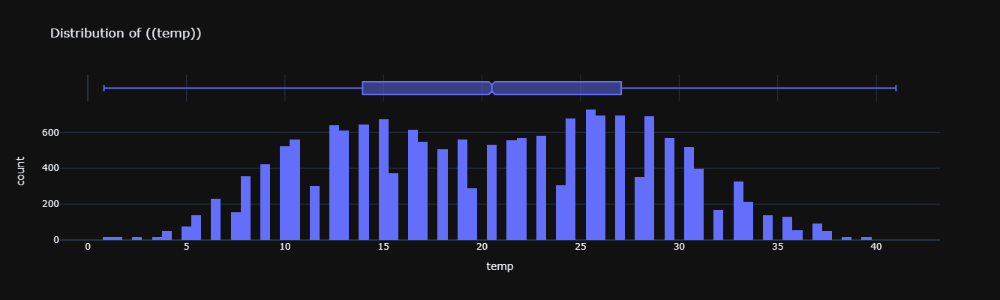

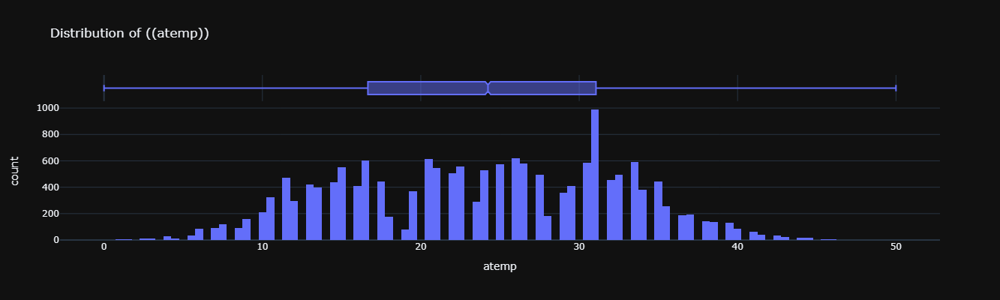

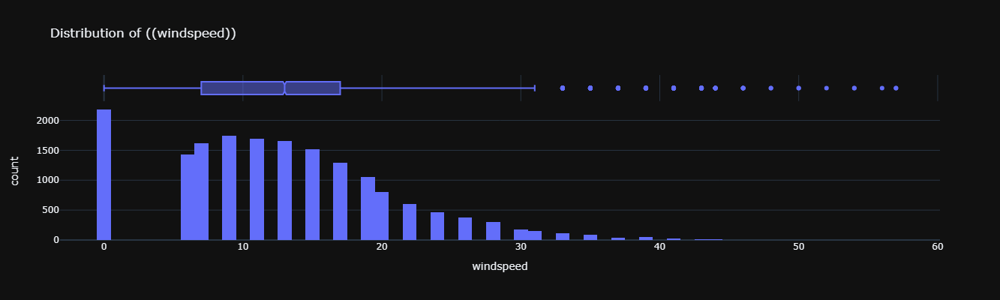

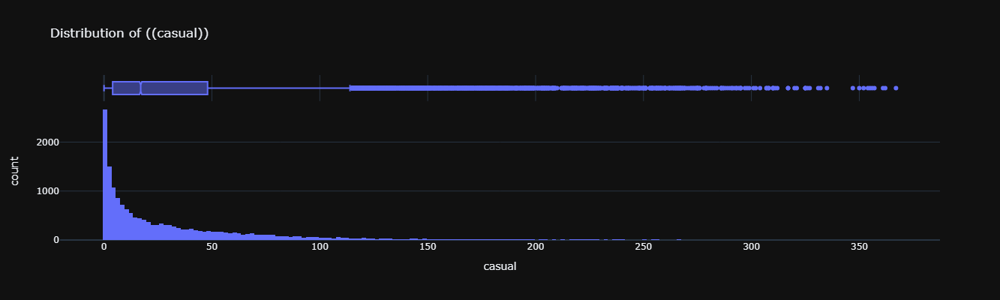

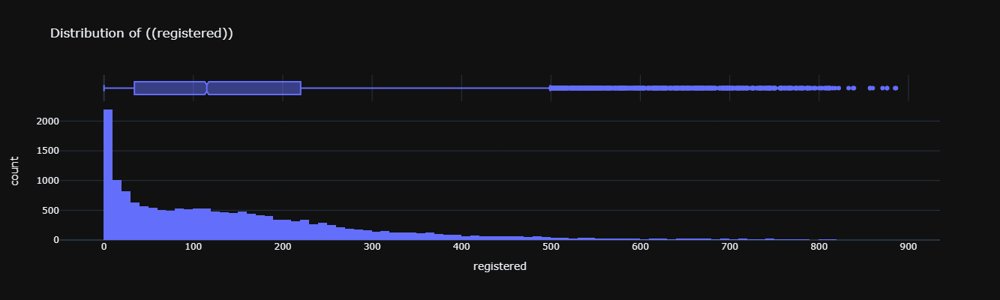

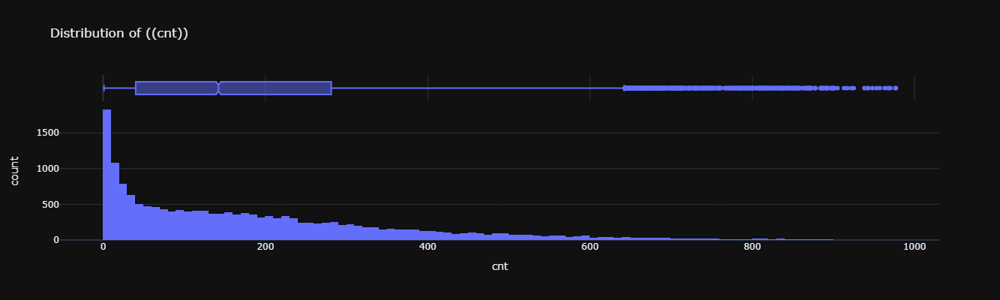

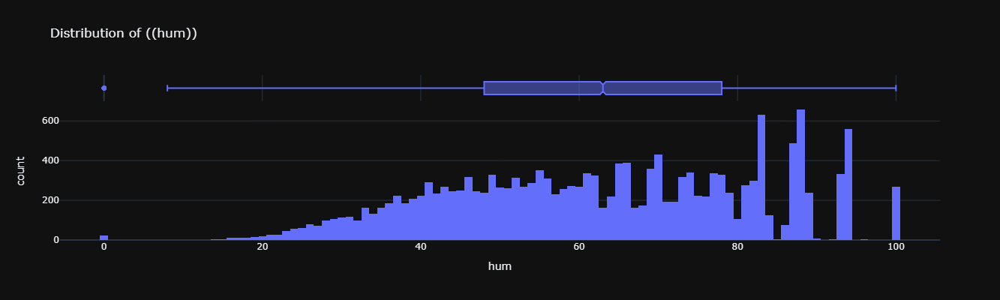

In [233]:
for i in ['temp','atemp','windspeed','casual','registered','cnt','hum']:
    px.histogram(df, x=i,width=700,height=400,title=f'Distribution of (({i}))',marginal='box',template = 'plotly_dark').show()
    print(" ")

### 🟢 Bivariate and Multivariate Analysis

* `Seasons`: `Fall` is top avg count then `summer` and `spring` is lowest season
* `Year`: `2012` is higher than `2011`
* `Weather sit`: Top avg Count in `Clear Weather` sit then `Mist`, and the `Heavy Rain` is the lowest
* `Holiday`: Lower avg in `Holiday` days, But the numbers are close.
* `Weekday`: `Saturdays, Sundays` are lower avg count, and `Wednesday and Thursday` are the top
* `Working Flag`: `Working days` is top avg count, But the numbers are close.
* `Time Period`: `Evening` is top then `Morning` then `after noon`, `Early Morning` is lowest
* `Hours`: 
    - Starting from 7:00 AM to 10:00 AM the numbers are increasing from 76 rentals and the top at 08:00 AM to be 359 rentals
    - Then it is keeping fixed with avg 200 rental to 251 rentals from 11:00 AM to 03:00 PM.
    - Then starting to increase again from 04:00 PM to 08:00 PM to be from 311, 461, 311, 226 rents as sequential
* `Months`: Months from `Jun to Sep` are close Top, and from `Jan to March` are the lowest

In [234]:
df.head(1)

,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,time_preiod,yr_mnth
0,2011-01-01,01_springer,2011,1,0,0,6,0,Clear,9.84,14.39,81.00,0.00,3,13,16,01_early morning,2011-01


In [235]:
pd.crosstab([df[df.yr==2011].yr_mnth],df['weathersit'],values=df.cnt,aggfunc='sum').replace(np.nan,'')

weathersit,Clear,Heavy Rain,Light Snow,Mist
yr_mnth,,,,
2011-01,"24,086.00",36.00,"1,597.00","12,470.00"
2011-02,"33,271.00",,"3,036.00","11,908.00"
2011-03,"39,495.00",,"2,943.00","21,607.00"
2011-04,"63,488.00",,"6,308.00","25,074.00"
2011-05,"95,424.00",,"9,536.00","30,861.00"
2011-06,"105,798.00",,"6,330.00","31,384.00"
2011-07,"123,753.00",,"1,879.00","15,709.00"
2011-08,"110,640.00",,"5,944.00","20,107.00"
2011-09,"67,741.00",,"11,280.00","48,397.00"


#### 🔻Crosstab EDA

In [236]:
pd.crosstab( [df[df.yr == 2011].yr_mnth.astype(str)], df['weathersit'] , values=df.cnt ,aggfunc='sum').reset_index().replace(np.nan , '')

weathersit,yr_mnth,Clear,Heavy Rain,Light Snow,Mist
0,2011-01,"24,086.00",36.00,"1,597.00","12,470.00"
1,2011-02,"33,271.00",,"3,036.00","11,908.00"
2,2011-03,"39,495.00",,"2,943.00","21,607.00"
3,2011-04,"63,488.00",,"6,308.00","25,074.00"
4,2011-05,"95,424.00",,"9,536.00","30,861.00"
5,2011-06,"105,798.00",,"6,330.00","31,384.00"
6,2011-07,"123,753.00",,"1,879.00","15,709.00"
7,2011-08,"110,640.00",,"5,944.00","20,107.00"
8,2011-09,"67,741.00",,"11,280.00","48,397.00"
9,2011-10,"83,475.00",,"9,562.00","30,474.00"


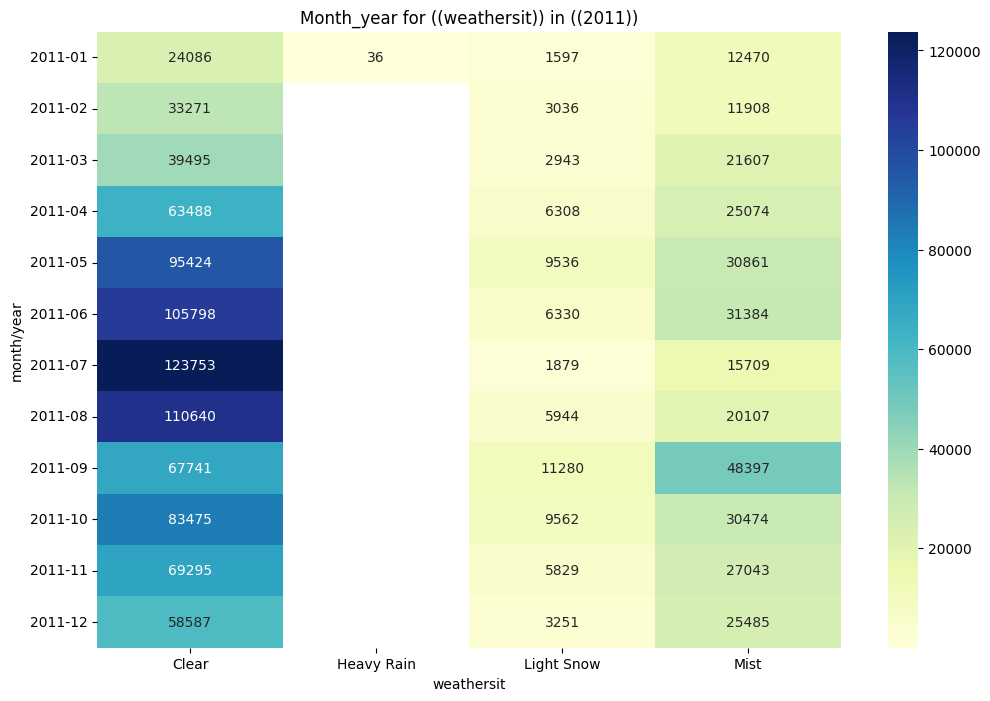

____________________________________________________________________________________________________________________________________________________________________________________


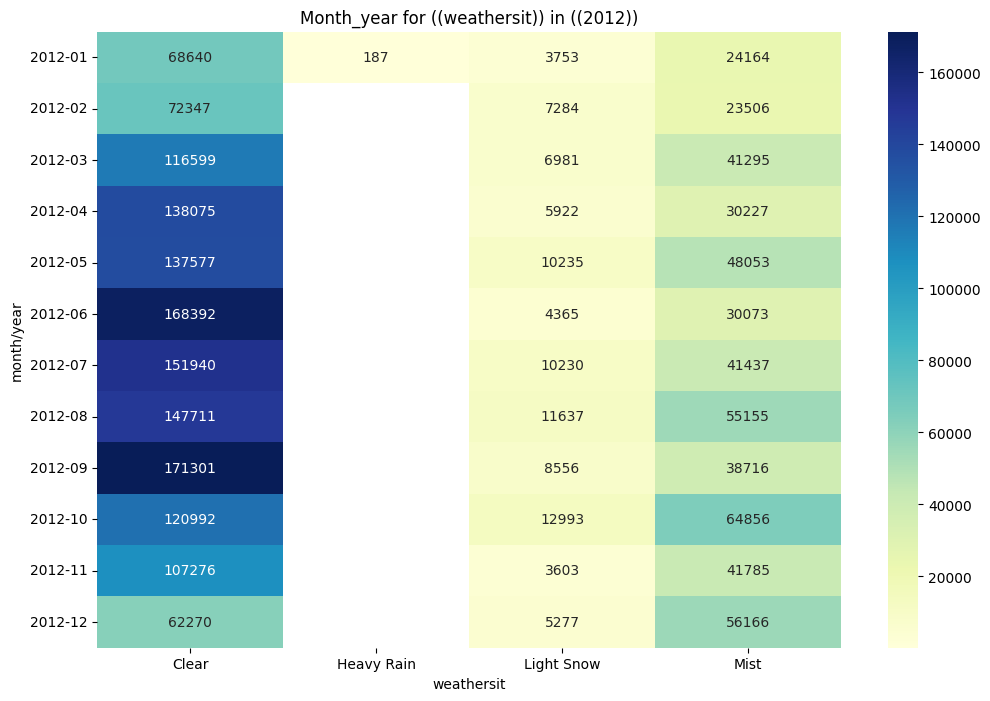

____________________________________________________________________________________________________________________________________________________________________________________


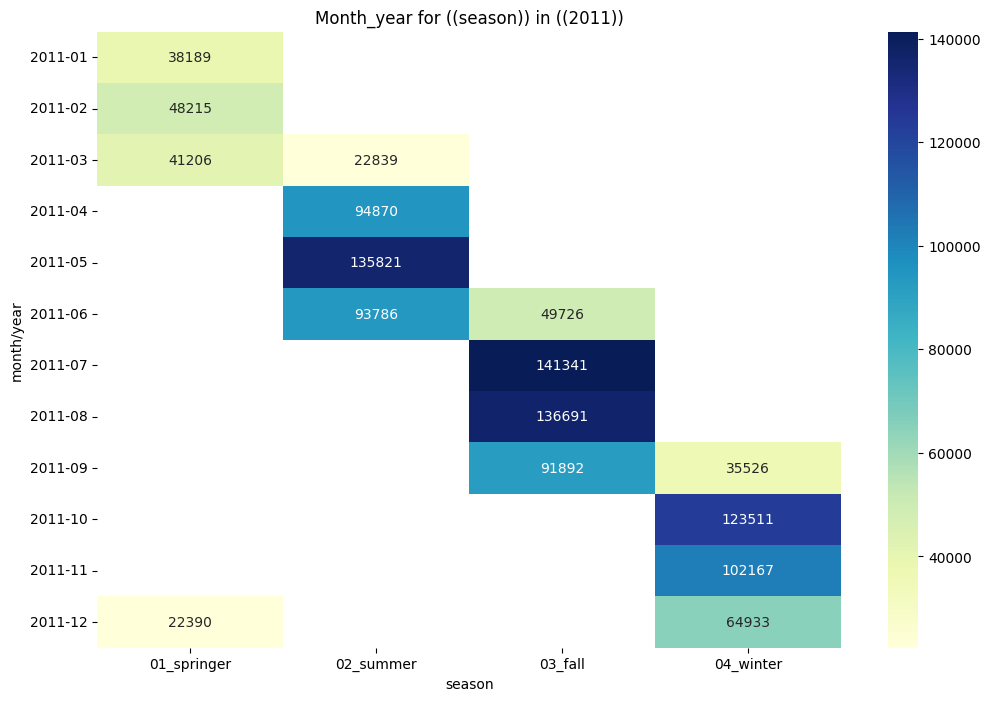

____________________________________________________________________________________________________________________________________________________________________________________


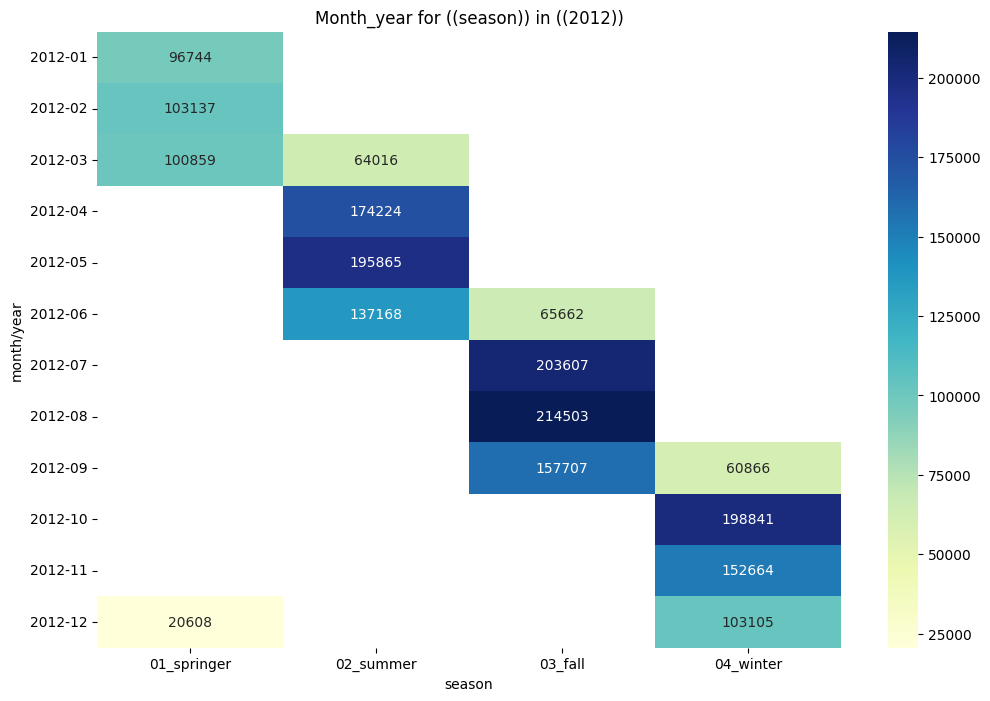

____________________________________________________________________________________________________________________________________________________________________________________


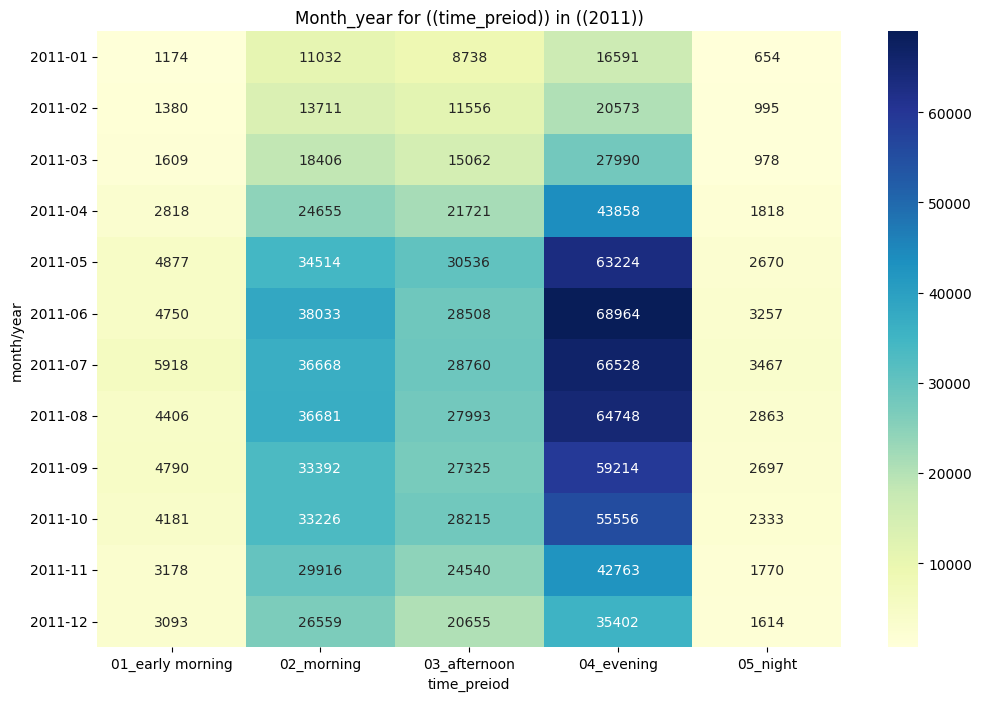

____________________________________________________________________________________________________________________________________________________________________________________


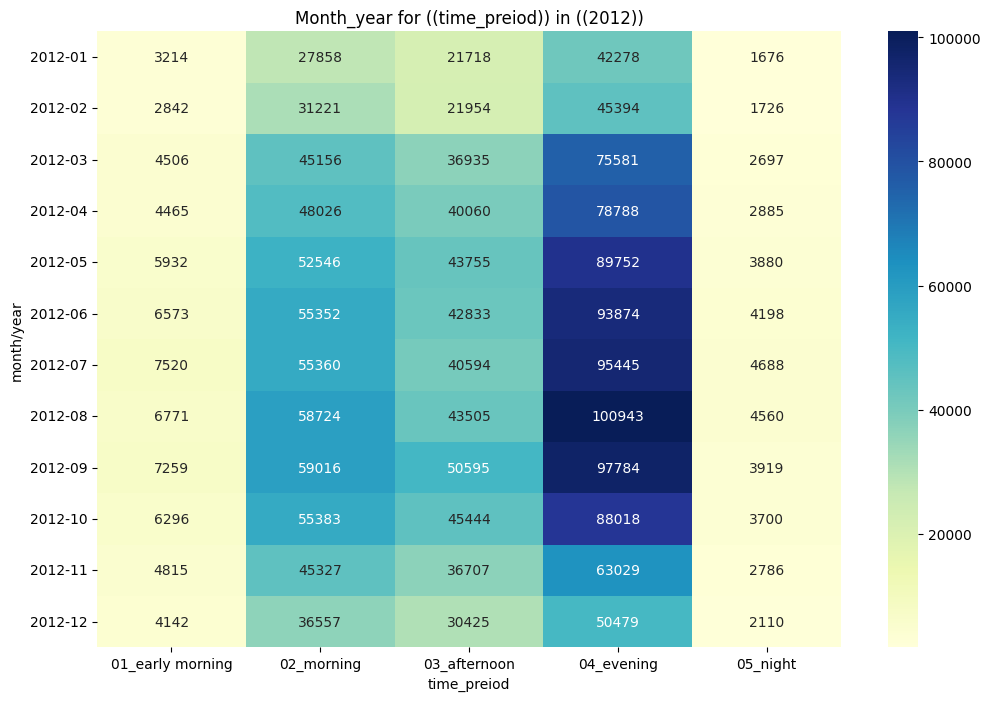

____________________________________________________________________________________________________________________________________________________________________________________


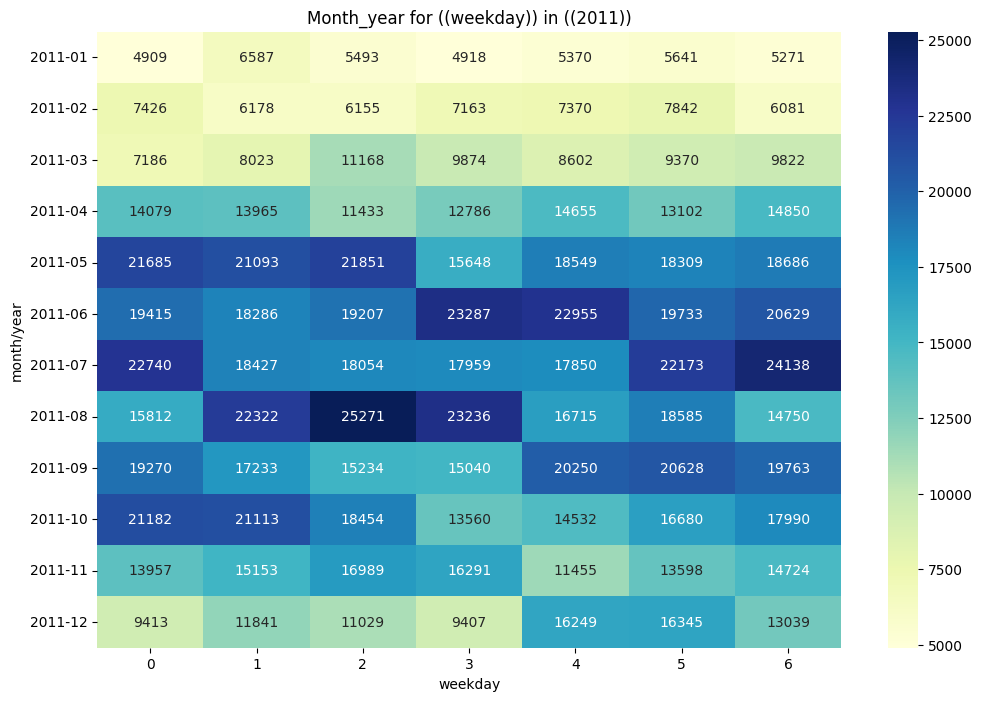

____________________________________________________________________________________________________________________________________________________________________________________


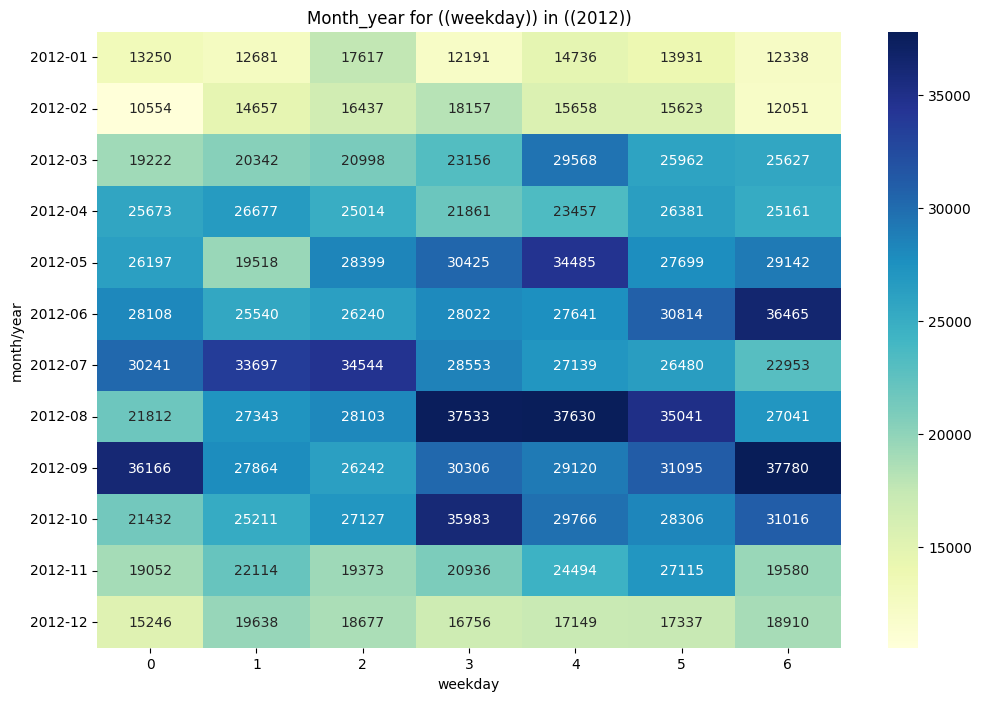

____________________________________________________________________________________________________________________________________________________________________________________


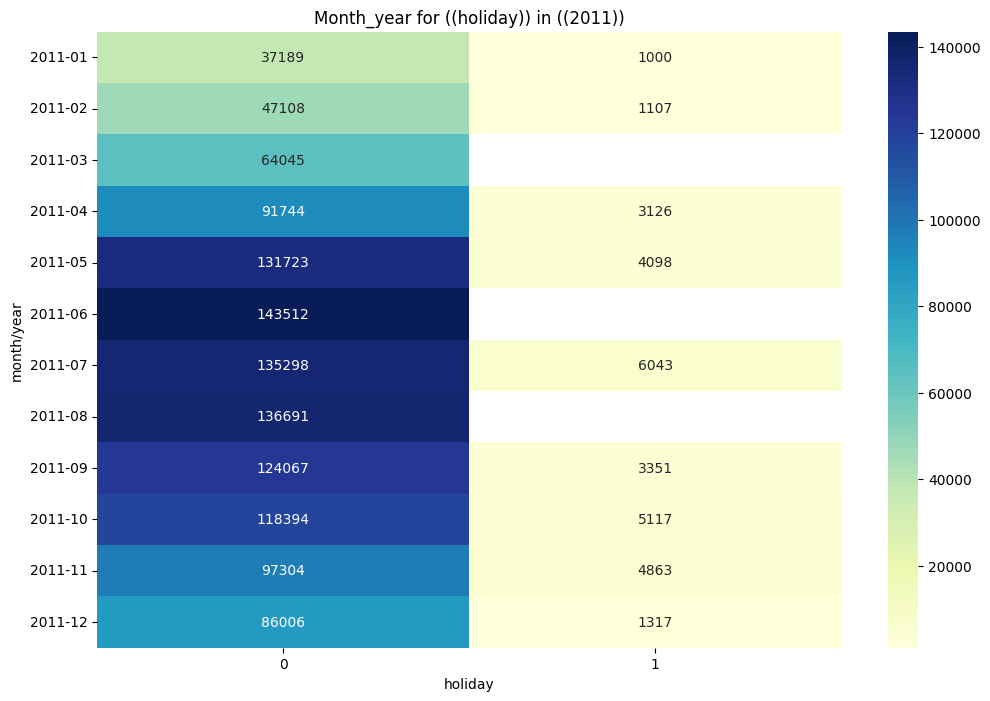

____________________________________________________________________________________________________________________________________________________________________________________


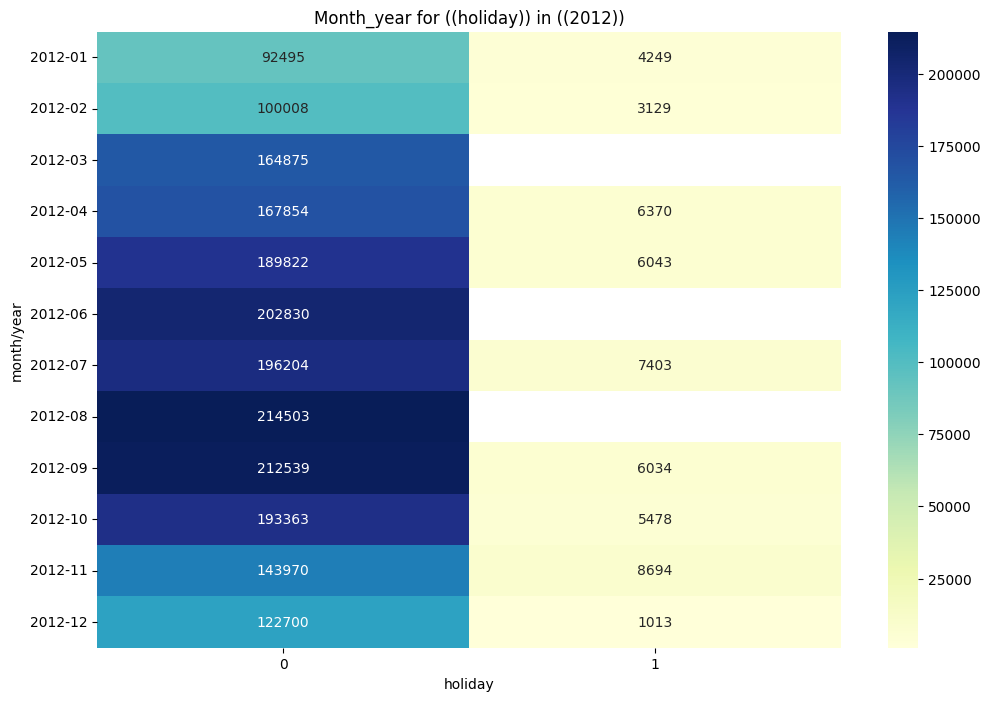

____________________________________________________________________________________________________________________________________________________________________________________


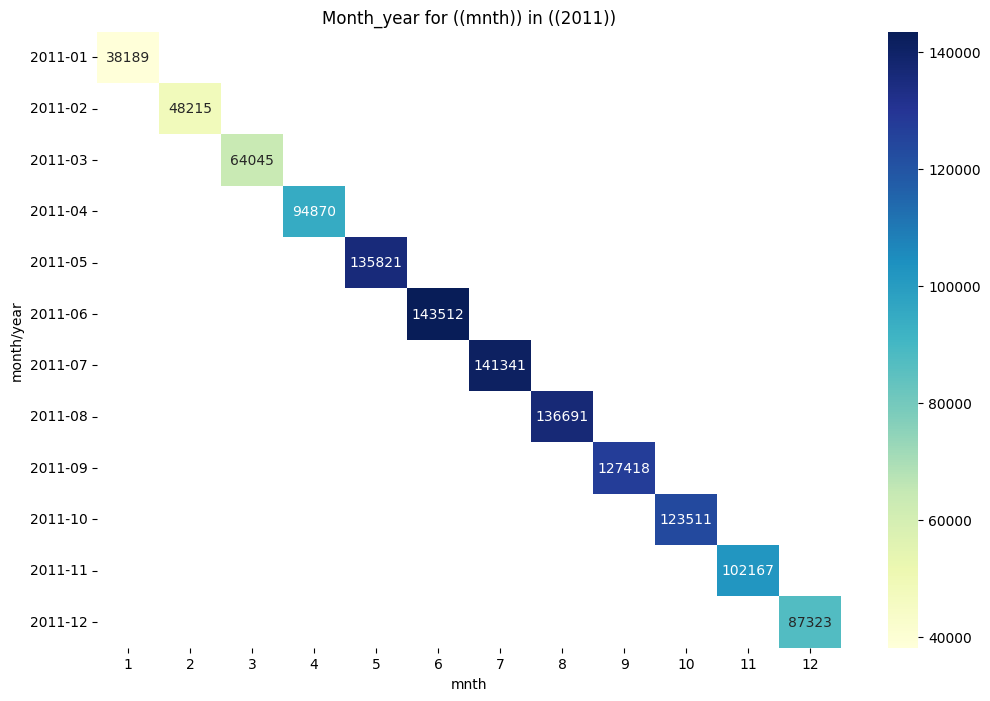

____________________________________________________________________________________________________________________________________________________________________________________


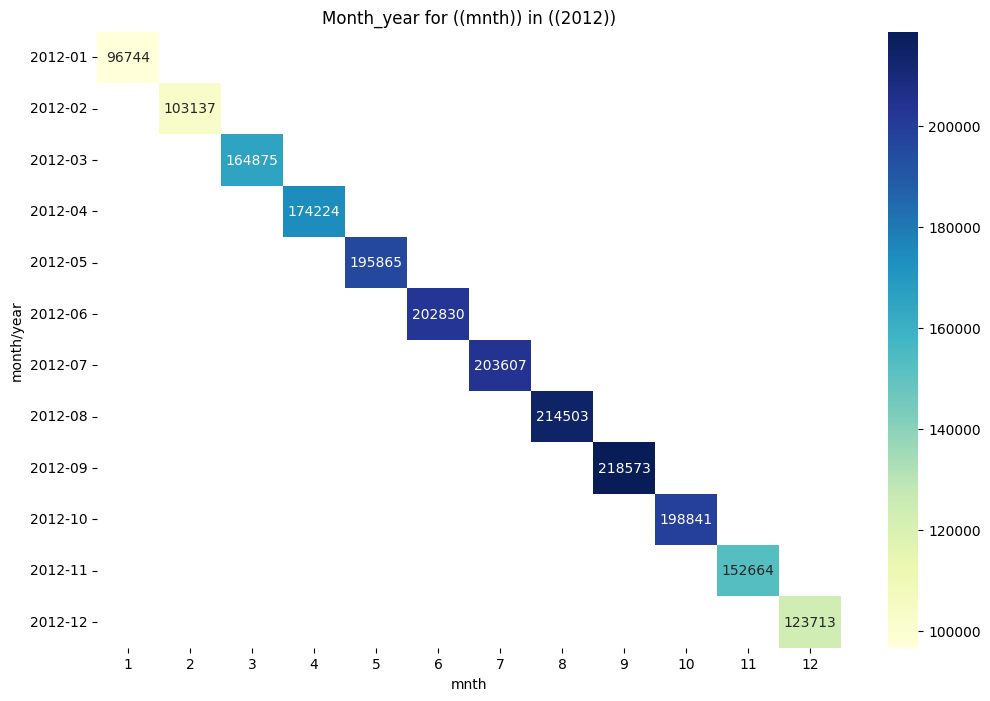

____________________________________________________________________________________________________________________________________________________________________________________


In [237]:
for i in ['weathersit' , 'season' , 'time_preiod' , 'weekday' , 'holiday' , 'mnth']:
    for x in df.yr.unique().tolist():
        cross_tab_time = pd.crosstab( [df[df.yr == x].yr_mnth] , df[i] , values=df.cnt ,aggfunc='sum')
        HeatMapp(cross_tab_time , f"Month_year for (({i})) in (({x}))" , i , 'month/year')
        print("___"*60)

In [238]:
df.head(1)

,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,time_preiod,yr_mnth
0,2011-01-01,01_springer,2011,1,0,0,6,0,Clear,9.84,14.39,81.00,0.00,3,13,16,01_early morning,2011-01


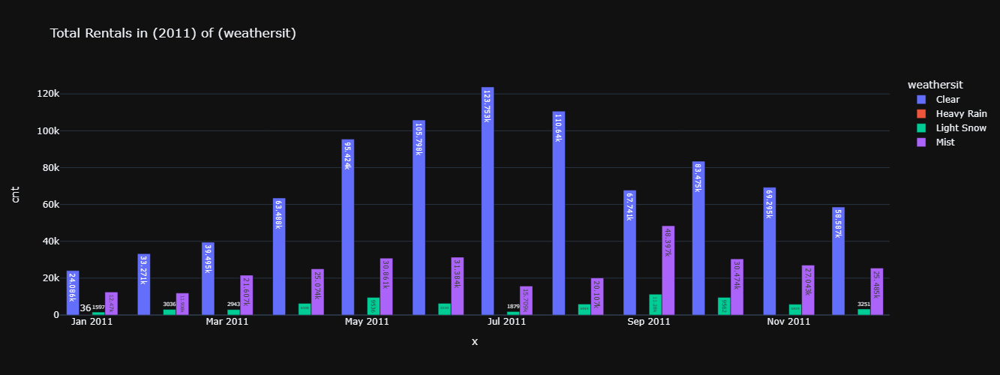

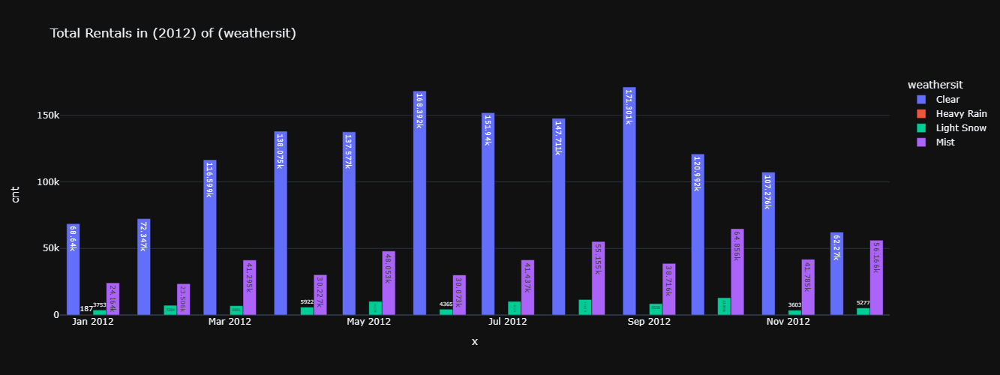

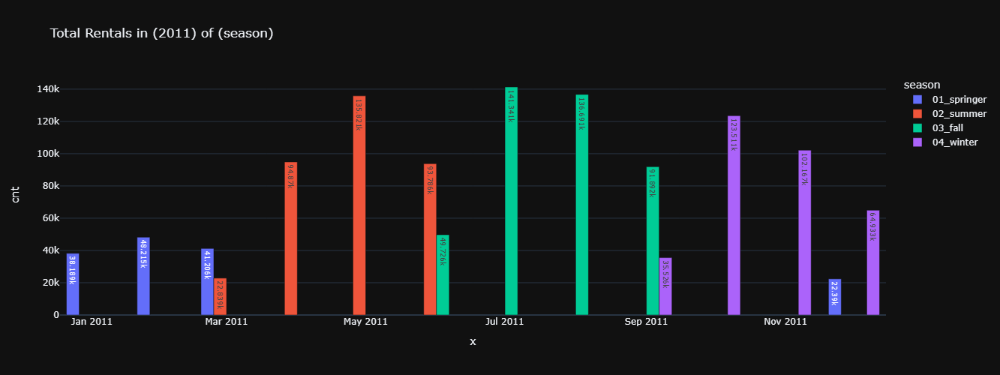

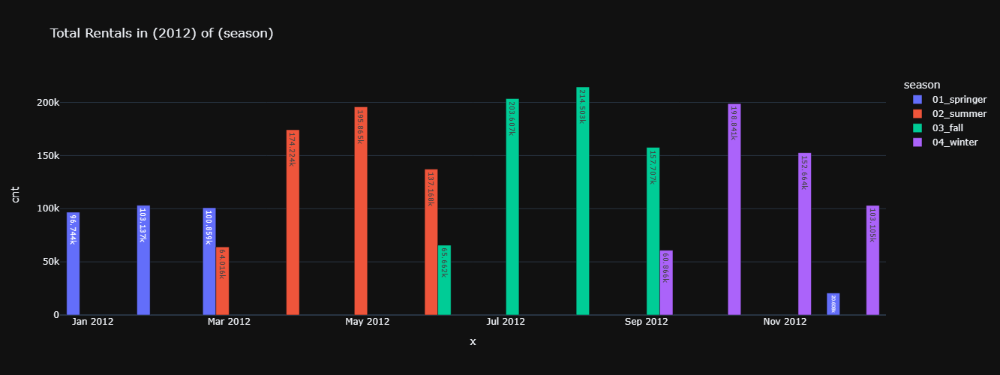

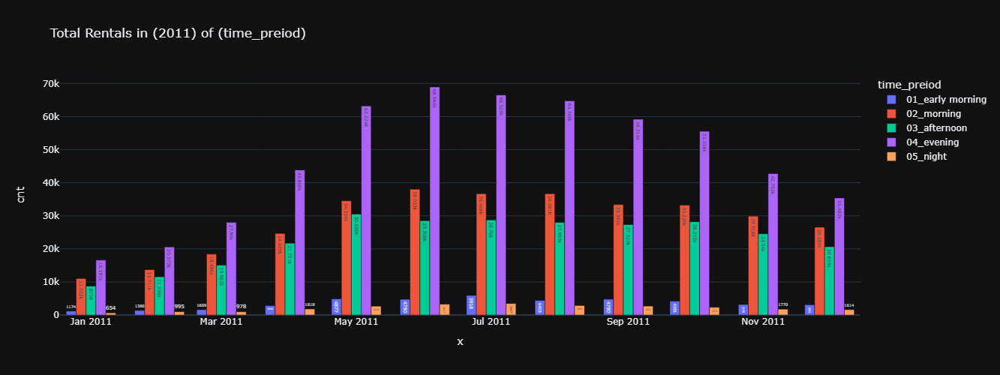

...

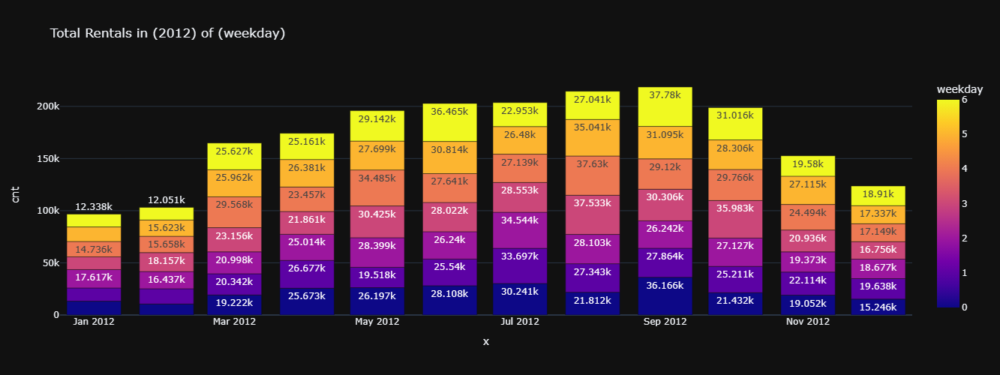

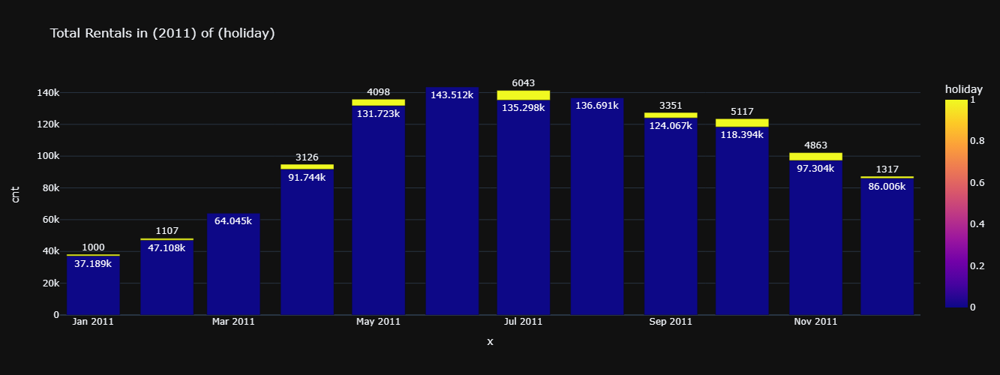

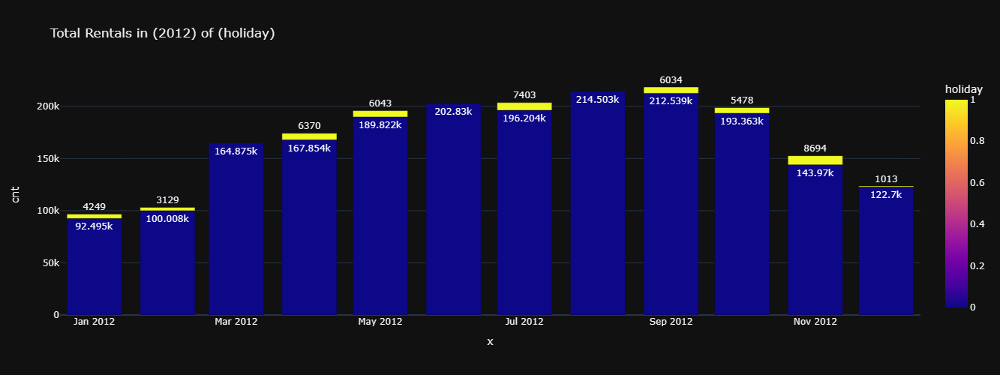

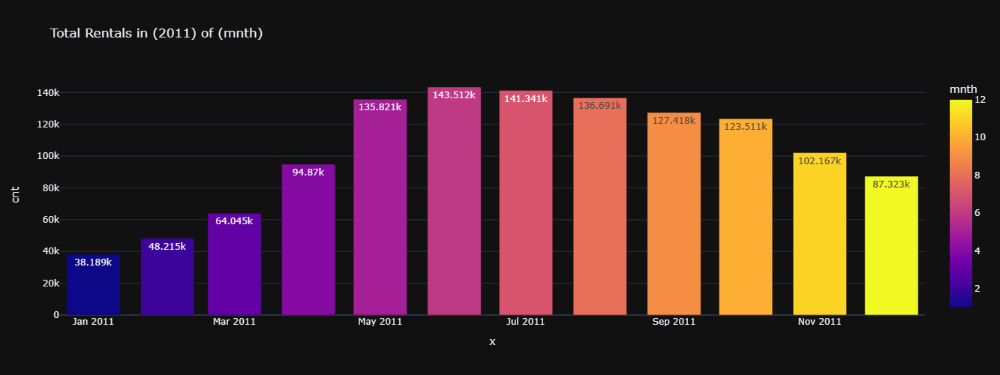

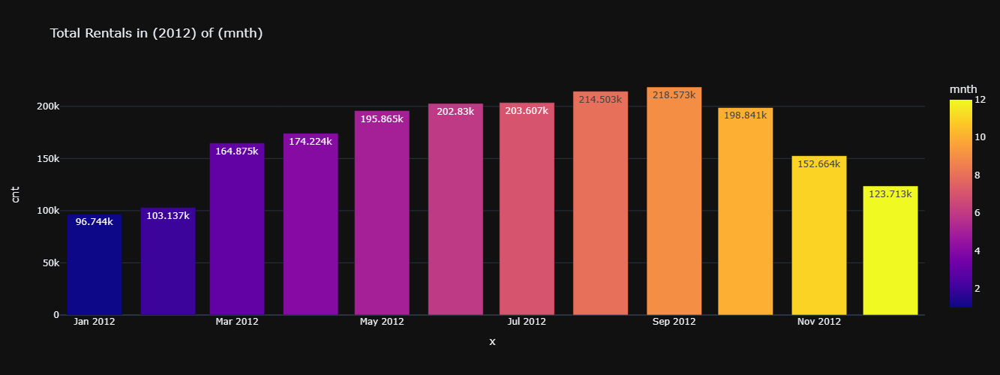

In [239]:
for i in ['weathersit' , 'season' , 'time_preiod' , 'weekday' , 'holiday' , 'mnth']:
    for x in df.yr.unique().tolist():
        mskss = df[df.yr == x].groupby(['yr_mnth',i])['cnt'].sum().reset_index()
        px.bar(mskss , x=mskss['yr_mnth'].astype(str) , y='cnt',text_auto=True,template = 'plotly_dark',color =i ,barmode='group',width=1100,height=500,title=f'Total Rentals in ({x}) of ({i})').show()
        print('')

#### 🔻Total Rentals (cnt)

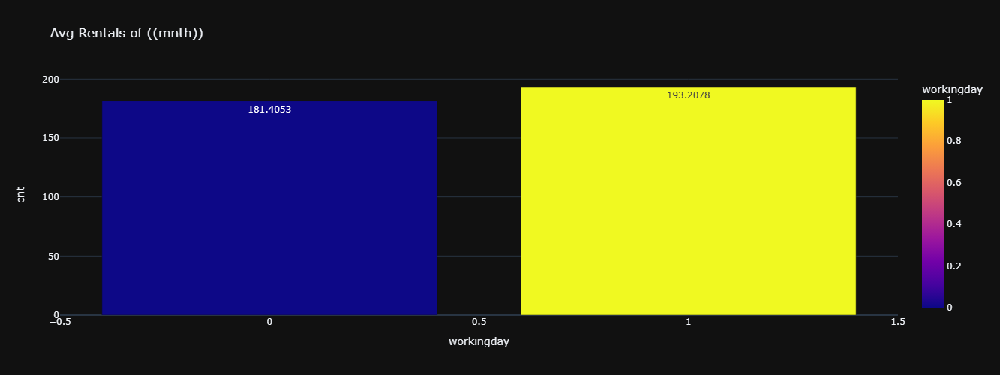

In [240]:
WO_Msk = df.groupby(['workingday'])['cnt'].mean().reset_index()
px.bar(WO_Msk , x='workingday' , y='cnt',width=900,height=500,title=f'Avg Rentals of (({i}))',text_auto=True,color='workingday',template = 'plotly_dark').show()

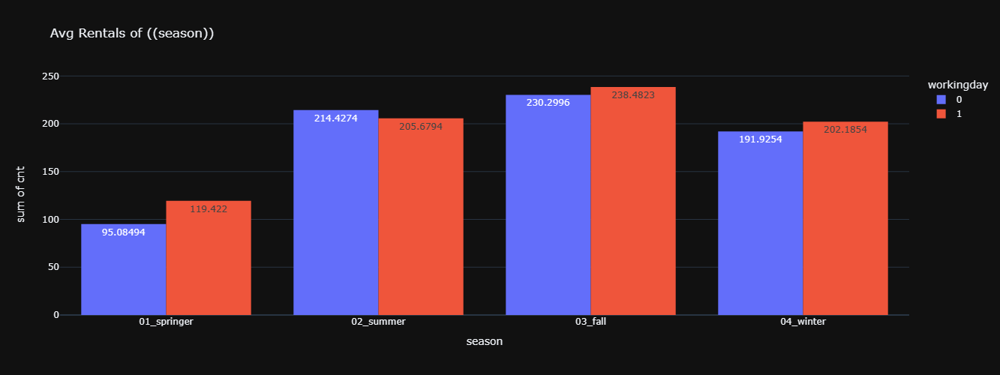

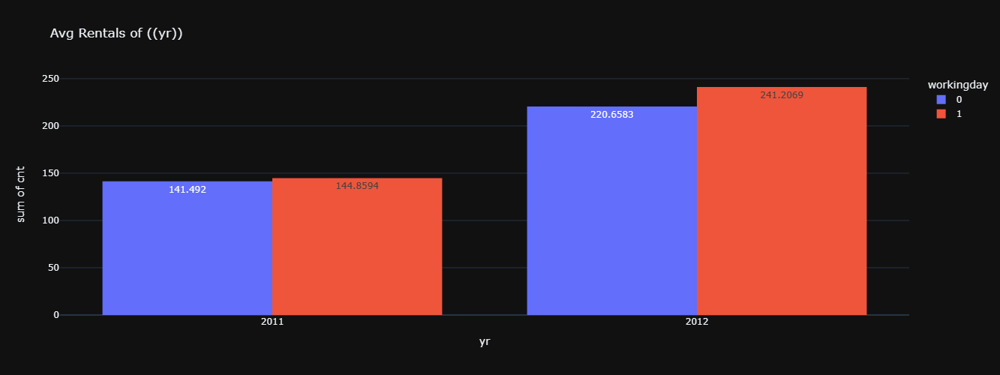

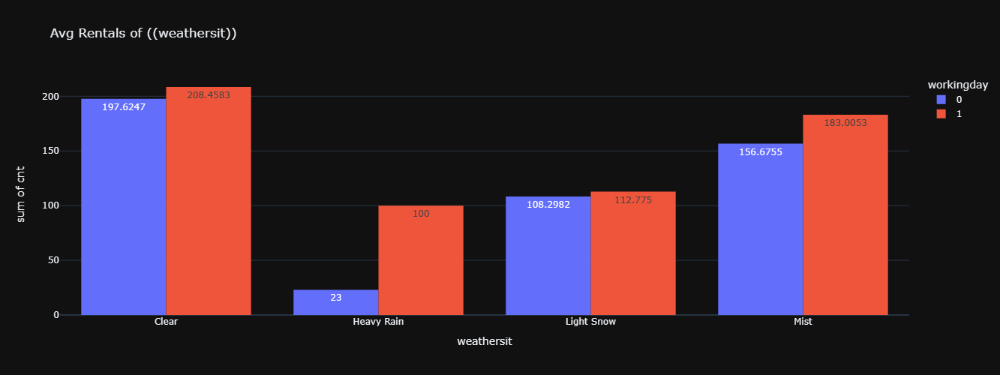

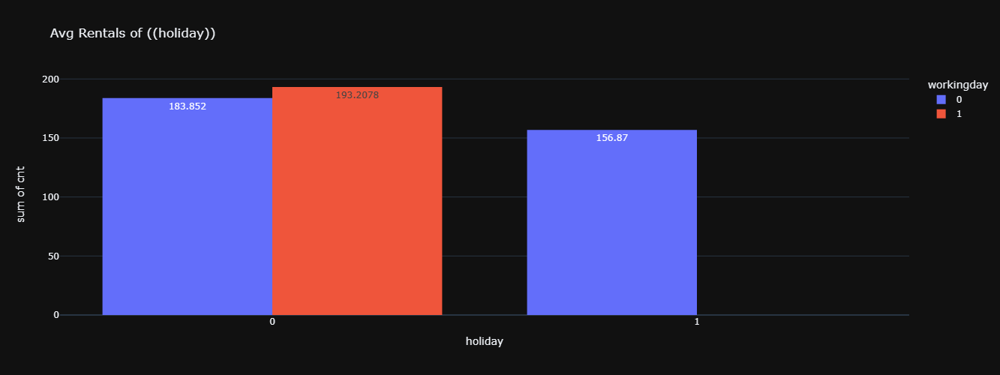

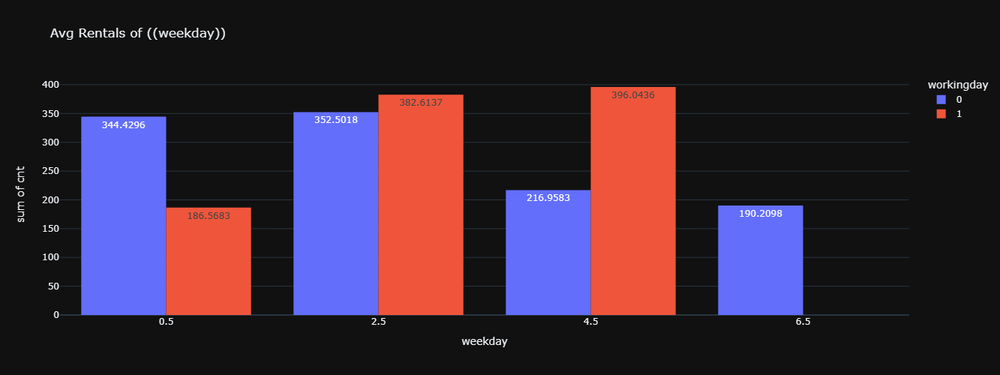

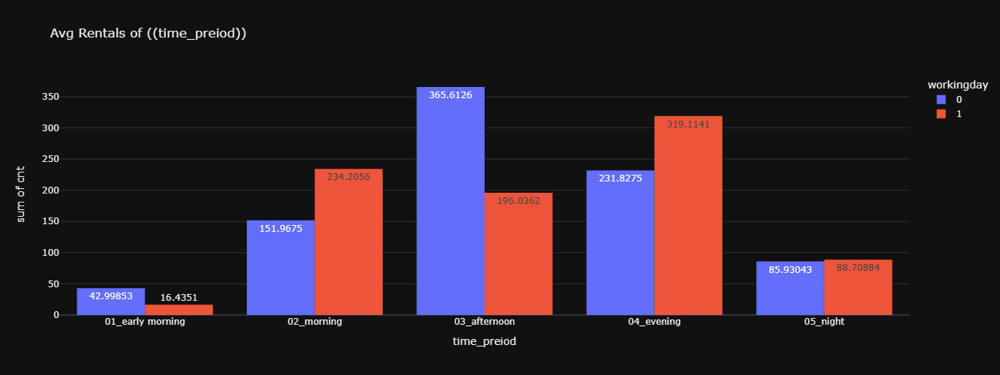

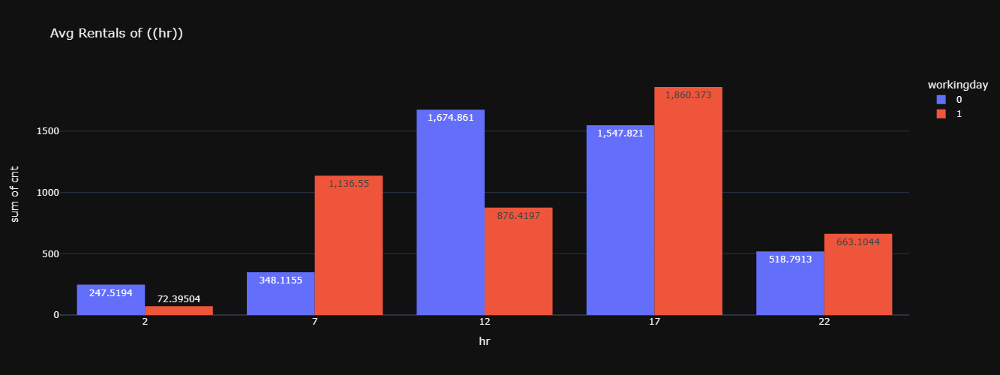

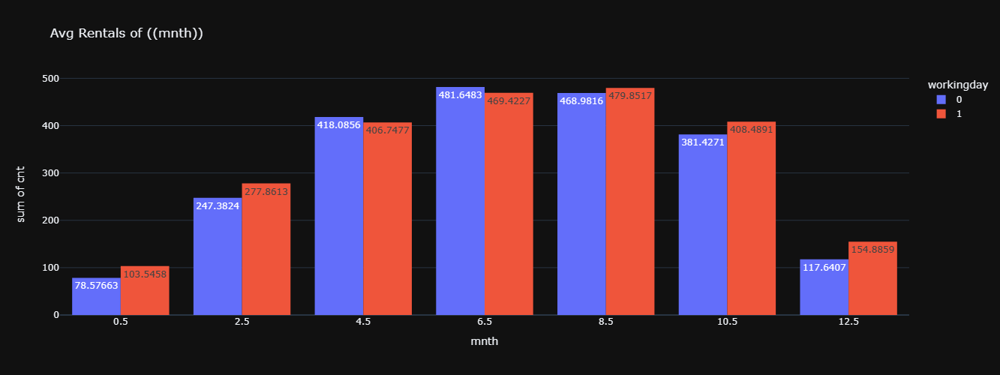

In [241]:
for i in ['season','yr','weathersit','holiday','weekday','time_preiod','hr','mnth']:
    msk = df.groupby([i,'workingday'])['cnt'].mean().reset_index().sort_values(i)
    px.histogram(msk , x=i , y='cnt',width=900,height=500,title=f'Avg Rentals of (({i}))',text_auto=True,color='workingday',barmode='group',template = 'plotly_dark').show()
    print(" ")

#### 🔻 Boxplot

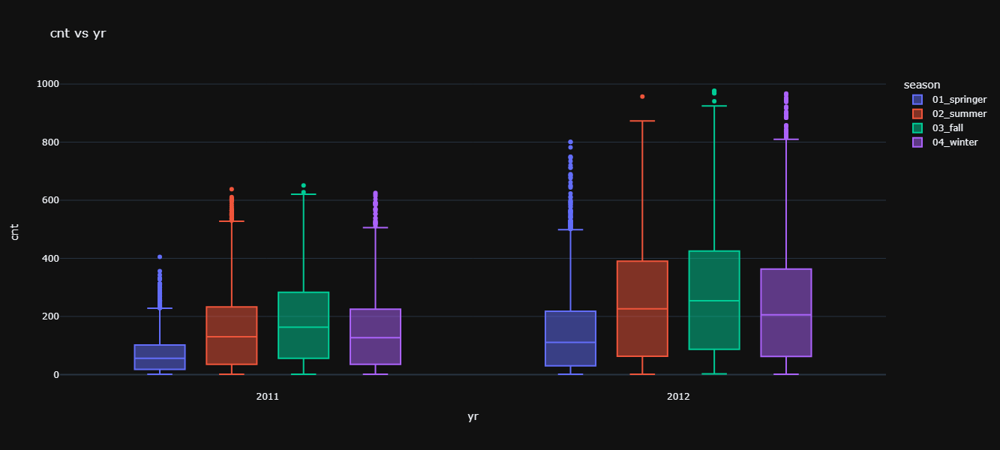

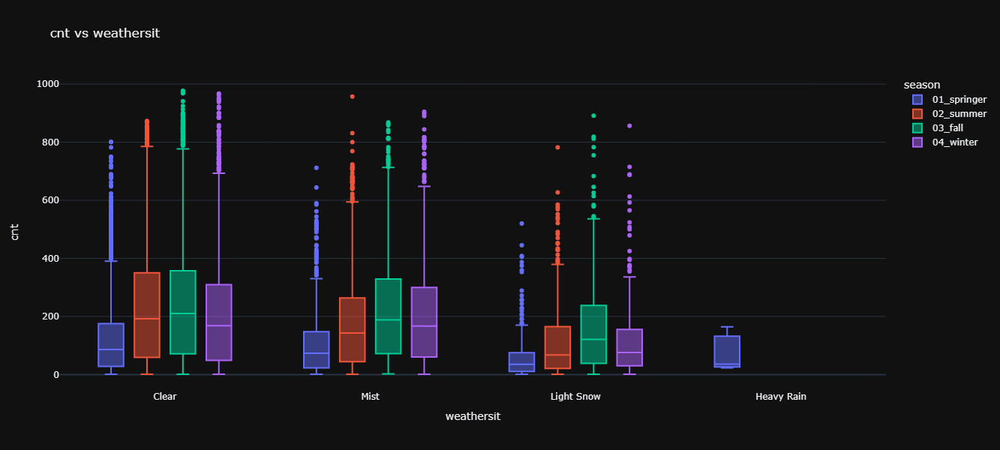

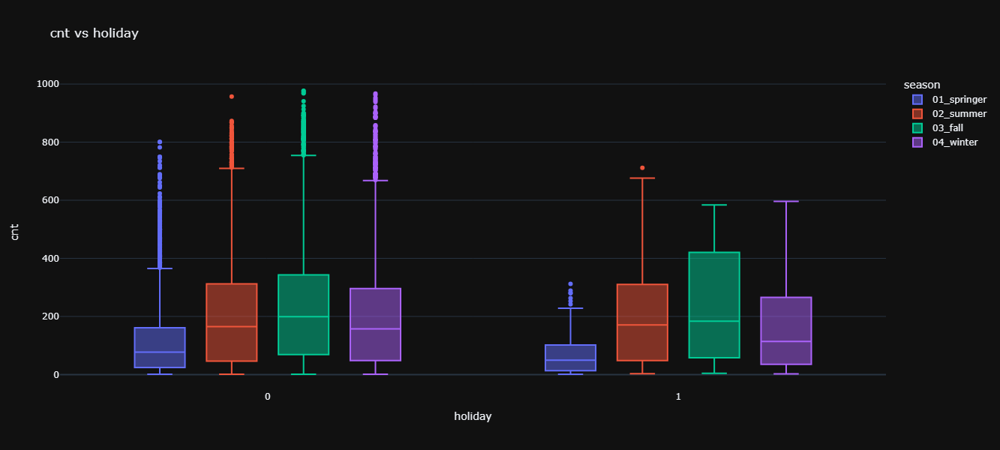

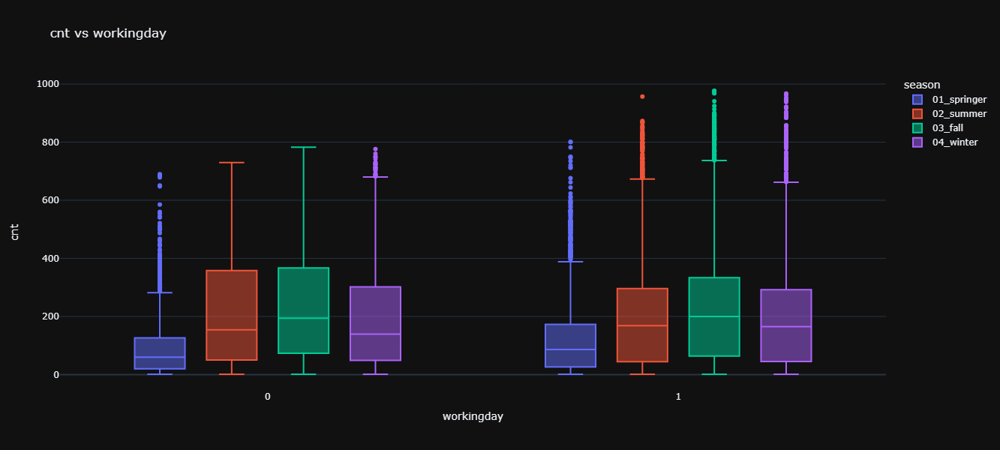

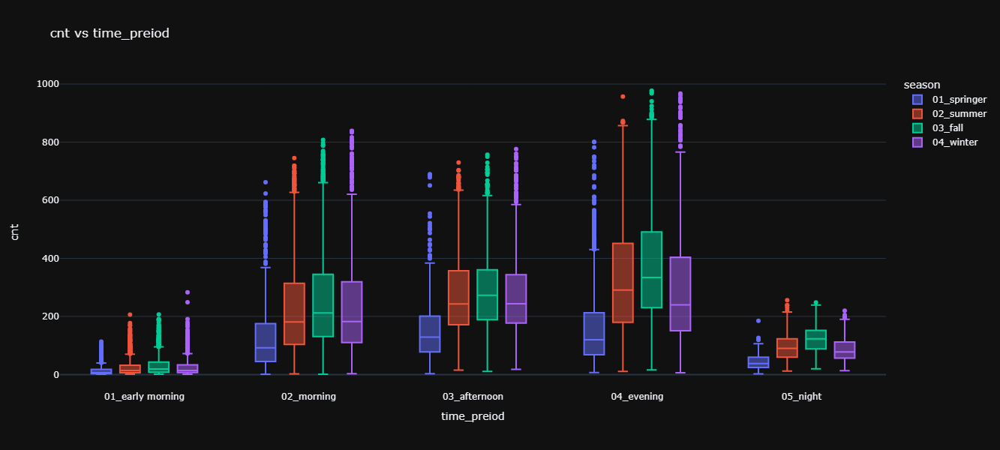

...

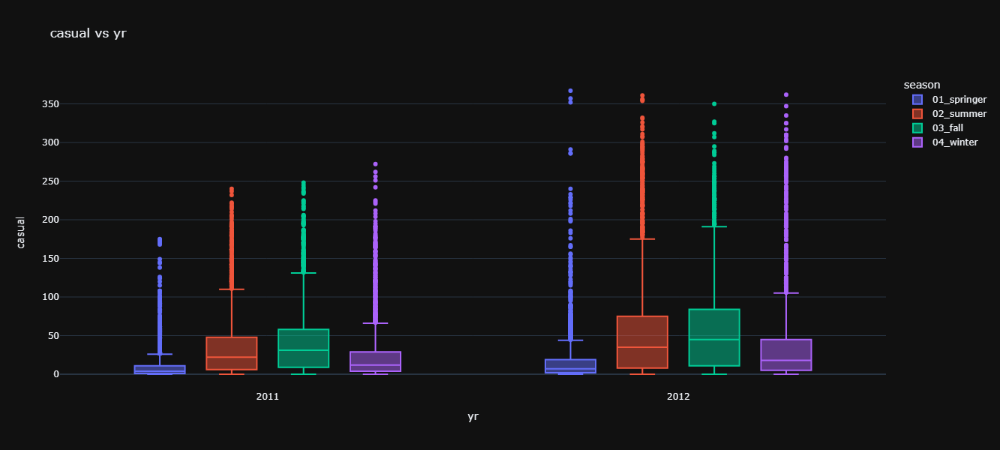

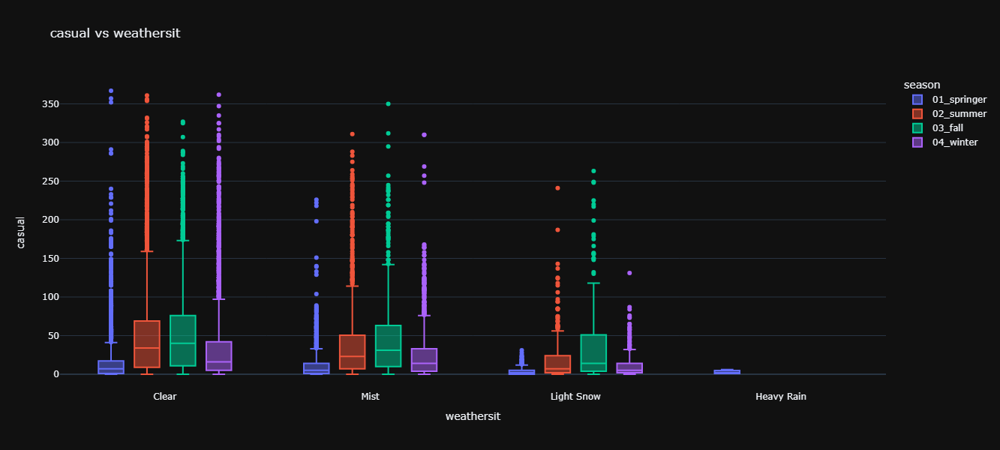

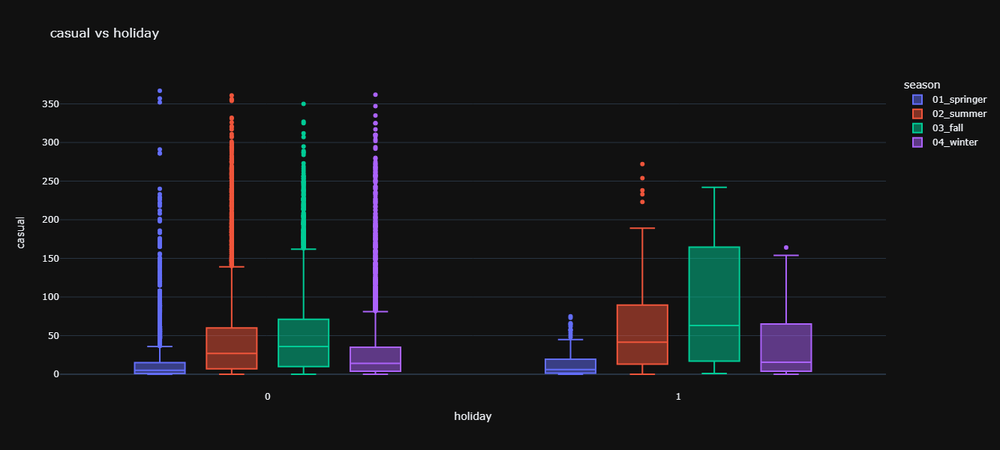

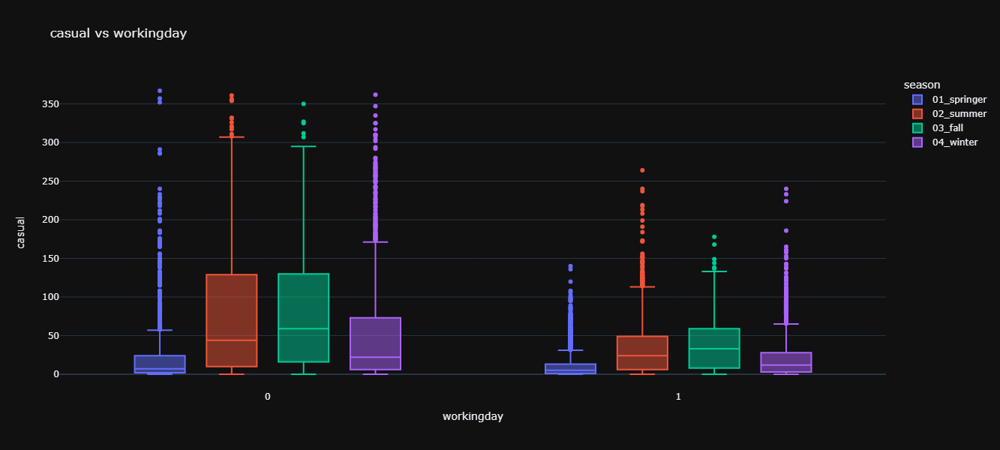

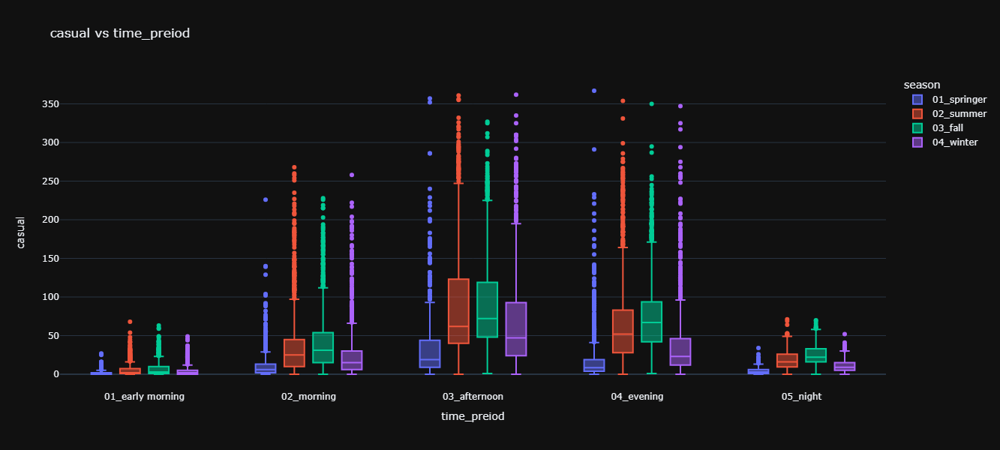

In [242]:
for i in ['cnt','registered' ,'casual']:
    for z in ['yr','weathersit','holiday','workingday','time_preiod']:
        px.box(df, y=i , x=z,color='season',width=900,height=600,title=f'{i} vs {z}',template = 'plotly_dark').show()
        print(" ")

#### 🔻 `count of rents : time_preiod vs year  per month/year`

- `Weathersit`:
    - In 2011 "`Clear`" curve raised from Jan and Fixed from `May` to `Nov` then dwon `gradually till end of year`
    - `Mist & Light Snow` the same shape, but strong raised directly to `June` then Down again gradually to `Dec`
    - `Clear` is the top line, But the point of `Mist` is the top point
    - `Light Snow` was the less line and the `June` Point was nearly from Clear and `Mist` top Points

    - `In 2012` :
    - The same approximation but in `Aug` is Cross point for `the three lines (Clear/Mist/Light Snow)`
    - `Mist Aug` Point is the Top point in the Curve

* `Time Period:`
    - `Evening` is the top line in both `2011 & 2012`
    - `Early Morning` is the less line in both `2011 & 2012`

* `Season:`
    - `Fall` in the top Season and `Spring` is the lower in both `2011 & 2012`

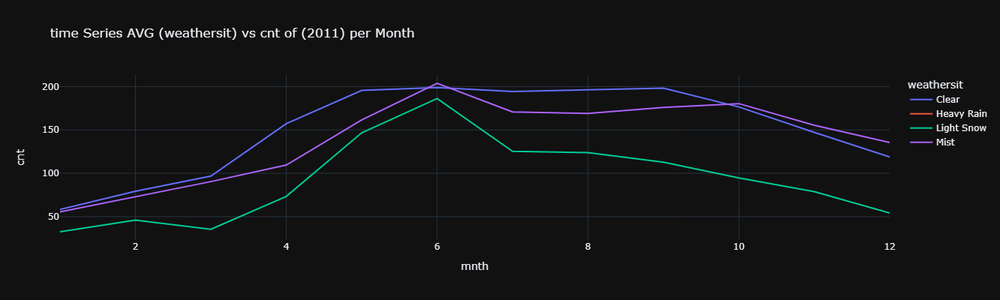

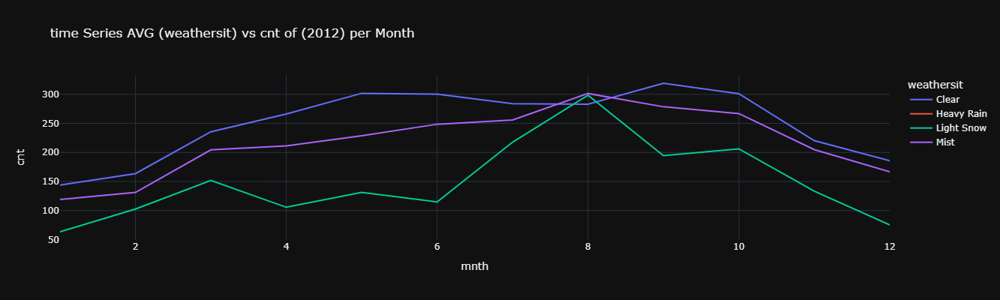

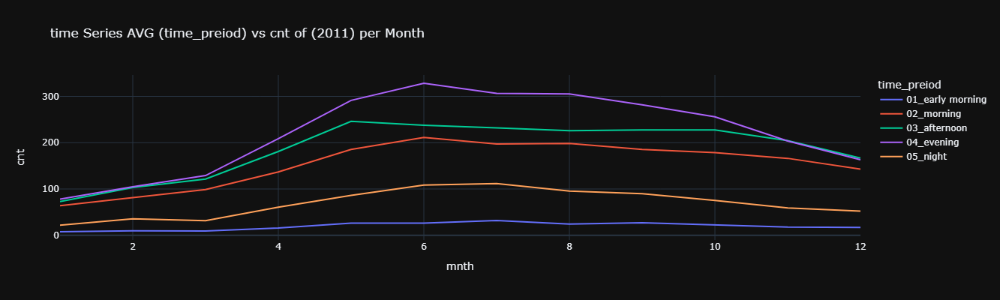

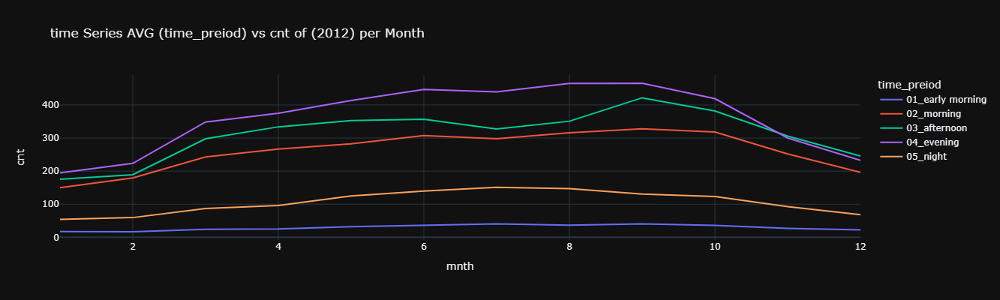

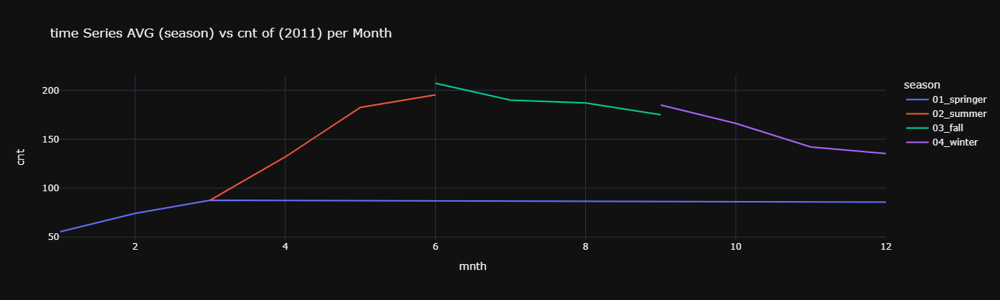

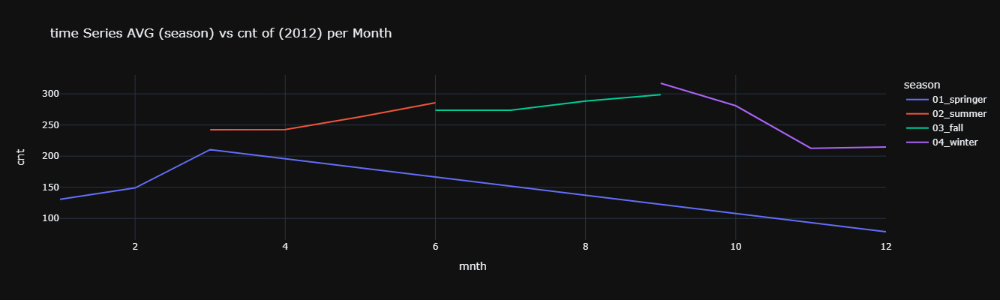

In [243]:
# cnt rents
for i in ['weathersit','time_preiod','season']:
    for x in df.yr.unique().tolist():
        msk = df[df.yr == x].groupby(['yr','mnth',i])[['cnt']].mean().reset_index().sort_values(['yr','mnth'])
        px.line(msk , x='mnth' , y='cnt',color=i,width=1000,height=400,title=f'time Series AVG ({i}) vs cnt of ({x}) per Month',template = 'plotly_dark').show()
        print("")

#### 🔻 `registered rents : time_preiod vs year  per month/year`
* Weathersit: 
    - in 2011 `Clear & Light Snow & Mist` `Crossed in Jun` but in `2012 Crossed in Aug`
    - `Mist Weather of Aug` is the top point in 2012 
    - `Clear weather` on Jun-2011 in the top point and `Clear` totally is the top Point

* Time Period: `Evening` is the top in 2011 and `night` is the lower

In [244]:
df.head(1)

,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,time_preiod,yr_mnth
0,2011-01-01,01_springer,2011,1,0,0,6,0,Clear,9.84,14.39,81.00,0.00,3,13,16,01_early morning,2011-01


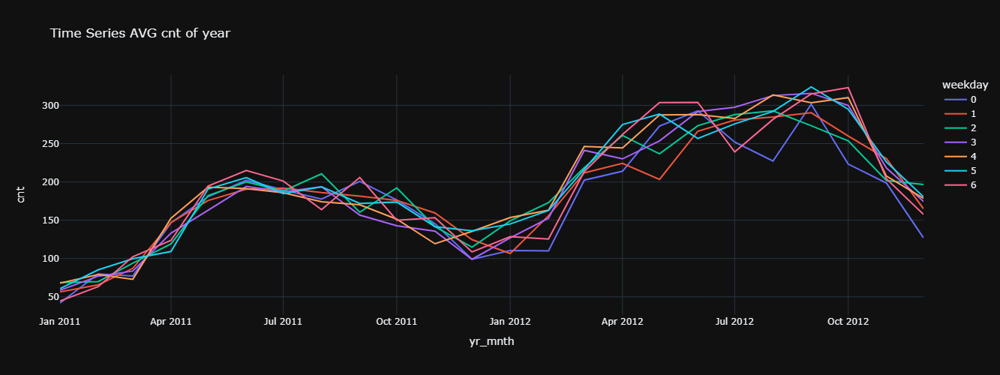

In [245]:
mask = df.groupby(['yr_mnth','weekday'])[['cnt']].mean().reset_index().sort_values(['yr_mnth'])
px.line(mask , x='yr_mnth' , y='cnt',color='weekday',width=1200,height=500,template = 'plotly_dark',title=f'Time Series AVG cnt of year').show()

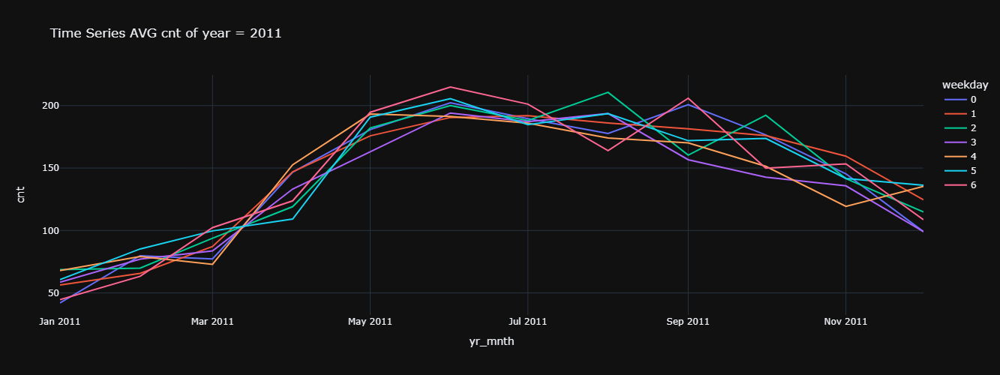

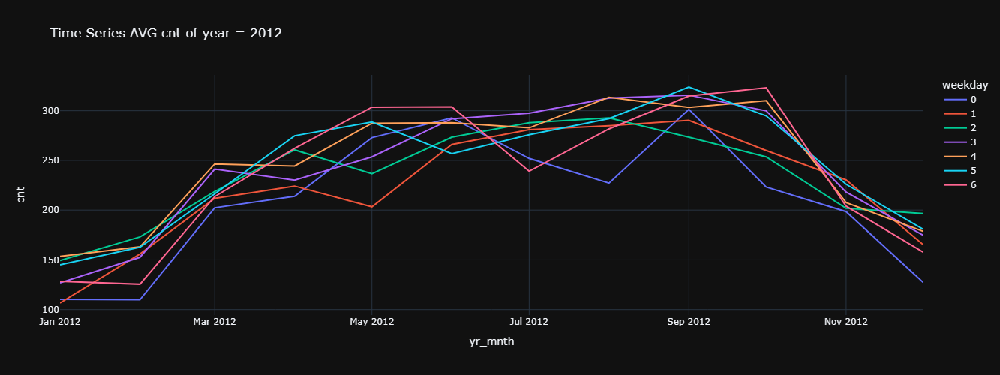

In [246]:
for i in df.yr.unique().tolist():
    mask = df[df['yr'] == i].groupby(['yr_mnth','weekday'])[['cnt']].mean().reset_index().sort_values(['yr_mnth'])
    px.line(mask , x='yr_mnth' , y='cnt',color='weekday',width=1000,height=500,template = 'plotly_dark',title=f'Time Series AVG cnt of year = {i}').show()
    print("")

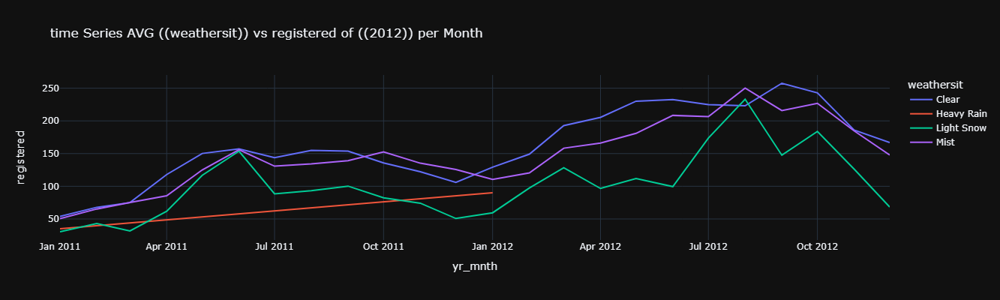

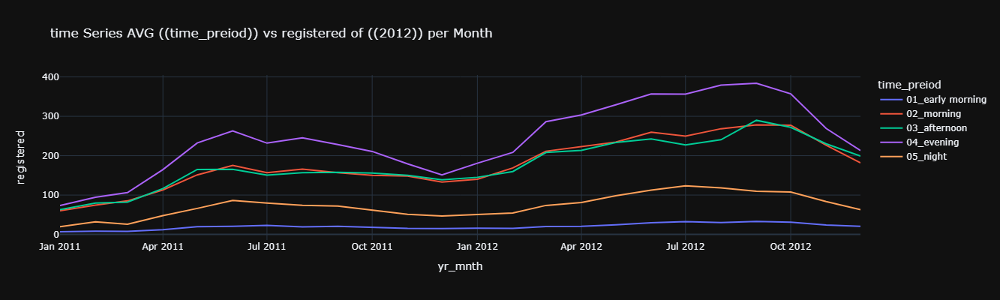

In [247]:
for i in ['weathersit','time_preiod']:
    msk = df.groupby(['yr_mnth',i])[['registered']].mean().reset_index().sort_values(['yr_mnth'])
    px.line(msk , x='yr_mnth' , y='registered',color=i,width=1000,height=400,title=f'time Series AVG (({i})) vs registered of (({x})) per Month',template = 'plotly_dark').show()
    print("")

#### 🔻 `casual rents : time_preiod vs year  per month/year`

In [248]:
df.groupby(['yr','weathersit'])[['casual']].mean().reset_index().sort_values(['yr'])
pd.crosstab(df.weathersit,df.yr,values=df.casual,aggfunc='count').reset_index()

yr,weathersit,2011,2012
0,Clear,5645,5768
1,Heavy Rain,1,2
2,Light Snow,781,638
3,Mist,2218,2326


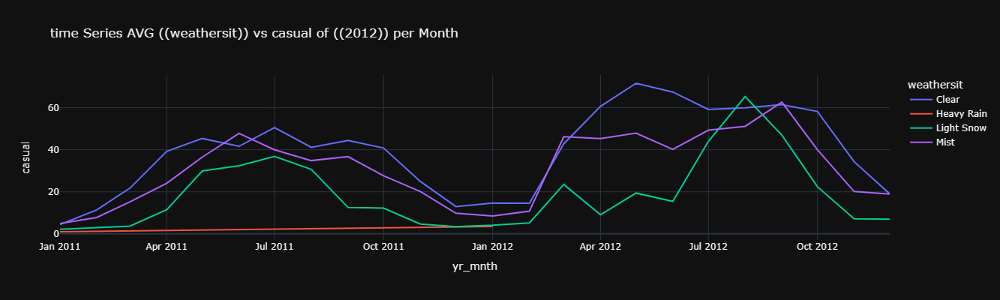

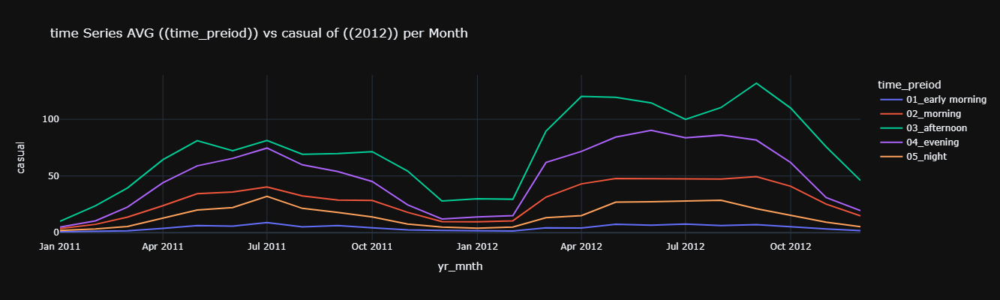

In [249]:
for i in ['weathersit','time_preiod']:
    msk = df.groupby(['yr_mnth',i])[['casual']].mean().reset_index().sort_values(['yr_mnth'])
    px.line(msk , x='yr_mnth' , y='casual',color=i,width=1000,height=400,title=f'time Series AVG (({i})) vs casual of (({x})) per Month',template = 'plotly_dark').show()
    print("")

#### 🔻 `casual rents : time_preiod vs year  per month`

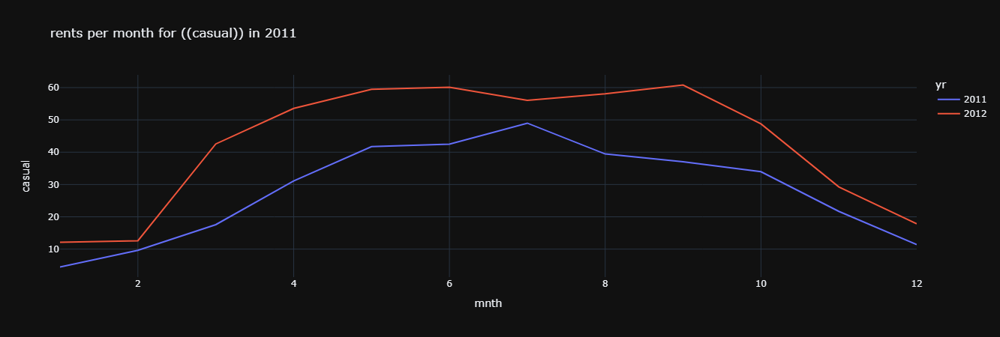

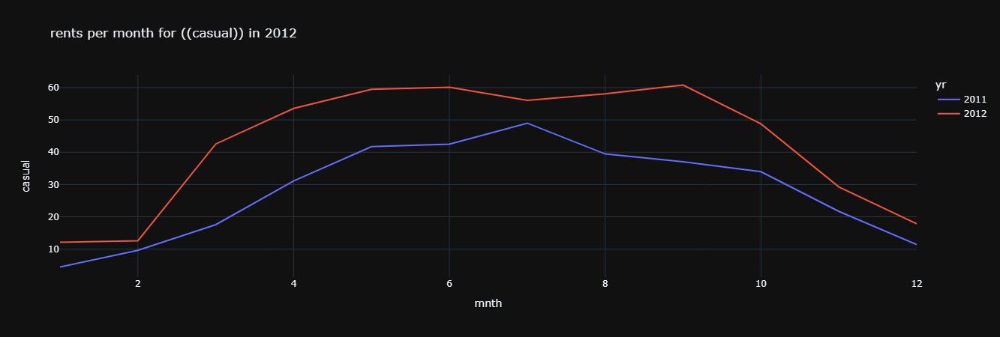

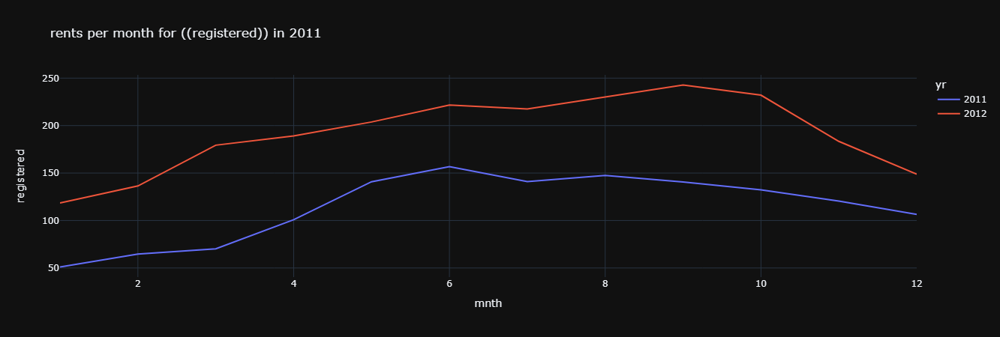

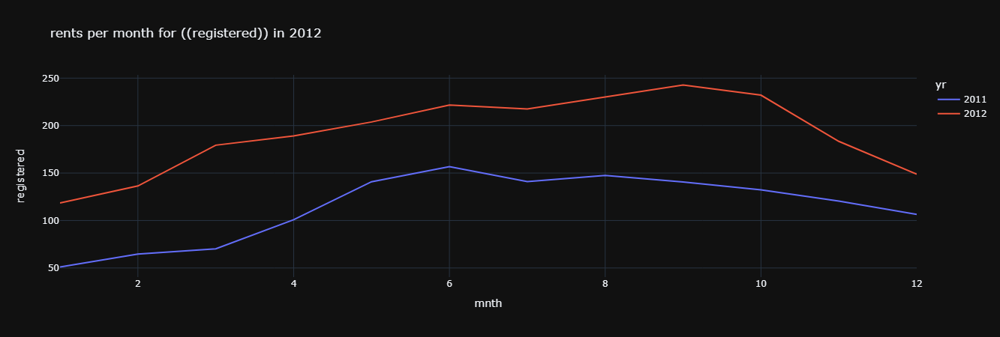

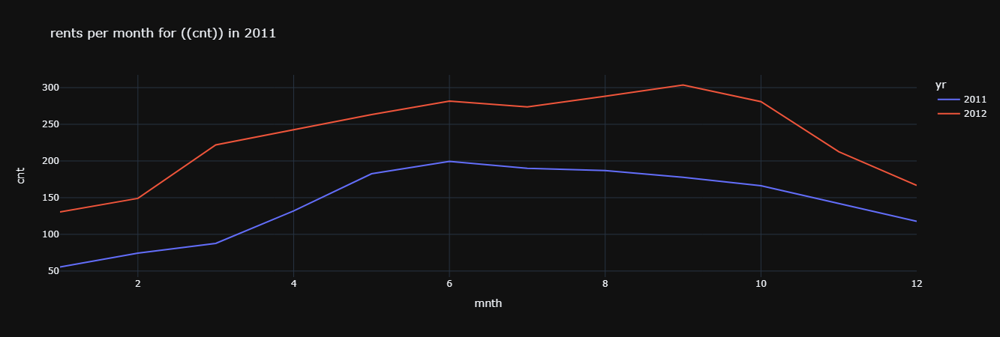

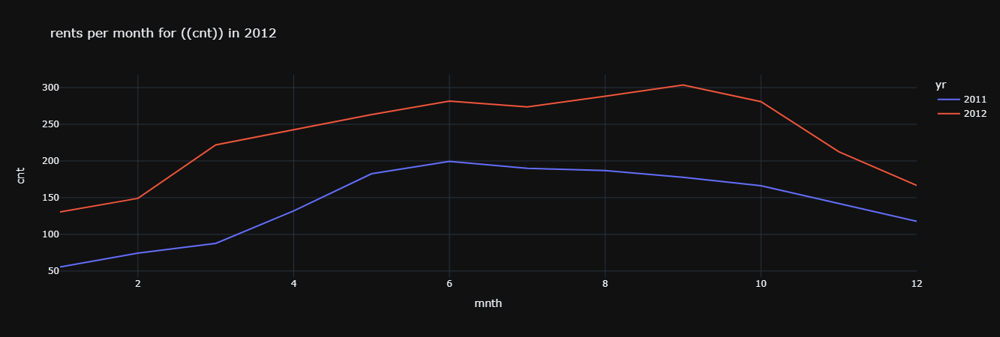

In [250]:
for i in ['casual','registered','cnt']:
    for x in df.yr.unique().tolist():
        msk = df.groupby(['mnth','yr'])[[i]].mean().reset_index().sort_values('mnth')
        px.line(msk , x='mnth' , y=i ,color = 'yr',width=1000,height=450,title=f'rents per month for (({i})) in {x}',template = 'plotly_dark').show()
        print("")

#### 🔻 `casual rents : time_preiod vs year  per hour`

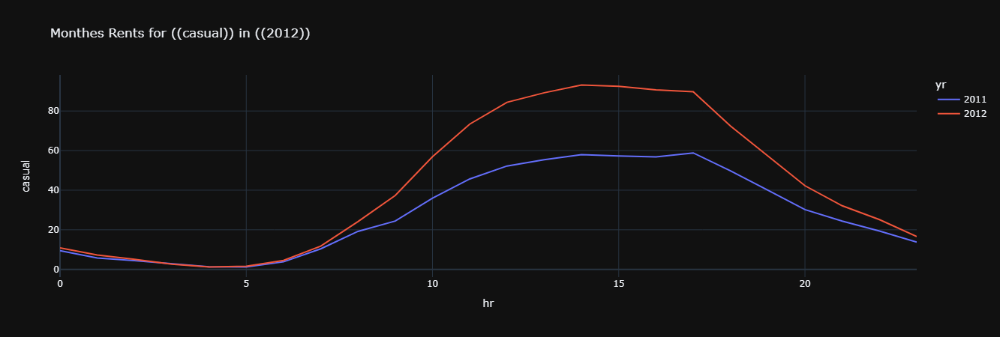

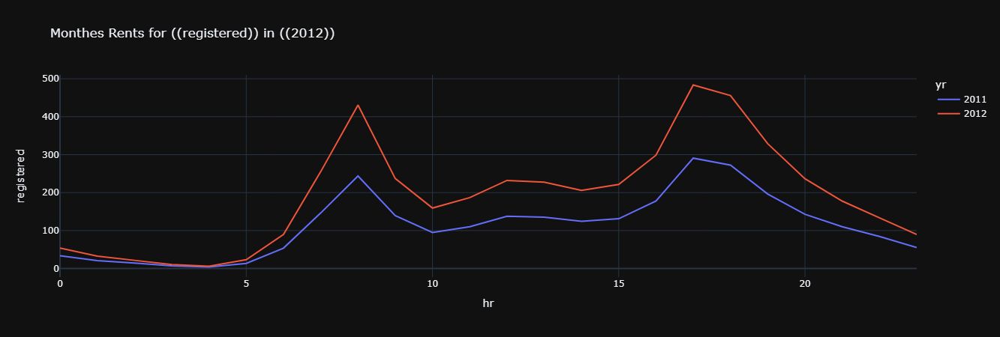

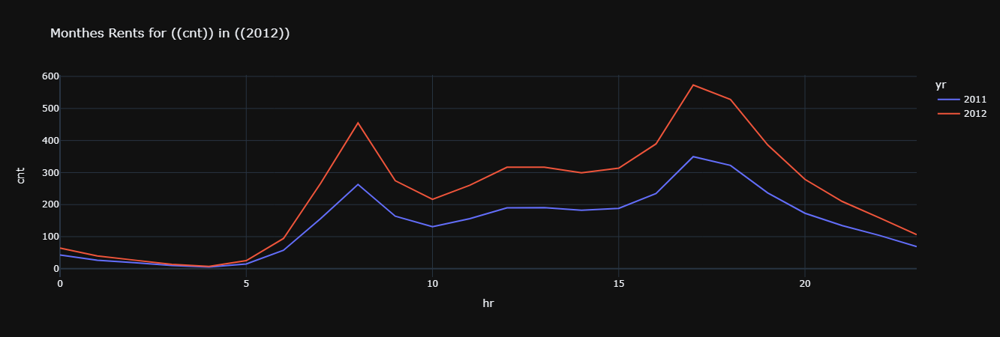

In [251]:
for i in ['casual','registered','cnt']:
    for x in df.yr.unique().tolist()[1::]:
        msk = df.groupby(['hr','yr'])[[i]].mean().reset_index().sort_values('hr')
        px.line(msk , x='hr' , y=i ,color = 'yr',width=1000,height=450,title=f'Monthes Rents for (({i})) in (({x}))',template = 'plotly_dark').show()
        print("")

#### 🔻 `casual rents : time_preiod vs year  per weekday`

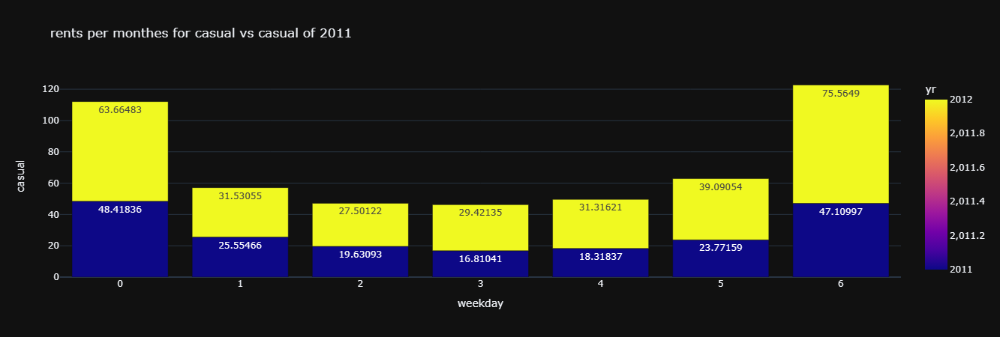

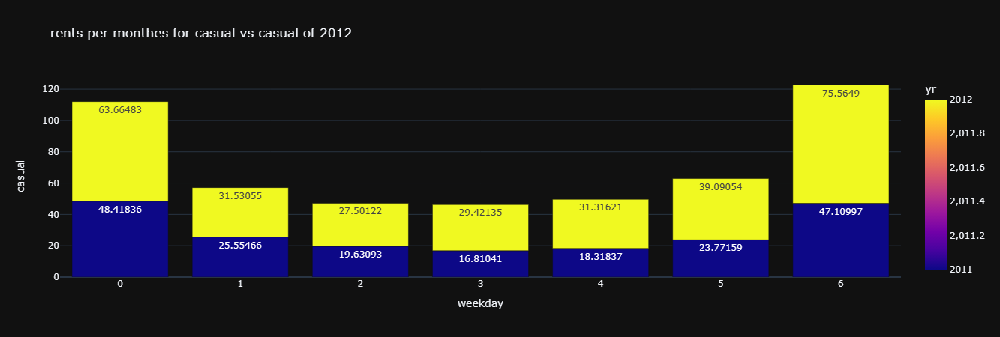

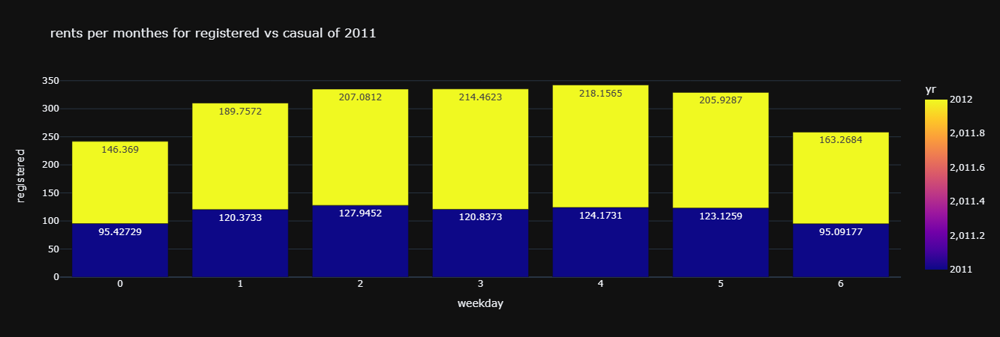

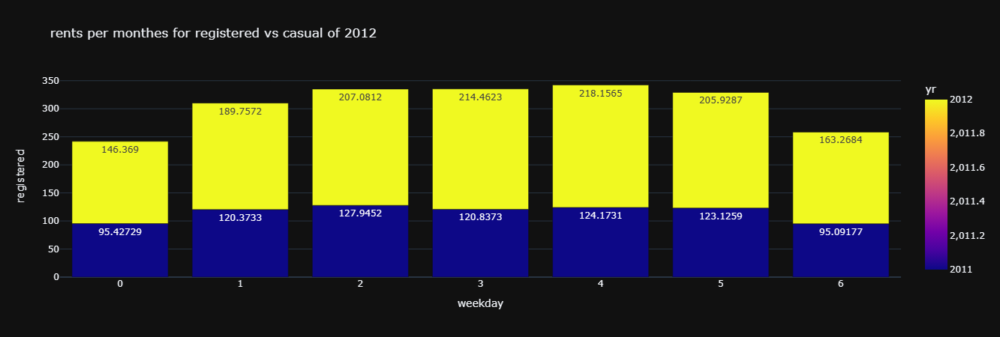

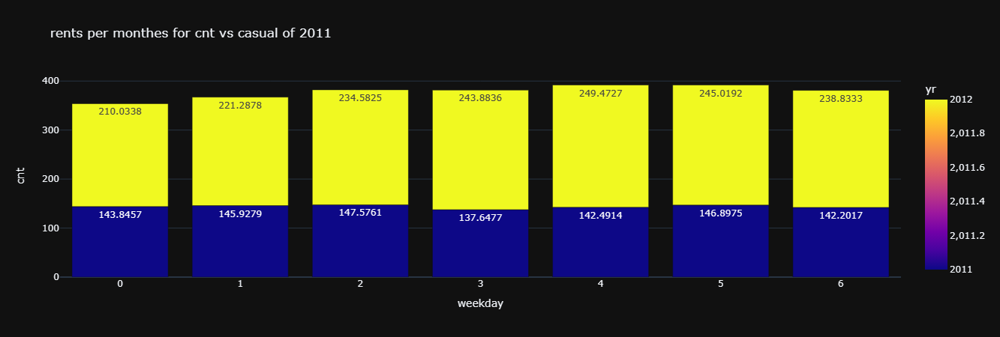

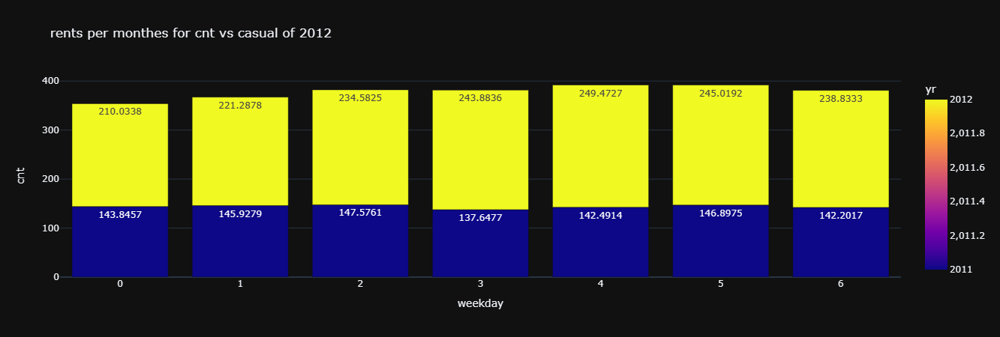

In [252]:
for i in ['casual','registered','cnt']:
    for x in df.yr.unique().tolist():
        msk = df.groupby(['weekday','yr'])[[i]].mean().reset_index().sort_values('weekday')
        px.bar(msk , x='weekday' , y=i ,color = 'yr' , width=1000 , height=450 , title=f'rents per monthes for {i} vs casual of {x}',text_auto=True,template = 'plotly_dark',barmode='group').show()
        print('')

#### 🔻 Month vs Weathersit

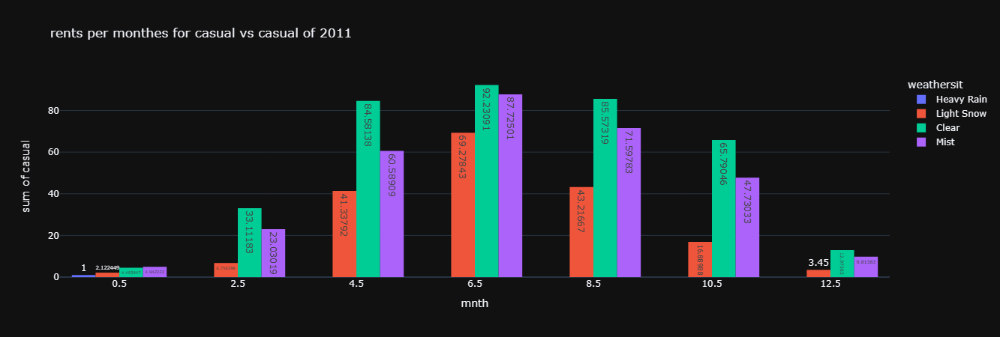

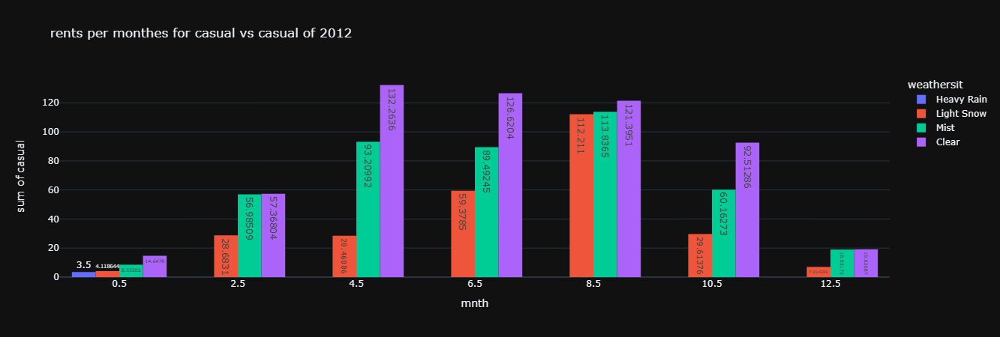

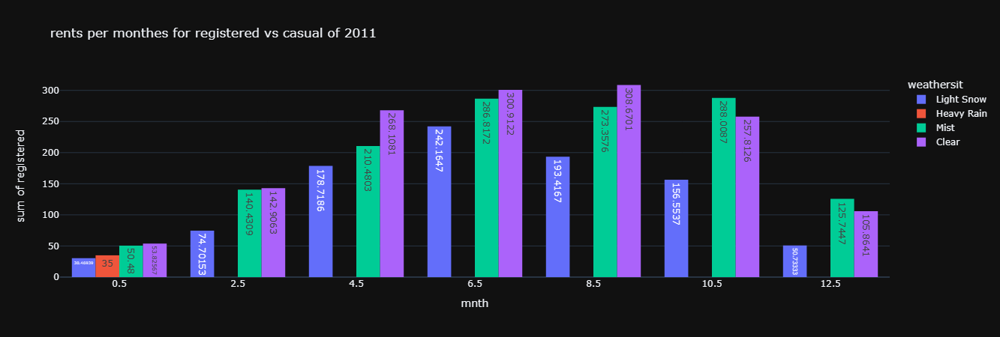

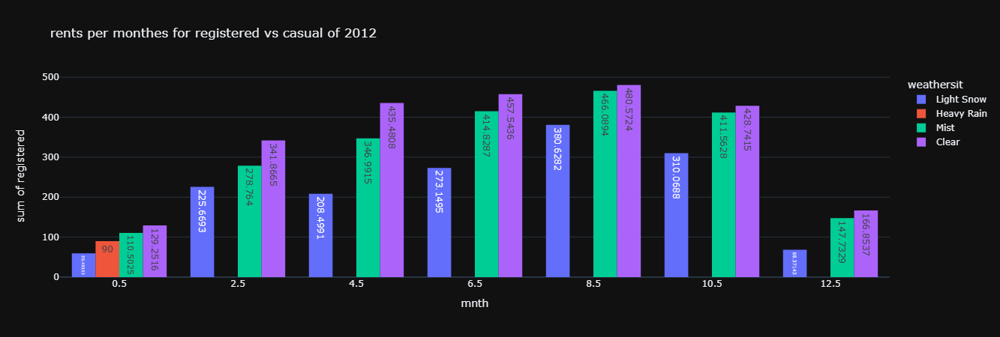

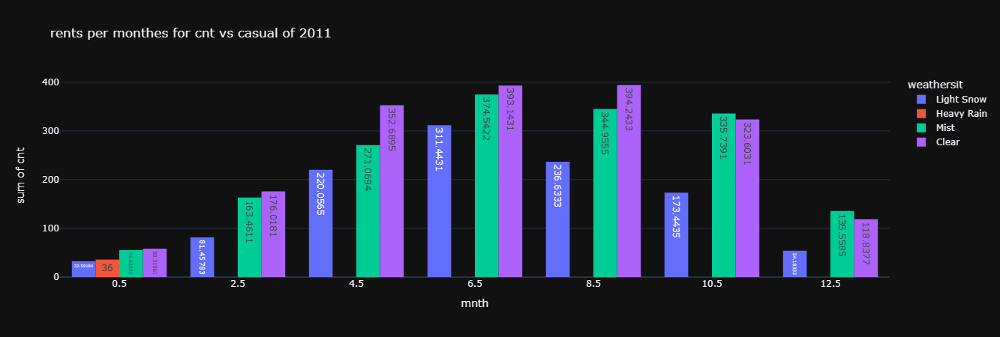

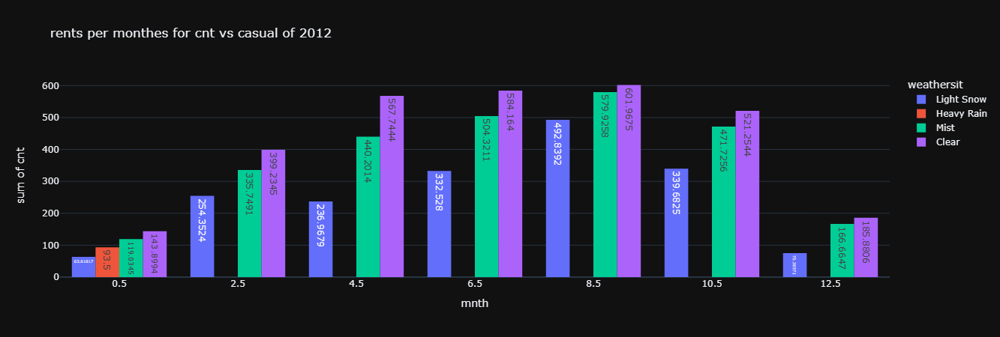

In [253]:
for i in ['casual','registered','cnt']:
    for x in df.yr.unique().tolist():
        msk = df[df.yr == x].groupby(['mnth','yr','weathersit'])[[i]].mean().reset_index().sort_values(i)
        px.histogram(msk , x='mnth' , y=i ,color = 'weathersit',text_auto=True,barmode='group',width=1000,height=450,title=f'rents per monthes for {i} vs casual of {x}',template = 'plotly_dark').show()
        print('')

#### 🔻 Correlation

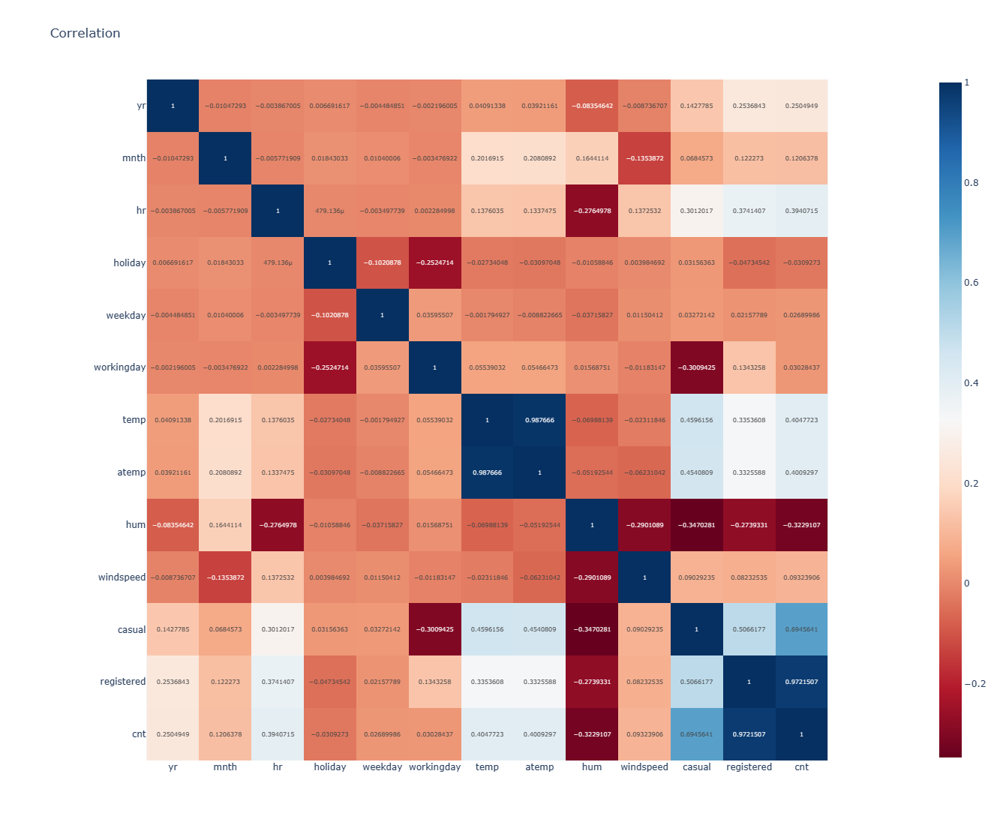

In [254]:
corr = df.select_dtypes(include='number').corr()
px.imshow(corr , width=1100,height=1100,text_auto=True,title='Correlation' , color_continuous_scale='rdbu')

cnt           1.00
registered    0.97
casual        0.69
temp          0.40
atemp         0.40
hr            0.39
yr            0.25
mnth          0.12
windspeed     0.09
workingday    0.03
weekday       0.03
holiday      -0.03
hum          -0.32
Name: cnt, dtype: float64

<Axes: >

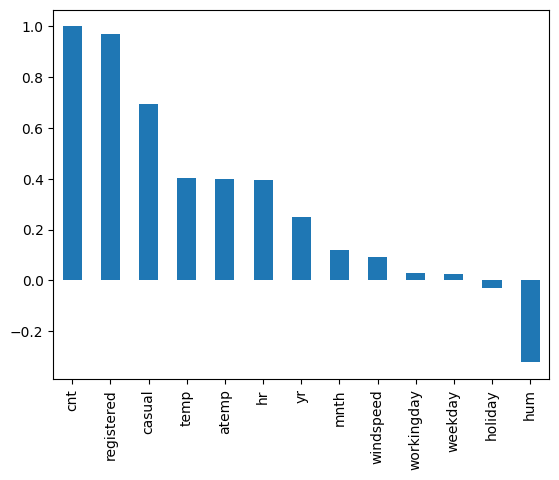

In [255]:
Target_Corr = df.select_dtypes(include='number').corr()['cnt'].sort_values(ascending=False)
display(Target_Corr)
Target_Corr.plot.bar()

#### 🔻 Pairplot

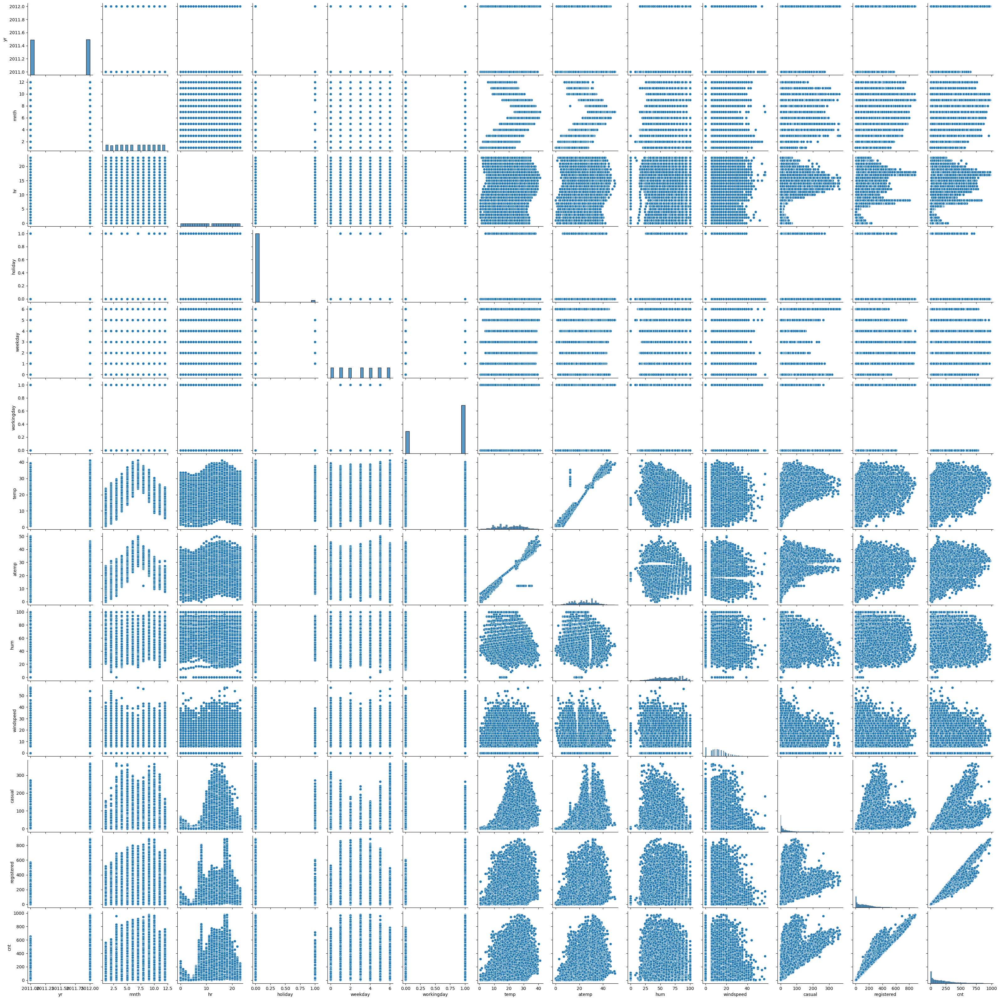

In [256]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
sns.pairplot(df.select_dtypes(include='number'))
plt.show()

#### 🔻 Scatter Plot

In [257]:
df.head(1)

,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,time_preiod,yr_mnth
0,2011-01-01,01_springer,2011,1,0,0,6,0,Clear,9.84,14.39,81.00,0.00,3,13,16,01_early morning,2011-01


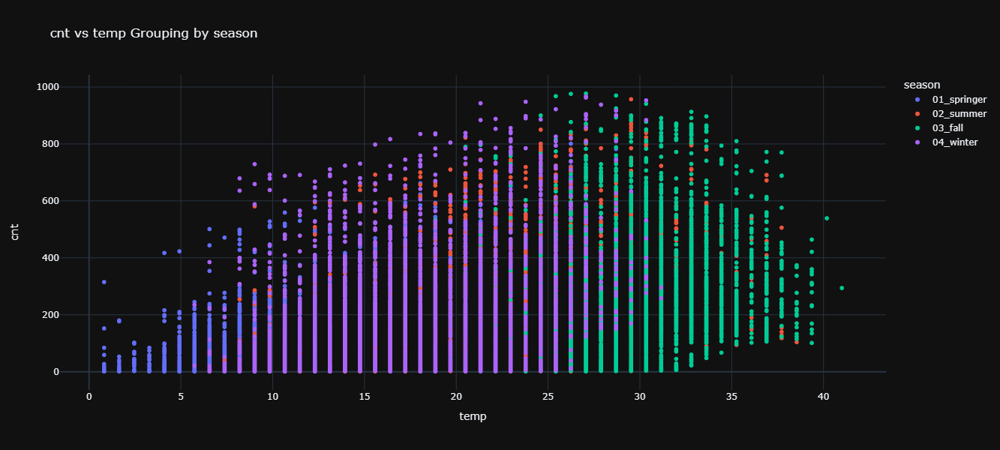

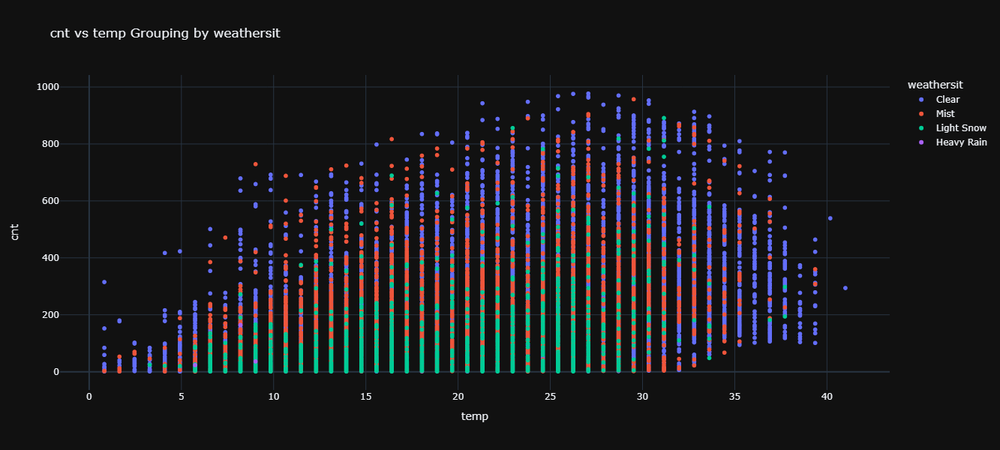

In [ ]:
for i in ['temp', 'atemp','hum', 'windspeed', 'casual', 'registered']:
    for x in ['season','weathersit','time_preiod']:
        px.scatter(df , x=i , y='cnt',color=x ,width=900,height=600,title=f'cnt vs {i} Grouping by {x}',template = 'plotly_dark').show()
        print(" ")

#### 🔻 Mutual_info_score

In [ ]:
import warnings
warnings.filterwarnings("ignore")

from sklearn.metrics import mutual_info_score
def MIS(x):
    return mutual_info_score(x , df.cnt)
df.apply(MIS).sort_values(ascending=False).plot.bar(figsize=(15,5))

In [53]:
# Outliers Detection :
from datasist.structdata import detect_outliers
outliers_dict = {}
for i in df.select_dtypes(include='number').columns:
    outliers_indices = detect_outliers(df, 0, [i])
    outliers_dict[i] = len(outliers_indices)
df_outliers = pd.DataFrame.from_dict(outliers_dict, orient='index', columns=['Outliers']).sort_values('Outliers',ascending=False).reset_index()
Outlier_lst = df_outliers[df_outliers['Outliers'] != 0]
Outlier_lst

,index,Outliers
0,casual,1192
1,registered,680
2,cnt,505
3,holiday,500
4,windspeed,342
5,hum,22


## ✅ Conclusion

* ✔️ From the above graphs we can see that:
- `Overall:` Casual is less than registered in the two years.
    * That can help us in (Operations Capacity, Cost, Budgeting, etc.) Planning to Considerate to increase about 40% to 60% as Casual rate from Register.
* `Daily/Monthly/Yearly Rate.`
    * Seasons: Fall reach 31% of Avg Total Rents, then summer 27%, Then Winter 26%.
    * Than can help us during distribute the Manpower, Costs, and Purchasing Maintenance/Renewals OPS to be in the right time to avoid any disagreement with Customers requirements.
    * Months: Usually Dec & Jan are the low rents, and from May to Oct are the High rents, but from Feb to Apr + Nov are mean.
    * During the High rents Months: Our resources need to be ready to help customers during the season.
    * During the low rents Months: We can use these months to make the necessary maintenance and renovation of assets.
* `Time Period:`
    * High Period : Afternoon for Casual & Evening for Registered.
    * Low Period : Early Morning & Night for Both.
    * That will help us to Distribute our resources & Assets & Products to help customers as per Rents count of High/Low periods.
* `Weather sit:`
    * Customers usually rents during Clear/Mist Weather sit.
    * That will let us should follow the weather update.
* `Week Day & Hourly EDA:`
    * Registered has High Rents during Weekends (Usually be increasing from 7 AM till 10 AM & From 16 PM till 19 PM).
    * Casual has High Rents during Working Days (Usually be increasing from 10 AM till 20 PM).
    * That’s mean: registered Customers may use the bikes during going to Work/School, and Casual may use the bikes for fun/sports.
    * Also this will help us for the distribution type of bikes to help customers and keep satisfaction.

## ✅ Preprocessing

In [103]:
from sklearn.model_selection import train_test_split
import pickle

from sklearn.preprocessing import StandardScaler , OrdinalEncoder , PolynomialFeatures ,RobustScaler
from category_encoders import BinaryEncoder
from sklearn.impute import SimpleImputer

from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression , Ridge , Lasso , ElasticNet
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error , r2_score
from sklearn.neighbors import KNeighborsRegressor

from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor
from xgboost import XGBRegressor

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import cross_val_score

In [22]:
df.head(1)

,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,time_preiod,yr_mnth
0,2011-01-01,01_springer,2011,1,0,0,6,0,Clear,9.84,14.39,81.00,0.00,3,13,16,01_early morning,2011-01


In [161]:
drop_col = ['time_preiod', 'registered','casual','yr','holiday','temp','yr_mnth']
ml_df = df.copy()
ml_df.drop(drop_col , axis=1 , inplace=True)
ml_df.dteday = ml_df.dteday.astype('str')

X = ml_df.drop('cnt' , axis=1)
y = ml_df.cnt

x_train , x_test , y_train , y_test = train_test_split(X , y , test_size=0.2 , random_state=42)

cat = ['season','workingday','mnth','weekday','dteday','hr','weathersit']
num = ['atemp','hum','windspeed']
# ordn = []

num_pipeline = Pipeline ( steps = [("Scaler" , RobustScaler())] )
cat_pipeline = Pipeline ( steps = [("Encoder" , BinaryEncoder(handle_unknown='ignore') )] )
# ord_pipeline = Pipeline ( steps = [("Encoder" , OrdinalEncoder() )] )

# processor = ColumnTransformer(transformers = [('num' , num_pipeline , num) , ('cat' , cat_pipeline , cat) , ('ord' , ord_pipeline , ordn)]).set_output(transform='pandas')
processor = ColumnTransformer(transformers = [('num' , num_pipeline , num) , ('cat' , cat_pipeline , cat)]).set_output(transform='pandas')


import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

x_train_procs = processor.fit_transform(x_train)
x_test_procs = processor.transform(x_test)

processor

ColumnTransformer(transformers=[('num',
                                 Pipeline(steps=[('Scaler', RobustScaler())]),
                                 ['atemp', 'hum', 'windspeed']),
                                ('cat',
                                 Pipeline(steps=[('Encoder',
                                                  BinaryEncoder(handle_unknown='ignore'))]),
                                 ['season', 'workingday', 'mnth', 'weekday',
                                  'dteday', 'hr', 'weathersit'])])

## ✅ Modeling

### ☑️ Linear Regression

In [180]:
# Perform cross-validation
cv_scores = cross_val_score(LR, x_train_procs, y_train)

# Print the cross-validation scores
print('Scores: ', cv_scores)
print('Mean: ', np.mean(cv_scores))
print('Std: ', np.std(cv_scores))

Scores:  [0.36267275 0.31560689 0.35118024 0.34607886 0.35635566]
Mean:  0.34637888075432943
Std:  0.016340653582639263


In [162]:
LR = LinearRegression(fit_intercept=False)
LR.fit(x_train_procs , y_train)
y_pred = LR.predict(x_test_procs)

print("mean_squared_error : ",mean_squared_error(y_test , y_pred))
print("r2_score ",r2_score(y_test , y_pred))
print("train_Score ",LR.score(x_train_procs , y_train))
print("test_Score ",LR.score(x_test_procs , y_test))

mean_squared_error :  20367.248644531104
r2_score  0.35679822920594517
train_Score  0.3451530783067307
test_Score  0.35679822920594517


### ☑️ PolynomialFeatures

In [185]:
# Perform cross-validation
Poly_1 = PolynomialFeatures(degree=3,include_bias=False)
x_train_poly_1 = Poly_1.fit_transform(x_train_procs)
x_test_poly_1 = Poly_1.transform(x_test_procs)

LR_poly = LinearRegression()
LR_poly.fit(x_train_poly , y_train)

cv_scores_poly_1 = cross_val_score(LR_poly, x_train_poly_1, y_train)

# Print the cross-validation scores
print('Scores: ', cv_scores_poly_1)
print('Mean: ', np.mean(cv_scores_poly_1))
print('Std: ', np.std(cv_scores_poly_1))

Scores:  [0.58094393 0.54975954 0.54014319 0.5629839  0.58460962]
Mean:  0.5636880343301162
Std:  0.017229839398790074


In [179]:
Poly = PolynomialFeatures(degree=3,include_bias=False)
x_train_poly = Poly.fit_transform(x_train_procs)
x_test_poly = Poly.transform(x_test_procs)

LR = LinearRegression()
LR.fit(x_train_poly , y_train)
y_pred_poly = LR.predict(x_test_poly)

print("mean_squared_error : ",mean_squared_error(y_test , y_pred_poly))
print("r2_score ",r2_score(y_test , y_pred_poly))
print("train_Score ",LR.score(x_train_poly , y_train))
print("test_Score ",LR.score(x_test_poly , y_test))

mean_squared_error :  13300.497269985672
r2_score  0.5799676458119252
train_Score  0.6876430768905929
test_Score  0.5799676458119252


### ☑️ SVR

In [39]:
# Define the SVR regressor
svr_g = LinearSVR()

# Define the hyperparameters grid to search through
param_grid_svr = {
    'C': [0.1, 1.0, 10.0],  # Regularization parameter
    'epsilon': [0.1, 0.2, 0.3],  # Epsilon parameter
    'tol': [1e-4, 1e-3, 1e-2]  # Tolerance for stopping criteria
}

# Initialize GridSearch
grid_search_svr = GridSearchCV(estimator=svr_g, param_grid=param_grid_svr , cv=3, n_jobs=-1, verbose=2)

# Fit the data to perform the search for best parameters
grid_search_svr.fit(x_train_procs, y_train)

# Output the best parameters found
print("Best Parameters:", grid_search_svr.best_params_)
print("Best Score:", grid_search_svr.best_score_)

Fitting 3 folds for each of 27 candidates, totalling 81 fits
Best Parameters: {'C': 10.0, 'epsilon': 0.1, 'tol': 0.01}
Best Score: 0.3158827474990201


In [192]:
# Perform cross-validation
Lsvr = LinearSVR(C=10 , epsilon=0.1 , tol=0.01)
cv_scores_Lsvr = cross_val_score(Lsvr, x_train_procs, y_train)

# Print the cross-validation scores
print('Scores: ', cv_scores_Lsvr)
print('Mean: ', np.mean(cv_scores_Lsvr))
print('Std: ', np.std(cv_scores_Lsvr))

Scores:  [0.33484062 0.25555612 0.24100654 0.32456022 0.29576787]
Mean:  0.2903462762694317
Std:  0.036944548811377896


In [193]:
from sklearn.svm import LinearSVR
from sklearn.metrics import mean_squared_error, r2_score

Lsvr = LinearSVR()
Lsvr.fit(x_train_procs , y_train)
y_pred_Lsvr = Lsvr.predict(x_test_procs)

print("mean_squared_error : ",mean_squared_error(y_test , y_pred_Lsvr))
print("r2_score ",r2_score(y_test , y_pred_Lsvr))
print("train_Score ",Lsvr.score(x_train_procs , y_train))
print("test_Score ",Lsvr.score(x_test_procs , y_test))

mean_squared_error :  21787.728932638485
r2_score  0.31193917864714293
train_Score  0.2914465550036557
test_Score  0.31193917864714293


### ☑️ KNeighborsRegressor

In [ ]:
for i in range(1,10):
    KNN = KNeighborsRegressor(n_neighbors=i)
    KNN.fit(x_train_procs , y_train)
    y_pred_KNN = KNN.predict(x_test_procs)
    print("✔️ n_neighbors : ",i , '✔️✔️✔️✔️✔️')
    print("✔️ mean_squared_error : ",mean_squared_error(y_test , y_pred_KNN))
    print("✔️ r2_score ",r2_score(y_test , y_pred_KNN))
    print("✔️ train_Score ",KNN.score(x_train_procs , y_train))
    print("✔️ test_Score ",KNN.score(x_test_procs , y_test))
    print("-"*50)

In [ ]:
KNN = KNeighborsRegressor(n_neighbors=3)
KNN.fit(x_train_procs , y_train)
y_pred_KNN = KNN.predict(x_test_procs)

print("✔️ mean_squared_error : ",mean_squared_error(y_test , y_pred_KNN))
print("✔️ r2_score ",r2_score(y_test , y_pred_KNN))
print("✔️ train_Score ",KNN.score(x_train_procs , y_train))
print("✔️ test_Score ",KNN.score(x_test_procs , y_test))

### ☑️ Decission Tree

In [194]:
# Perform cross-validation
DTR = DecisionTreeRegressor(max_depth=20 ,random_state=42 ,ccp_alpha=1.5,splitter="best")
cv_scores_DTR = cross_val_score(DTR, x_train_procs, y_train)

# Print the cross-validation scores
print('Scores: ', cv_scores_DTR)
print('Mean: ', np.mean(cv_scores_DTR))
print('Std: ', np.std(cv_scores_DTR))

Scores:  [0.74508304 0.77705113 0.75298956 0.77795804 0.77779247]
Mean:  0.7661748462155276
Std:  0.014218456740779376


In [195]:
DTR = DecisionTreeRegressor(max_depth=20 ,random_state=42 ,ccp_alpha=1.5,splitter="best")
DTR.fit(x_train_procs , y_train)
y_pred_DTR = DTR.predict(x_test_procs)

print("✔️ mean_squared_error: ", mean_squared_error(y_test , y_pred_DTR))
print("✔️ r2_score: ", r2_score(y_test , y_pred_DTR))
print("✔️ train_Score: ", DTR.score(x_train_procs , y_train))
print("✔️ test_Score: ", DTR.score(x_test_procs , y_test))

✔️ mean_squared_error:  6716.044335757165
✔️ r2_score:  0.7879059815646572
✔️ train_Score:  0.9539897360146814
✔️ test_Score:  0.7879059815646572


### ☑️ RandomForestRegressor

In [48]:
DFR = RandomForestRegressor(n_estimators=100)
DFR.fit(x_train_procs , y_train)
y_pred_DFR = DFR.predict(x_test_procs)

print("✔️ mean_squared_error : ",mean_squared_error(y_test , y_pred_DFR))
print("✔️ r2_score ",r2_score(y_test , y_pred_DFR))
print("✔️ train_Score ",DFR.score(x_train_procs , y_train))
print("✔️ test_Score ",DFR.score(x_test_procs , y_test))

✔️ mean_squared_error :  3819.7814112773303
✔️ r2_score  0.8793705418606208
✔️ train_Score  0.982571982300217
✔️ test_Score  0.8793705418606208


### ☑️ AdaBoostRegressor

In [27]:
AdA = AdaBoostRegressor(n_estimators =100 )
AdA.fit(x_train_procs , y_train)
y_pred_AdA = AdA.predict(x_test_procs)

print("✔️ mean_squared_error : ",mean_squared_error(y_test , y_pred_AdA))
print("✔️ r2_score ",r2_score(y_test , y_pred_AdA))
print("✔️ train_Score ",AdA.score(x_train_procs , y_train))
print("✔️ test_Score ",AdA.score(x_test_procs , y_test))

✔️ mean_squared_error :  12907.871763121873
✔️ r2_score  0.5923668375575181
✔️ train_Score  0.6048798970092866
✔️ test_Score  0.5923668375575181


### ☑️ GradientBoostingRegressor

In [199]:
# Perform cross-validation
GBOR = GradientBoostingRegressor(max_depth=20 , n_estimators=100)
cv_scores_GBOR = cross_val_score(GBOR, x_train_procs, y_train)

# Print the cross-validation scores
print('✔️ Scores: ', cv_scores_GBOR)
print('✔️ Mean: ', np.mean(cv_scores_GBOR))
print('✔️ Std: ', np.std(cv_scores_GBOR))

✔️ Scores:  [0.76182193 0.78042547 0.76935709 0.7908147  0.77387264]
✔️ Mean:  0.775258367399027
✔️ Std:  0.009858819502753094


In [96]:
GBOR = GradientBoostingRegressor(max_depth=20 , n_estimators=100)
GBOR.fit(x_train_procs , y_train)
y_pred_GBOR = GBOR.predict(x_test_procs)

print("✔️ mean_squared_error : ",mean_squared_error(y_test , y_pred_GBOR))
print("✔️ r2_score ",r2_score(y_test , y_pred_GBOR))
print("✔️ train_Score ",GBOR.score(x_train_procs , y_train))
print("✔️ test_Score ",GBOR.score(x_test_procs , y_test))

✔️ mean_squared_error :  6697.948395689182
✔️ r2_score  0.7884774549579983
✔️ train_Score  0.9999999988104704
✔️ test_Score  0.7884774549579983


### ☑️ XGBRegressor

In [89]:
# Define the XGBoost regressor
XGBR = XGBRegressor()

# Define the hyperparameters grid to search through
param_grid = {
    'max_depth': list(range(1,11)),
    'n_estimators': list(range(1,81,10))}

# Initialize GridSearch with cross-validation
grid_search = GridSearchCV(estimator=XGBR, param_grid=param_grid, cv=3, n_jobs=-1, verbose=2)

# Fit the data to perform the search for best parameters
grid_search.fit(x_train_procs, y_train)

# Output the best parameters found
print("Best Parameters:", grid_search.best_params_)
print("Best Score:", grid_search.best_score_)

Fitting 3 folds for each of 80 candidates, totalling 240 fits
Best Parameters: {'max_depth': 7, 'n_estimators': 71}
Best Parameters: 0.9017667393327967


In [196]:
# Perform cross-validation
XGBR = XGBRegressor(max_depth=7 , n_estimators=80 ,random_state=42)
cv_scores_XGBR = cross_val_score(XGBR, x_train_procs, y_train)

# Print the cross-validation scores
print('Scores: ', cv_scores_XGBR)
print('Mean: ', np.mean(cv_scores_XGBR))
print('Std: ', np.std(cv_scores_XGBR))

Scores:  [0.91840117 0.90088231 0.89764342 0.9127764  0.91655452]
Mean:  0.9092515637249867
Std:  0.0084174358152213


In [197]:
XGBR = XGBRegressor(max_depth=7 , n_estimators=80 ,random_state=42)
XGBR.fit(x_train_procs , y_train)
y_pred_XGBR = XGBR.predict(x_test_procs)

print("✔️ mean_squared_error : ",mean_squared_error(y_test , y_pred_XGBR))
print("✔️ r2_score ",r2_score(y_test , y_pred_XGBR))
print("✔️ train_Score ",XGBR.score(x_train_procs , y_train))
print("✔️ test_Score ",XGBR.score(x_test_procs , y_test))

✔️ mean_squared_error :  2768.624862203816
✔️ r2_score  0.9125662751452633
✔️ train_Score  0.9707522710431555
✔️ test_Score  0.9125662751452633


### ☑️ feature_importances_

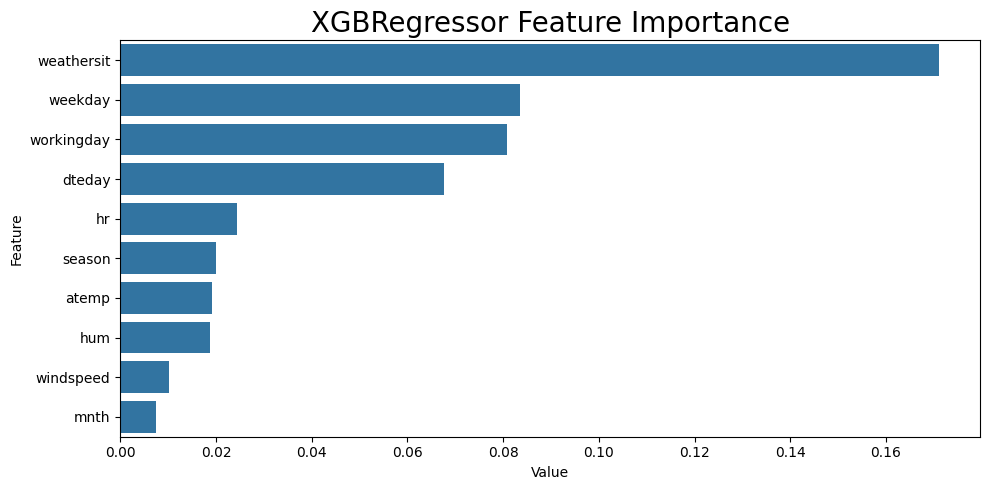

In [106]:
sorted(zip(XGBR.feature_importances_, x_train.columns), reverse=True)
feature_imp = pd.DataFrame(sorted(zip(XGBR.feature_importances_,x_train.columns)), columns=['Value','Feature'])

plt.figure(figsize=(10, 5))
sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value", ascending=False))
plt.title(label= 'XGBRegressor Feature Importance', size = 20)
plt.tight_layout()
plt.show()

## ✅ Deployment

In [107]:
df.to_csv('new_df.csv')

In [108]:
# Process Save
import pickle
pickle.dump(processor, open('processor.pkl', 'wb'))
pickle.dump(XGBR, open('model.pkl', 'wb'))

# Load
pickle.load(open('processor.pkl', 'rb'))
pickle.load(open('model.pkl', 'rb'))

# Preprocess
processor = pickle.load(open('processor.pkl', 'rb'))
XGBR = pickle.load(open('model.pkl', 'rb'))

In [109]:
test = x_test.sample(1)
idx =test.index
actual_count = df.iloc[idx]

N_test = processor.transform(test)
Test_Price = XGBR.predict(N_test)

display(test)
display(actual_count)
print("Predicted Count" , Test_Price)

,dteday,season,mnth,hr,weekday,workingday,weathersit,atemp,hum,windspeed
16593,2012-11-29,04_winter,11,4,4,1,Clear,11.37,75.00,6.00


,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,time_preiod,yr_mnth
16593,2012-11-29,04_winter,2012,11,4,0,4,1,Clear,8.20,11.37,75.00,6.00,0,7,7,01_early morning,2012-11


Predicted Count [8.133722]


In [110]:
# Save data
data = {
    "Date":[],
    "season":df.season.unique().tolist(),
    "Month":df.mnth.unique().tolist(),
    "Weekday":sorted(df.weekday.unique().tolist()),
    "Hour":list(range(0,24,1)),
    # "Holiday":df.holiday.unique().tolist(),
    "Workingday":df.workingday.unique().tolist(),
    "weathersit":['Clear', 'Mist', 'Light Snow', 'Heavy Rain'],
    "Temp":list(range(int(df.temp.min()) , int(df.temp.max()))),
    "Atemp":list(range(int(df.atemp.min()) , int(df.atemp.max()))),
    "Hum":list(range(int(df.hum.min()) , int(df.hum.max()))),
    "Windspeed":list(range(int(df.windspeed.min()) , int(df.windspeed.max())))
}

pickle.dump(data, open('Deployment_data.pkl', 'wb'))

### ☑️ Streamlit

In [118]:
%%writefile app.py
import streamlit as st
import pandas as pd
import numpy as np
import pickle
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler , OrdinalEncoder , PolynomialFeatures ,RobustScaler
from category_encoders import BinaryEncoder
from sklearn.impute import SimpleImputer
from sklearn.metrics import mean_squared_error , r2_score
from xgboost import XGBRegressor
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
import plotly.express as px
pd.options.display.float_format = '{:,.2f}'.format
# Read Data
# _______________________________________________________________________________________________________________________________________________________________________________________________________
df_new = pd.read_csv('new_df.csv',index_col=0)
pd.options.display.float_format ='{:,.2f}'.format
st.set_page_config (page_title = 'Bike Sharing Prediction (Per Houre) 🚲' , layout = "wide" , page_icon = '📊 🚲')
st.title("Bike Sharing Prediction (Per Houre) 🚲")

# Sidebar
brief = st.sidebar.checkbox(":red[Brief about Project]")
Planning = st.sidebar.checkbox(":orange[About Project]")
About_me = st.sidebar.checkbox(":green[About me]")

if brief:
    st.sidebar.header(":red[Brief about Project]")
    st.sidebar.write("""
    * Bike sharing systems are new generation of traditional bike rentals where whole process from membership
      rental and return back has become automatic. 
      Through these systems, user is able to easily rent a bike from a particular position and return back at another position. 
      Currently, there are about over 500 bike-sharing programs around the world which is composed of over 500 thousands bicycles. 
      Bike-sharing programs are becoming more and more popular in recent Today,.
    * :red[So let us see the insights 👀.]
    """)
# ______________________________________________________________________________________________________________________________________________________________________________________________________

if Planning :
    st.sidebar.header(":orange[About Project]")
    st.sidebar.subheader ('BIKE SHARING Prediction Per Houre 📊')
    st.sidebar.write("""
    * This is my Final Project during my Data Science Diploma @Epsilon AI. 
    * In this Project we have 3 Tabes: ('Expolration🔎','Insight💡' , 'Prediction 👨‍👩‍👦‍👦').

    * Data Source:
        1) mendeley : https://archive.ics.uci.edu/dataset/275/bike+sharing+dataset
        2) Kaggle : https://www.kaggle.com/datasets/lakshmi25npathi/bike-sharing-dataset
    """)
    st.sidebar.write("""
    * Data Details:
        * Columns : 16 Features
        * Instance : 17379 Operations
    """)
# ______________________________________________________________________________________________________________________________________________________________________________________________________

if About_me :
    st.sidebar.header(":green[About me]")
    st.sidebar.write("""
    - Osama SAAD
    - Student : Data Scaience & Machine Learning  @Epsilon AI
    - Infor ERP (EAM/M3) key Business.User | Infor DMS, Assets and System Control Supervisor @ Ibnsina Pharma
    - LinkedIn: 
        https://www.linkedin.com/in/ossama-ahmed-saad-525785b2
    - Github : 
        https://github.com/OsamaSamnudi
    """)
# ______________________________________________________________________________________________________________________________________________________________________________________________________

# Tabs
Exploration , Insight , Custom_EDA , Prediction  = st.tabs(['Exploration 🔎','Insight 💡' , 'Custom EDA for User👨‍👩‍👦‍👦' , 'Prediction 📈'])
with Exploration:
    with st.container():
        st.header('Exploration🔎')
        About_Data = st.checkbox(":blue[🔻 About Data]")
        if About_Data:
            st.write("""
            - instant: record index
            - dteday : date
            - season : season (1 = springer & 2 = summer & 3 = fall & 4 = winter)
            - yr : year (0 = 2011 & 1 = 2012)
            - mnth : month ( 1 to 12)
            - hr : hour (0 to 23)
            - holiday : weather day is holiday or not (extracted from http://dchr.dc.gov/page/holiday-schedule)
            - weekday : day of the week
            - workingday : if day is neither weekend nor holiday is 1, otherwise is 0.
            - weathersit :
                - 1) Clear, Few clouds, Partly cloudy, Partly cloudy
                - 2) Mist + Cloudy, Mist + Broken clouds, Mist + Few clouds, Mist
                - 3) Light Snow, Light Rain + Thunderstorm + Scattered clouds, Light Rain + Scattered clouds
                - 4) Heavy Rain + Ice Pallets + Thunderstorm + Mist, Snow + Fog
            - temp : Normalized temperature in Celsius. The values are divided to 41 (max)
            - atemp: Normalized feeling temperature in Celsius. The values are divided to 50 (max)
            - hum: Normalized humidity. The values are divided to 100 (max)
            - windspeed: Normalized wind speed. The values are divided to 67 (max)
            - casual: count of casual users
            - registered: count of registered users
            - cnt: count of total rental bikes including both casual and registered
            """)
        Data_Sample = st.checkbox(":blue[🔻 Data_Sample]")
        if About_Data:
            st.dataframe(data= df_new.sample(10), use_container_width=False)
#########################################################################################################################################
        Correlation = st.checkbox(":blue[🔻 Correlation]")
        if Correlation: 
            corr = df_new.select_dtypes(include='number').corr()
            IMSHOW = px.imshow(corr , width=1100,height=1100,text_auto=True,title='Correlation' , color_continuous_scale='rdbu')
            st.plotly_chart(IMSHOW , use_container_width=True,theme="streamlit")
#########################################################################################################################################
        Distribution = st.checkbox(":blue[🔻 Distribution]")
        if Distribution:
            st.subheader('✔️ Distribution of Numerical Features : temp , atemp , hum , windspeed , casual , registered , cnt')
####################################################
            col_1 , col_2 = st.columns([10 , 10])
            with col_1:
                st.markdown('✔️ temp Distribution :')
                fig_1 = px.histogram(df_new , x = 'temp'  , text_auto=True , marginal='box')
                st.plotly_chart(fig_1 , use_container_width=True,theme="streamlit")
            with col_2:
                st.markdown('✔️ atemp Distribution :')
                fig_2 = px.histogram(df_new , x = 'atemp' , text_auto=True , marginal='box')
                st.plotly_chart(fig_2 , use_container_width=True,theme="streamlit")
####################################################
            col_3 , col_4 = st.columns([10 , 10])
            with col_3:
                st.markdown('✔️ hum Distribution :')
                fig_3 = px.histogram(df_new , x = 'hum', text_auto=True , marginal='box')
                st.plotly_chart(fig_3 , use_container_width=True,theme="streamlit")
            with col_4:
                st.markdown('✔️ windspeed Distribution :')
                fig_4 = px.histogram(df_new , x = 'windspeed', text_auto=True , marginal='box')
                st.plotly_chart(fig_4 , use_container_width=True,theme="streamlit")
####################################################
            col_5 , col_6 = st.columns([10 , 10])
            with col_5:
                st.markdown('✔️ casual Distribution :')
                fig_5 = px.histogram(df_new , x = 'casual' , text_auto=True , marginal='box')
                st.plotly_chart(fig_5 , use_container_width=True,theme="streamlit")
            with col_6:
                st.markdown('✔️ registered Distribution :')
                fig_6 = px.histogram(df_new , x = 'registered' , text_auto=True , marginal='box')
                st.plotly_chart(fig_6 , use_container_width=True,theme="streamlit")
####################################################
            st.markdown('✔️✔️ Finally Distribution ofTarget : cnt (Count of Rentals)')
            fig_7 = px.histogram(df_new , x = 'cnt' , text_auto=True , marginal='box')
            st.plotly_chart(fig_7 , use_container_width=True,theme="streamlit")
#########################################################################################################################################
        Scatter = st.checkbox(":blue[🔻 Scatter]")
        if Scatter:
            st.subheader('✔️ Scatter for : casual , registered , cnt (vs) season , weathersit , time_preiod')
####################################################
            col_8 , col_9 , col_10 = st.columns([10 , 10 , 10])
            with col_8:
                st.markdown('✔️ (cnt) vs (casual) Grouping_by [season]')
                fig_8 = px.scatter(df_new , x = 'casual' , y = 'cnt' , color = 'season')
                st.plotly_chart(fig_8 , use_container_width=True,theme="streamlit")
            with col_9:
                st.markdown('✔️ (cnt) vs (casual) Grouping_by [weathersit]')
                fig_9 = px.scatter(df_new , x = 'casual' , y = 'cnt' , color = 'weathersit')
                st.plotly_chart(fig_9 , use_container_width=True,theme="streamlit")
            with col_10:
                st.markdown('✔️ (cnt) vs (casual) Grouping_by [time_preiod]')
                fig_10 = px.scatter(df_new , x = 'casual' , y = 'cnt' , color = 'time_preiod')
                st.plotly_chart(fig_10 , use_container_width=True,theme="streamlit")
####################################################
            col_11 , col_12 , col_13= st.columns([10 , 10 , 10])
            with col_11:
                st.markdown('✔️ (cnt) vs (registered) Grouping_by [season]')
                fig_11 = px.scatter(df_new , x = 'registered' , y = 'cnt' , color = 'season')
                st.plotly_chart(fig_11 , use_container_width=True,theme="streamlit")
            with col_12:
                st.markdown('✔️ (cnt) vs (registered) Grouping_by [weathersit]')
                fig_12 = px.scatter(df_new , x = 'registered' , y = 'cnt' , color = 'weathersit')
                st.plotly_chart(fig_12 , use_container_width=True,theme="streamlit")
            with col_13:
                st.markdown('✔️ (cnt) vs (registered) Grouping_by [time_preiod]')
                fig_13 = px.scatter(df_new , x = 'registered' , y = 'cnt' , color = 'time_preiod')
                st.plotly_chart(fig_13 , use_container_width=True,theme="streamlit")

# ______________________________________________________________________________________________________________________________________________________________________________________________________
with Insight:
    with st.container():
        st.subheader("🚩 DATA UNDERSTANDING & INSIGHTS...")
        Totals_Report = []
        for i in ['sum','mean','count']:
            Totals = {'name':['casual' , 'registered' , 'cnt'],
                '2011':[df_new[(df_new.yr == 2011) & (df_new.casual != 0)].casual.agg(i).round(2), 
                        df_new[(df_new.yr == 2011) & (df_new.registered != 0)].registered.agg(i).round(2),
                        df_new[(df_new.yr == 2011) & (df_new.cnt != 0)].cnt.agg(i).round(2) ] ,
                '2012':[df_new[(df_new.yr == 2012) & (df_new.casual != 0)].casual.agg(i).round(2), 
                        df_new[(df_new.yr == 2012) & (df_new.registered != 0)].registered.agg(i).round(2),
                        df_new[(df_new.yr == 2012) & (df_new.cnt != 0)].cnt.agg(i).round(2)] }
            Totals_Report.append(Totals)
        # DataFrames
        Totals_Report_sum = pd.DataFrame(Totals_Report[0])
        Totals_Report_avg = pd.DataFrame(Totals_Report[1]) 
        Totals_Report_count = pd.DataFrame(Totals_Report[2]) 
    col_i_1 , col_i_2 , col_i_3 = st.columns([40 , 40 , 40])
    with col_i_1:
        st.write('✔️ Total Rents')
        fig_S = px.histogram(Totals_Report_sum,x='name',y=['2011','2012'],barmode='group',text_auto=True,width=900,height=500,
                 title = f'Total of Casual, Registred, cnt')
        st.plotly_chart(fig_S , use_container_width=True,theme="streamlit")
    with col_i_2:
        st.write('✔️ Avg Rents')
        fig_V = px.histogram(Totals_Report_avg,x='name',y=['2011','2012'],barmode='group',text_auto=True,width=900,height=500,
                 title = f'Avg of Casual, Registred, cnt')
        st.plotly_chart(fig_V , use_container_width=True,theme="streamlit")
    with col_i_3:
        st.write('✔️ Count Rents')
        fig_C = px.histogram(Totals_Report_count,x='name',y=['2011','2012'],barmode='group',text_auto=True,width=900,height=500,
                 title = f'Count of Casual, Registred, cnt')
        st.plotly_chart(fig_C , use_container_width=True,theme="streamlit")

    with st.container():
        st.write("✔️ avg (registered, casual, cnt) per year")
        col_i_1 , col_i_2 , col_i_3 = st.columns([30 , 30 , 30])
        with col_i_1:
            msk = df_new.groupby(['yr']).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.pie(msk , names = 'yr' , values = 'casual',title = 'avg (casual) per year' ).update_traces(textinfo='percent+value')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_2:
            msk_15 = df_new.groupby(['yr']).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig_15 = px.pie(msk_15 , names = 'yr' , values = 'registered',title = 'avg (registered) per year' ).update_traces(textinfo='percent+value')
            st.plotly_chart(fig_15 , use_container_width=True,theme="streamlit")
        with col_i_3:
            msk = df_new.groupby(['yr']).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.pie(msk , names = 'yr' , values = 'cnt' ,title = 'avg (cnt) per year' ).update_traces(textinfo='percent+value')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
    with st.container():
        st.write("✔️ avg (registered, casual, cnt) per season")
        col_i_1 , col_i_2 , col_i_3 = st.columns([30 , 30 , 30])
        with col_i_1:
            Var = 'season'
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.pie(msk , names = Var , values = 'casual',title = f'avg (casual) per {Var}' ).update_traces(textinfo='percent+value')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_2:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.pie(msk , names = Var , values = 'registered',title = f'avg (registered) per {Var}' ).update_traces(textinfo='percent+value')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.pie(msk , names = Var , values = 'cnt' ,title = f'avg (cnt) per {Var}' ).update_traces(textinfo='percent+value')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
    with st.container():
        st.write("✔️ avg (registered, casual, cnt) per mnth")
        col_i_1 , col_i_2 , col_i_3 = st.columns([30 , 30 , 30])
        with col_i_1:
            Var = 'mnth'
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'casual',title = f'avg (casual) per {Var}',text_auto=True,color='casual')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_2:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'registered',title = f'avg (registered) per {Var}',text_auto=True,color='registered')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'cnt' ,title = f'avg (cnt) per {Var}',text_auto=True,color='cnt')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
    with st.container():
        st.write("✔️ avg (registered, casual, cnt) per time_preiod")
        col_i_1 , col_i_2 , col_i_3 = st.columns([30 , 30 , 30])
        with col_i_1:
            Var = 'time_preiod'
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'casual',title = f'avg (casual) per {Var}',text_auto=True,color='casual')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_2:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'registered',title = f'avg (registered) per {Var}',text_auto=True,color='registered')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'cnt' ,title = f'avg (cnt) per {Var}',text_auto=True,color='cnt')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")         
    with st.container():
        st.write("✔️ avg (registered, casual, cnt) per weathersit")
        col_i_1 , col_i_2 , col_i_3 = st.columns([30 , 30 , 30])
        with col_i_1:
            Var = 'weathersit'
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'casual',title = f'avg (casual) per {Var}',text_auto=True,color='casual')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_2:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'registered',title = f'avg (registered) per {Var}',text_auto=True,color='registered')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'cnt' ,title = f'avg (cnt) per {Var}',text_auto=True,color='cnt')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")        
    with st.container():
        st.write("✔️ avg (registered, casual, cnt) per weekday")
        col_i_1 , col_i_2 , col_i_3 = st.columns([30 , 30 , 30])
        with col_i_1:
            Var = 'weekday'
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'casual',title = f'avg (casual) per {Var}',text_auto=True,color='casual')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_2:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'registered',title = f'avg (registered) per {Var}',text_auto=True,color='registered')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'cnt' ,title = f'avg (cnt) per {Var}',text_auto=True,color='cnt')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
    with st.container():
        st.write("✔️ avg (registered, casual, cnt) per hour")
        col_i_1 , col_i_2 , col_i_3 = st.columns([30 , 30 , 30])
        with col_i_1:
            Var = 'hr'
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'casual',title = f'avg (casual) per {Var}',text_auto=True,color='casual')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_2:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'registered',title = f'avg (registered) per {Var}',text_auto=True,color='registered')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'cnt' ,title = f'avg (cnt) per {Var}',text_auto=True,color='cnt')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
    with st.container():
        st.write("✔️ avg (registered, casual, cnt) per workingday")
        col_i_1 , col_i_2 , col_i_3 = st.columns([30 , 30 , 30])
        with col_i_1:
            Var = 'workingday'
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'casual',title = f'avg (casual) per {Var}',text_auto=True,color='casual')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_2:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'registered',title = f'avg (registered) per {Var}',text_auto=True,color='registered')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'cnt' ,title = f'avg (cnt) per {Var}',text_auto=True,color='cnt')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
    with st.container():
        st.write("✔️ avg (registered, casual, cnt) per holiday")
        col_i_1 , col_i_2 , col_i_3 = st.columns([30 , 30 , 30])
        with col_i_1:
            Var = 'holiday'
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'casual',title = f'avg (casual) per {Var}',text_auto=True,color='casual')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_2:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'registered',title = f'avg (registered) per {Var}',text_auto=True,color='registered')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            msk = df_new.groupby([Var]).agg({'casual':'mean' , 'registered':'mean', 'cnt':'mean'}).reset_index()
            fig = px.bar(msk , x = Var , y = 'cnt' ,title = f'avg (cnt) per {Var}',text_auto=True,color='cnt')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")  
    # weathersit
    with st.container():
        col_i_1 , col_i_2 , col_i_3 = st.columns([40 , 1 , 40])
        with col_i_1:
            color = 'weathersit'
            msk = df_new[df_new.yr == 2011].groupby(['yr_mnth','weathersit','season','time_preiod','weekday','holiday','mnth']).cnt.mean().reset_index()
            fig = px.histogram(msk,y="cnt",x="yr_mnth",color=color,barmode= 'group',title=f'cnt per month per ({color}) in 2011',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            color = 'weathersit'
            msk = df_new[df_new.yr == 2012].groupby(['yr_mnth','weathersit','season','time_preiod','weekday','holiday','mnth']).cnt.mean().reset_index()
            fig = px.histogram(msk,y="cnt",x="yr_mnth",color=color,barmode= 'group',title=f'cnt per month per ({color}) in 2012',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
    # season
    with st.container():
        col_i_1 , col_i_2 , col_i_3 = st.columns([40 , 1 , 40])
        with col_i_1:
            color = 'season'
            msk = df_new[df_new.yr == 2011].groupby(['yr_mnth','weathersit','season','time_preiod','weekday','holiday','mnth']).cnt.mean().reset_index()
            fig = px.histogram(msk,y="cnt",x="yr_mnth",color=color,barmode= 'group',title=f'cnt per month per ({color}) in 2011',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            color = 'season'
            msk = df_new[df_new.yr == 2012].groupby(['yr_mnth','weathersit','season','time_preiod','weekday','holiday','mnth']).cnt.mean().reset_index()
            fig = px.histogram(msk,y="cnt",x="yr_mnth",color=color,barmode= 'group',title=f'cnt per month per ({color}) in 2012',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
    # time_preiod
    with st.container():
        col_i_1 , col_i_2 , col_i_3 = st.columns([40 , 1 , 40])
        with col_i_1:
            color = 'time_preiod'
            msk = df_new[df_new.yr == 2011].groupby(['yr_mnth','weathersit','season','time_preiod','weekday','holiday','mnth']).cnt.mean().reset_index()
            fig = px.histogram(msk,y="cnt",x="yr_mnth",color=color,barmode= 'group',title=f'cnt per month per ({color}) in 2011',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            color = 'time_preiod'
            msk = df_new[df_new.yr == 2012].groupby(['yr_mnth','weathersit','season','time_preiod','weekday','holiday','mnth']).cnt.mean().reset_index()
            fig = px.histogram(msk,y="cnt",x="yr_mnth",color=color,barmode= 'group',title=f'cnt per month per ({color}) in 2012',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
            
    with st.container():
        st.subheader("📌 TARGET EXPLORATION & INSIGHTS...")
        col_i_1 , col_i_2 , col_i_3 = st.columns([40 , 1 , 40])
        with col_i_1:
            Var = 'yr'
            msk = df_new.groupby([Var,'workingday'])['cnt'].mean().reset_index()
            fig = px.histogram(msk,y="cnt",x=Var,color='workingday',barmode= 'group',title=f'AVG Rental Count of (({Var})) Grouping By (workingday flag)',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            Var_1 = 'season'
            msk = df_new.groupby([Var_1,'workingday'])['cnt'].mean().reset_index()
            fig = px.histogram(msk,y="cnt",x=Var_1,color='workingday',barmode= 'group',title=f'AVG Rental Count of (({Var_1})) Grouping By (workingday flag)',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        
    with st.container():
        col_i_1 , col_i_2 , col_i_3 = st.columns([40 , 1 , 40])
        with col_i_1:
            Var = 'mnth'
            msk = df_new.groupby([Var,'workingday'])['cnt'].mean().reset_index()
            fig = px.histogram(msk,y="cnt",x=Var,color='workingday',barmode= 'group',title=f'AVG Rental Count of (({Var})) Grouping By (workingday flag)',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            Var_1 = 'weekday'
            msk = df_new.groupby([Var_1,'workingday'])['cnt'].mean().reset_index()
            fig = px.bar(msk,y="cnt",x=Var_1,color='workingday',title=f'AVG Rental Count of (({Var_1})) Grouping By (workingday flag)',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
    with st.container():
        col_i_1 , col_i_2 , col_i_3 = st.columns([40 , 1 , 40])
        with col_i_1:
            Var = 'time_preiod'
            msk = df_new.groupby([Var,'workingday'])['cnt'].mean().reset_index()
            fig = px.histogram(msk,y="cnt",x=Var,color='workingday',barmode= 'group',title=f'AVG Rental Count of (({Var})) Grouping By (workingday flag)',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
        with col_i_3:
            Var_1 = 'weathersit'
            msk = df_new.groupby([Var_1,'workingday'])['cnt'].mean().reset_index()
            fig = px.histogram(msk,y="cnt",x=Var_1,color='workingday',barmode= 'group',title=f'AVG Rental Count of (({Var_1})) Grouping By (workingday flag)',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")    
    with st.container():
        col_i_1 , col_i_2 , col_i_3 = st.columns([40 , 1 , 40])
        with col_i_1:
            Var = 'holiday'
            msk = df_new.groupby([Var,'workingday'])['cnt'].mean().reset_index()
            fig = px.histogram(msk,y="cnt",x=Var,color='workingday',barmode= 'group',title=f'AVG Rental Count of (({Var})) Grouping By (workingday flag)',text_auto=True)
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")

    with st.container():
        st.subheader("📆 TIME PERIOD EXPLORATION & INSIGHTS...")
        Var = 'weathersit'
        msk = df_new.groupby(['yr_mnth',Var])[['cnt']].mean().reset_index().sort_values(['yr_mnth'])
        fig = px.line(msk , x='yr_mnth' , y='cnt',color=Var,title=f"Time Series for ({Var})")
        st.plotly_chart(fig , use_container_width=True,theme="streamlit")  
    with st.container():
        Var_1 = 'time_preiod'
        msk = df_new.groupby(['yr_mnth',Var_1])[['cnt']].mean().reset_index().sort_values(['yr_mnth'])
        fig = px.line(msk , x='yr_mnth' , y='cnt',color=Var_1,title=f"Time Series for ({Var_1})")
        st.plotly_chart(fig , use_container_width=True,theme="streamlit")  
    with st.container():
        Var_1 = 'workingday'
        msk = df_new.groupby(['yr_mnth',Var_1])[['cnt']].mean().reset_index().sort_values(['yr_mnth'])
        fig = px.line(msk , x='yr_mnth' , y='cnt',color=Var_1,title=f"Time Series for ({Var_1})")
        st.plotly_chart(fig , use_container_width=True,theme="streamlit")  
    with st.container():
        Var_1 = 'holiday'
        msk = df_new.groupby(['yr_mnth',Var_1])[['cnt']].mean().reset_index().sort_values(['yr_mnth'])
        fig = px.line(msk , x='yr_mnth' , y='cnt',color=Var_1,title=f"Time Series for ({Var_1})")
        st.plotly_chart(fig , use_container_width=True,theme="streamlit")  
    with st.container(): # 'casual','registered','cnt'
        Var_1 = 'yr'
        msk = df_new.groupby(['hr',Var_1])[['casual']].mean().reset_index().sort_values(['hr'])
        fig = px.line(msk , x='hr' , y='casual',color=Var_1,title=f"Time Series (casual) Hourly per ({Var_1})")
        st.plotly_chart(fig , use_container_width=True,theme="streamlit") 
    with st.container(): # 'casual','registered','cnt'
        Var_1 = 'yr'
        msk = df_new.groupby(['hr',Var_1])[['registered']].mean().reset_index().sort_values(['hr'])
        fig = px.line(msk , x='hr' , y='registered',color=Var_1,title=f"Time Series (registered) Hourly per ({Var_1})")
        st.plotly_chart(fig , use_container_width=True,theme="streamlit") 
    with st.container(): # 'casual','registered','cnt'
        Var_1 = 'yr'
        msk = df_new.groupby(['hr',Var_1])[['cnt']].mean().reset_index().sort_values(['hr'])
        fig = px.line(msk , x='hr' , y='cnt',color=Var_1,title=f"Time Series (cnt) Hourly per ({Var_1})")
        st.plotly_chart(fig , use_container_width=True,theme="streamlit") 

    with st.container():
        st.success("""
        - ✔️ From the above graphs we can see that:
            * Overall: Casual is less than registered in the two years.
                * That can help us in (Operations Capacity, Cost, Budgeting, etc.) Planning to Considerate to increase about 40% to 60% as Casual rate from Register Daily/Monthly/Yearly Rate.
            * Seasons: Fall reach 31% of Avg Total Rents, then summer 27%, Then Winter 26%.
                * Than can help us during distribute the Manpower, Costs, and Purchasing Maintenance/Renewals OPS to be in the right time to avoid any disagreement with Customers requirements.
            * Months: Usually Dec & Jan are the low rents, and from May to Oct are the High rents, but from Feb to Apr + Nov are mean.
                * During the High rents Months: Our resources need to be ready to help customers during the season.
                * During the low rents Months: We can use these months to make the necessary maintenance and renovation of assets.
            * Time Period: 
                * High Period : Afternoon for Casual & Evening for Registered.
                * Low Period : Early Morning & Night for Both.
                    * That will help us to Distribute our resources & Assets & Products to help customers as per Rents count of High/Low periods.
            * Weather sit:
                * Customers usually rents during Clear/Mist Weather sit.
                    * That will let us should follow the weather update.
            * Week Day & Hourly EDA:
                * Casual has High Rents during Weekends (Usually be increasing from 7 AM till 10 AM & From 16 PM till 19 PM).
                * Registered has High Rents during Working Days (Usually be increasing from 10 AM till 20 PM).
                    * That’s mean: registered Customers may use the bikes during going to Work/School, and Casual may use the bikes for fun/sports.
                    * Also this will help us for the distribution type of bikes to help customers and keep satisfaction.""")
# ______________________________________________________________________________________________________________________________________________________________________________________________________
with Custom_EDA:
    with st.container():
        st.subheader('Custom multivariate EDA')
        X_lst = ['Select','yr','season','mnth','weekday','hr','time_preiod','weathersit']
        Y_lst = ['Select','casual','registered','cnt']
        Color_lst = ['Select','holiday','workingday','season','yr','mnth','weekday','time_preiod','weathersit']
        col_1 , col_2 , col_3 = st.columns([10,10,10])
        with col_1:
            x = st.selectbox ('Select X :' , X_lst)
        with col_2:
            y = st.selectbox ('Select Y :' , Y_lst)
        with col_3:
            color = st.selectbox ('Select Color :' , Color_lst)
        Method = st.radio('Calculation Method' , ['mean' , 'sum'], horizontal=True)
        if x == color or x == y or y == color or  x == 'Select' or y =='Select' or  color=='Select':
            st.write(":red[Please Select a value from every list x , y , color]")
        else:
            if Method == 'mean':
                MSK_AVG =df_new.groupby([x,color])[[y]].mean().sort_values(y).reset_index()
                FI_AVG = px.histogram(MSK_AVG , x=x , y=y , color=color,barmode='group',text_auto=True,title= f'{Method} of {x} vs {y}')
                st.plotly_chart(FI_AVG , use_container_width=True,theme="streamlit") 
            else:
                MSK_SUM = df_new.groupby([x,color])[[y]].sum().sort_values(y).reset_index()
                FI_SUM = px.histogram(MSK_SUM , x=x , y=y , color=color,barmode='group',text_auto=True,title= f'{Method} of {x} vs {y}')
                st.plotly_chart(FI_SUM , use_container_width=True,theme="streamlit") 
    with st.container():
        st.subheader('Custom Scatter')
        X_lst_Scatter = ['Select','yr','mnth','hr','holiday','weekday','workingday','temp','atemp','hum','windspeed','casual','registered','cnt']
        Y_lst_Scatter = ['Select','yr','mnth','hr','holiday','weekday','workingday','temp','atemp','hum','windspeed','casual','registered','cnt']
        Color_lst_Scatter = ['Select','yr','season','mnth','weekday','hr','time_preiod','weathersit']
        col_1 , col_2 , col_3 = st.columns([10,10,10])
        with col_1:
            x = st.selectbox ('Select_X_Scatter :' , X_lst_Scatter)
        with col_2:
            y = st.selectbox ('Select_Y_Scatter :' , Y_lst_Scatter)
        with col_3:
            color = st.selectbox ('Select_Color_Scatter :' , Color_lst_Scatter)
        if x == color or x == y or y == color or  x == 'Select' or y =='Select' or  color=='Select':
            st.write(":red[Please Select a value from every list x , y , color]")
        else:
            fig = px.scatter(df_new , x=x , y=y , color=color,title= f'{x} vs {y}')
            st.plotly_chart(fig , use_container_width=True,theme="streamlit")
            
    with st.container():
        st.subheader("Custom EDA ('Distribution')")
        X_Dist_lst = ['Select' ,'temp','atemp','hum','windspeed','casual','registered','cnt']
        X_Dist = st.selectbox ('Select Line X :' , X_Dist_lst)
        if X_Dist == 'Select' :
            st.write(":red[Please Select x]")
        else:
            Dist_Fig = px.histogram(df_new ,x=X_Dist ,marginal='box' , title=f"Distribution of {X_Dist}")
            st.plotly_chart(Dist_Fig , use_container_width=True,theme="streamlit") 
# ______________________________________________________________________________________________________________________________________________________________________________________________________

with Prediction:
    # Load data
    data = pickle.load(open('Deployment_data.pkl', 'rb'))
    
    # Input Data
    with st.container():
        P_col_0, P_col_1,P_col_2, P_col_3  = st.columns([2,5,10,10])
        with P_col_0:
            st.subheader("📈 Prediction")
        with P_col_2:
            min_date = pd.Timestamp("2011-01-01")
            max_date = pd.Timestamp("2100-12-31")
            selected_date = st.date_input('Date' , min_value=min_date , max_value=max_date , value=pd.Timestamp.today())
        with P_col_3:
            weathersit_lst = ['Clear', 'Mist', 'Light Snow', 'Heavy Rain']
            weathersit = st.selectbox ('Select_Weahtersit :' , weathersit_lst)
            
        col1, col2 , col3  = st.columns([10,10,10])
        with col1:
            Temp = st.slider("Temp" , min(data["Temp"]) , max(data["Temp"]))
            Atemp = st.slider("Atemp" , min(data["Atemp"]) , max(data["Atemp"]))
        with col2:
            Hour = st.slider("Hour" , 0 , 23)
            windspeed = st.slider("Windspeed" , min(data["Windspeed"]) , max(data["Windspeed"]))
        with col3:
            Workingday = st.radio("Workingday" , data["Workingday"])
            hum = st.slider("Hum" , min(data["Hum"]) , max(data["Hum"]))

            def get_season_name(month):
                if month in [12, 1, 2]:
                    return '04_winter'
                elif month in [3, 4, 5]:
                    return '01_springer'
                elif month in [6, 7, 8]:
                    return '02_summer'
                elif month in [9, 10, 11]:
                    return '03_fall'
                else:
                    return 'Invalid Month'
        with st.container():
            # New Data
            col1, col2, col3 = st.columns([40,2,10])
            with col1:
                N_data = pd.DataFrame({
                    "dteday":selected_date,
                    "season":get_season_name(pd.Timestamp(selected_date).month),
                    "weathersit":weathersit,
                    "mnth":pd.Timestamp(selected_date).month,
                    "weekday":pd.Timestamp(selected_date).dayofweek,
                    "hr":Hour,
                    "workingday":Workingday,
                    "temp":Temp,"atemp":Atemp,
                    "hum":hum,"windspeed":windspeed}, index=[0])

                # Preprocess
                Preprocess = pickle.load(open('processor.pkl', 'rb'))
                N_test = Preprocess.transform(N_data)

                # # Predict
                Predict = pickle.load(open('model.pkl', 'rb'))
                result = Predict.predict(N_test)
                st.write(N_data)
            with col3:
                # # Output
                if st.button("Predict"):
                    st.header(f"result : {int(result)}")
                    st.balloons()

Overwriting app.py


In [113]:
!streamlit run app.py

^C


In [104]:
!pip install pipreqs

In [200]:
!pipreqs

Please, verify manually the final list of requirements.txt to avoid possible dependency confusions.
INFO: Successfully saved requirements file in D:\Data Science\00-Projects\Sessions\Final Project\ML Bike Sharing Dataset Per Houres\requirements.txt
